In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from tqdm import tqdm
from matplotlib.lines import Line2D
from scipy.linalg import block_diag

sys.path.append(os.path.abspath(os.path.join('../../src')))
sys.path.append(os.path.abspath(os.path.join('../newton_based_algorithms')))

from utils import get_form_initial_conditions
try:
    from tudatpy.astro.time_conversion import DateTime
    use_tudatpy = True
except ImportError:
    print('No tudatpy available')
    use_tudatpy = False
from dynamics import SatelliteDynamics, Propagator

from unkkt import UNKKT
from tree_newton import Tree_Newton
from approxh_newton import approxH_Newton
from mm_newton import MM_Newton

try:
    from concurrent.futures import ProcessPoolExecutor
    use_several_cpus = True
except ImportError:
    print('No concurrent.futures.ProcessPoolExecutor available')
    use_several_cpus = False
use_several_cpus = True

use_causal = True

No tudatpy available


In [2]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [3]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]

# Set simulation start (0 TDB seconds since J2000) and end epochs
if use_tudatpy:
    simulation_start_epoch = DateTime(2000, 1, 1).epoch()
    simulation_end_epoch = (T - 1) * dt

T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # State dimension
n_p = 3  
n_y_1 = 3 
n_y_2 = 2
n_y_3 = 2
n_y_4 = 2
K = T
W = 50 # Window size [min]

In [4]:
# Initial state vector and get the true state vectors
X_initial = get_form_initial_conditions(formation)
if use_tudatpy:
    propagator = Propagator(simulation_start_epoch, simulation_end_epoch, dt, X_initial)
    X_true = propagator.run().T.reshape(24, 1, T)
else:
    X_true = np.zeros((24, 1, T))
    X_true[:, :, 0] = X_initial
    for t in range(T - 1):
        X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

In [5]:
if use_tudatpy:
    # Estimate process noise
    X_our_model = np.zeros((24, 1, T))
    X_our_model[:, :, 0] = X_initial
    for t in range(T - 1):
        X_our_model[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

    # Compute the difference between the ground truth and the model after initial conditions
    diff = X_true[:, :, 1:] - X_our_model[:, :, 1:]
    diff_flattened = diff.T.reshape(-1, 24)

    # Calculate the general covariance matrix of the flattened differences
    Q = np.cov(diff_flattened, rowvar=False)

    # Create a zero matrix of the same shape
    Q_modified = np.zeros_like(Q)

    # Fill only the required block diagonals
    Q_modified[:6, :6] = np.diag(np.diag(Q[:6, :6]))
    Q_modified[6:12, 6:12] = np.diag(np.diag(Q[6:12, 6:12]))
    Q_modified[12:18, 12:18] = np.diag(np.diag(Q[12:18, 12:18]))
    Q_modified[18:, 18:] = np.diag(np.diag(Q[18:, 18:]))
    Q = Q_modified
    pd.DataFrame(Q[:6, :6]), pd.DataFrame(Q[6:12, 6:12]), pd.DataFrame(Q[12:18, 12:18]), pd.DataFrame(Q[18:, 18:])

In [6]:
# propagator2 = Propagator(simulation_start_epoch, simulation_end_epoch, 1.0, X_initial)
# X_true2 = propagator2.run().T.reshape(24, 1, 23641)

# # Estimate process noise
# X_our_model2 = np.zeros((24, 1, 23641))
# X_our_model2[:, :, 0] = X_initial
# for t in range(23641 - 1):
#     X_our_model2[:, :, t + 1] = SatelliteDynamics().x_new(1.0, X_true2[:, :, t])

# # Compute the difference between the ground truth and the model after initial conditions
# diff2 = X_true2[:, :, 1:] - X_our_model2[:, :, 1:]
# diff_flattened2 = diff2.T.reshape(-1, 24)

# # Calculate the general covariance matrix of the flattened differences
# Q2 = np.cov(diff_flattened2, rowvar=False)

# # Create a zero matrix of the same shape
# Q_modified2 = np.zeros_like(Q2)

# # Fill only the required block diagonals
# Q_modified2[:6, :6] = np.diag(np.diag(Q2[:6, :6]))
# Q_modified2[6:12, 6:12] = np.diag(np.diag(Q2[6:12, 6:12]))
# Q_modified2[12:18, 12:18] = np.diag(np.diag(Q2[12:18, 12:18]))
# Q_modified2[18:, 18:] = np.diag(np.diag(Q2[18:, 18:]))
# Q2 = Q_modified2
# pd.DataFrame(Q2[:6, :6]), pd.DataFrame(Q2[6:12, 6:12]), pd.DataFrame(Q2[12:18, 12:18]), pd.DataFrame(Q2[18:, 18:])

In [7]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

In [8]:
tol = 1e-20
max_iter = 100

# Declare solvers
unkkt = UNKKT(W, R_chief, r_deputy_pos)
unkkt.grad_tol = tol
unkkt.max_iter = max_iter

tree_newton = Tree_Newton(W, R_chief, r_deputy_pos)
tree_newton.grad_tol = tol
tree_newton.max_iter = max_iter

approxh_newton = approxH_Newton(W, R_chief, r_deputy_pos)
approxh_newton.grad_tol = tol
approxh_newton.max_iter = max_iter

mm_newton = MM_Newton(W, R_chief, r_deputy_pos)
mm_newton.grad_tol = tol
mm_newton.max_iter = 10
mm_newton.mm_tol = tol
mm_newton.mm_max_iter = int(max_iter / mm_newton.max_iter)

In [9]:
# Simulation setup
np.random.seed(42)

X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((9, 1, T))
for t in range(T):
    Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

dev_chief_initial, dev_deputy1_initial, dev_deputy2_initial, dev_deputy3_initial = position_estimation_error(X_est, X_true)

In [10]:
if not use_several_cpus:
    # SEQUENTIAL USING ONE CPU
    # Main execution loop
    for m in tqdm(range(M), desc="MC runs", leave=True):
        # Observations
        Y = np.zeros((9, 1, T))
        for t in range(T):
            Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.multivariate_normal(np.zeros(9), R).reshape((9, 1))

        # Estimate the state
        X_est_unkkt = X_initial + initial_dev
        X_est_tree_newton = X_initial + initial_dev
        X_est_approx_newton = X_initial + initial_dev
        X_est_mm = X_initial + initial_dev
        for n in tqdm(range(W - 1, K), desc="Windows", leave=False): # n is the index of the end of the finite-horizon window
            print("-------- Centralized Newton --------")
            X_est_unkkt = unkkt.solve_for_each_window(dt, X_est_unkkt, Y[:, :, n - W + 1 : n + 1])
            print(f"Final position relative errors: {np.linalg.norm(X_true[:3, :, n - W + 1] - X_est_unkkt[:3])} m, {np.linalg.norm(X_true[6:9, :, n - W + 1] - X_est_unkkt[6:9])} m, {np.linalg.norm(X_true[12:15, :, n - W + 1] - X_est_unkkt[12:15])} m, {np.linalg.norm(X_true[18:21, :, n - W + 1] - X_est_unkkt[18:21])} m")
            print("-------- Tree Newton --------")
            X_est_tree_newton = tree_newton.solve_for_each_window(dt, X_est_tree_newton, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])
            print("-------- ApproxH Newton --------")
            X_est_approx_newton = approxh_newton.solve_for_each_window(dt, X_est_approx_newton, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])
            print("-------- MM Newton --------")
            X_est_mm = mm_newton.solve_for_each_window(dt, X_est_mm, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])

            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2 * 6.4, 4.8))

            # First subplot - Cost function values
            ax1.plot(unkkt.cost_function_values, '.-', label='Centralized Newton')
            ax1.plot(tree_newton.cost_function_values, '.-', label='Tree Newton')
            ax1.plot(approxh_newton.cost_function_values, '.-', label='ApproxH Newton')
            ax1.plot(mm_newton.cost_function_values, '.-', label='MM Newton Cost Function')
            ax1.plot(mm_newton.surrogate_function_values, '.-', label='MM Newton Surrogate Function')
            ax1.set_xlabel('Iteration')
            ax1.set_ylabel('$\frac{1}{H}$ Cost Function')
            ax1.set_yscale('log')
            ax1.grid(True)
            ax1.legend()

            # Second subplot - Gradient norm values
            ax2.plot(unkkt.grad_norm_values, '.-', label='Centralized Newton')
            ax2.plot(tree_newton.grad_norm_values, '.-', label='Tree Newton')
            ax2.plot(approxh_newton.grad_norm_values, '.-', label='ApproxH Newton')
            ax2.plot(mm_newton.grad_norm_values, '.-', label='MM Newton Cost Function Gradient Norm')
            ax2.plot(mm_newton.surrogate_grad_norm_values, '.-', label='MM Newton Surrogate Function Gradient Norm')
            ax2.set_xlabel('Iteration')
            ax2.set_ylabel('$\frac{1}{H}$Gradient Norm')
            ax2.set_yscale('log')
            ax2.grid(True)
            ax2.legend()

            plt.title(f'Window {n + 1}')
            plt.tight_layout()
            plt.show()
            
            unkkt.cost_function_values = []
            unkkt.grad_norm_values = []
            tree_newton.cost_function_values = []
            tree_newton.grad_norm_values = []
            approxh_newton.cost_function_values = []
            approxh_newton.grad_norm_values = []
            mm_newton.cost_function_values = []
            mm_newton.grad_norm_values = []
            mm_newton.surrogate_function_values = []
            mm_newton.surrogate_grad_norm_values = []
            
            X_est_unkkt = unkkt.dynamic_model.x_new(dt, X_est_unkkt)
            X_est_tree_newton = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton)
            X_est_approx_newton = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton)
            X_est_mm = mm_newton.dynamic_model.x_new(dt, X_est_mm)

In [11]:
if use_several_cpus and not use_causal:
    # DISTRIBUTED OVER SEVERAL CPUs AND NONCAUSAL
    
    # Initialize storage arrays for state estimates
    X_est_unkkt_history = np.zeros((24, 1, K))  # Centralized Newton
    X_est_tree_newton_history = np.zeros((24, 1, K))  # Tree Newton
    X_est_approx_newton_history = np.zeros((24, 1, K))  # ApproxH Newton
    X_est_mm_history = np.zeros((24, 1, K))  # MM Newton
    
    def solve_algorithm(algorithm_name, algorithm, X_est, dt, Y, X_true, n):
        """
        Solves the estimation problem for a given algorithm.
        Returns the algorithm name, updated X_est, and cost function/gradient data for plotting.
        """
        print(f"-------- {algorithm_name} --------")
        
        if algorithm_name == "Centralized Newton":
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n : n + W])
            final_errors = [
                np.linalg.norm(X_true[:3, :, n] - X_est[:3]),
                np.linalg.norm(X_true[6:9, :, n] - X_est[6:9]),
                np.linalg.norm(X_true[12:15, :, n] - X_est[12:15]),
                np.linalg.norm(X_true[18:21, :, n] - X_est[18:21])
            ]
            print(f"Final position relative errors: {final_errors} m")
        
        elif algorithm_name in ["Tree Newton", "ApproxH Newton", "MM Newton"]:
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n : n + W], X_true[:, :, n])
    
        # Collect cost function and gradient norm data
        return (
            algorithm_name,
            X_est,
            algorithm.cost_function_values.copy(),
            algorithm.grad_norm_values.copy(),
            algorithm.surrogate_function_values.copy() if hasattr(algorithm, "surrogate_function_values") else [],
            algorithm.surrogate_grad_norm_values.copy() if hasattr(algorithm, "surrogate_grad_norm_values") else []
        )
    
    # ================= MAIN EXECUTION =================
    for m in tqdm(range(M), desc="MC runs", leave=True):
        # Generate observations
        Y = np.zeros((9, 1, T))
        for t in range(T):
            Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.multivariate_normal(np.zeros(9), R).reshape((9, 1))
    
        # Initialize state estimates
        X_est_unkkt = X_initial + initial_dev
        X_est_tree_newton = X_initial + initial_dev
        X_est_approx_newton = X_initial + initial_dev
        X_est_mm = X_initial + initial_dev
    
        for n in tqdm(range(K - W + 1), desc="Windows", leave=False):
            with ProcessPoolExecutor(max_workers=4) as executor:
                # Run each algorithm in parallel
                future_to_algorithm = {
                    executor.submit(solve_algorithm, "Centralized Newton", unkkt, X_est_unkkt, dt, Y, X_true, n): "Centralized Newton",
                    executor.submit(solve_algorithm, "Tree Newton", tree_newton, X_est_tree_newton, dt, Y, X_true, n): "Tree Newton",
                    executor.submit(solve_algorithm, "ApproxH Newton", approxh_newton, X_est_approx_newton, dt, Y, X_true, n): "ApproxH Newton",
                    executor.submit(solve_algorithm, "MM Newton", mm_newton, X_est_mm, dt, Y, X_true, n): "MM Newton"
                }
    
                # Retrieve results in the main process
                results = {future.result()[0]: future.result()[1:] for future in future_to_algorithm}
    
            # Extract updated estimates
            X_est_unkkt, cost_unkkt, grad_unkkt, _, _ = results["Centralized Newton"]
            X_est_tree_newton, cost_tree, grad_tree, _, _ = results["Tree Newton"]
            X_est_approx_newton, cost_approx, grad_approx, _, _ = results["ApproxH Newton"]
            X_est_mm, cost_mm, grad_mm, surrogate_cost_mm, surrogate_grad_mm = results["MM Newton"]
            
            # Store X_est history per algorithm
            X_est_unkkt_history[:, :, n] = X_est_unkkt
            X_est_tree_newton_history[:, :, n] = X_est_tree_newton
            X_est_approx_newton_history[:, :, n] = X_est_approx_newton
            X_est_mm_history[:, :, n] = X_est_mm
    
            # Plot results **in the main process**
            fig, axs = plt.subplots(1, 3, figsize=(3 * 6.4, 4.8))
    
            # Cost function values
            axs[0].plot(cost_unkkt, '.-', label='Centralized Newton')
            axs[0].plot(cost_tree, '.-', label='Tree Newton (original)')
            axs[0].plot(cost_approx, '.-', label='ApproxH Newton')
            axs[0].plot(cost_mm, '.-', label='MM Newton Cost Function')
            axs[0].plot(surrogate_cost_mm, '.-', label='MM Newton Surrogate Function')
            axs[0].set_xlabel('Iteration')
            axs[0].set_ylabel(r'$\frac{1}{H}$ Cost Function')
            axs[0].set_yscale('log')
            axs[0].grid(True)
            axs[0].legend()
    
            # Gradient norm values
            axs[1].plot(grad_unkkt, '.-', label='Centralized Newton')
            axs[1].plot(grad_tree, '.-', label='Tree Newton')
            axs[1].plot(grad_approx, '.-', label='ApproxH Newton')
            axs[1].plot(grad_mm, '.-', label='MM Newton Cost Function Gradient Norm')
            axs[1].plot(surrogate_grad_mm, '.-', label='MM Newton Surrogate Function Gradient Norm')
            axs[1].set_xlabel('Iteration')
            axs[1].set_ylabel(r'$\frac{1}{H}$ Gradient Norm')
            axs[1].set_yscale('log')
            axs[1].grid(True)
            axs[1].legend()

            # Initialize storage for current estimates
            X_est_unkkt_current = np.zeros((24, 1, W))
            X_est_tree_newton_current = np.zeros((24, 1, W))
            X_est_approx_newton_current = np.zeros((24, 1, W))
            X_est_mm_current = np.zeros((24, 1, W))
            
            # Simulate forward propagation over the window
            X_est_unkkt_current[:, :, 0] = X_est_unkkt
            X_est_tree_newton_current[:, :, 0] = X_est_tree_newton
            X_est_approx_newton_current[:, :, 0] = X_est_approx_newton
            X_est_mm_current[:, :, 0] = X_est_mm
            
            for tau in range(W - 1):
                X_est_unkkt_current[:, :, tau + 1] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_current[:, :, tau])
                X_est_tree_newton_current[:, :, tau + 1] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_current[:, :, tau])
                X_est_approx_newton_current[:, :, tau + 1] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_current[:, :, tau])
                X_est_mm_current[:, :, tau + 1] = mm_newton.dynamic_model.x_new(dt, X_est_mm_current[:, :, tau])
            
            # Compute position estimation errors
            dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current = position_estimation_error(X_est_unkkt_current, X_true[:, :, n:n + W])
            dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current = position_estimation_error(X_est_tree_newton_current, X_true[:, :, n:n + W])
            dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current = position_estimation_error(X_est_approx_newton_current, X_true[:, :, n:n + W])
            dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current = position_estimation_error(X_est_mm_current, X_true[:, :, n:n + W])
            
            # Define colors for algorithms
            algorithm_colors = {
                'Initial guess': 'grey',
                'Centralized Newton': 'C0',
                'Tree Newton': 'C1',
                'ApproxH Newton': 'C2',
                'MM Newton': 'C3'
            }
            
            # Define markers for different agents (i = 1, ..., 4)
            markers = ['.', '^', '2', 's', 'P']
            
            # Plot Initial Guess deviations (use the same color for all i)
            for i, dev_initial in enumerate([dev_chief_initial, dev_deputy1_initial, dev_deputy2_initial, dev_deputy3_initial]):
                axs[2].plot(dev_initial[n:n + W - 1], linestyle='-', color=algorithm_colors['Initial guess'], marker=markers[i])
            
            # Plot Centralized Newton deviations
            for i, dev_unkkt in enumerate([dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current]):
                axs[2].plot(dev_unkkt, linestyle='-', color=algorithm_colors['Centralized Newton'], marker=markers[i])
            
            # Plot Tree Newton deviations
            for i, dev_tree in enumerate([dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current]):
                axs[2].plot(dev_tree, linestyle='-', color=algorithm_colors['Tree Newton'], marker=markers[i])
            
            # Plot ApproxH Newton deviations
            for i, dev_approxh in enumerate([dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current]):
                axs[2].plot(dev_approxh, linestyle='-', color=algorithm_colors['ApproxH Newton'], marker=markers[i])
            
            # Plot MM Newton deviations
            for i, dev_mm in enumerate([dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current]):
                axs[2].plot(dev_mm, linestyle='-', color=algorithm_colors['MM Newton'], marker=markers[i])
            
            # Set axis labels and scale
            axs[2].set_xlabel(r'$\tau$')
            axs[2].set_ylabel(r'$\left\|\hat{\mathbf{p}}_i(\tau) - \mathbf{p}_i(\tau)\right\|$ [m]')
            axs[2].set_yscale('log')
            axs[2].grid(True)
            
            # Create legend (Colors for Algorithms, Markers for Agents)
            legend_elements = [
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Initial guess'], label='Initial guess'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Centralized Newton'], label='Centralized Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Tree Newton'], label='Tree Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['ApproxH Newton'], label='ApproxH Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['MM Newton'], label='MM Newton'),
                Line2D([0], [0], linestyle='', marker='.', color='black', label='$i = 1$'),
                Line2D([0], [0], linestyle='', marker='^', color='black', label='$i = 2$'),
                Line2D([0], [0], linestyle='', marker='2', color='black', label='$i = 3$'),
                Line2D([0], [0], linestyle='', marker='s', color='black', label='$i = 4$')
            ]
            fig.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))
    
            fig.suptitle(f'Window k = {n}')
            plt.tight_layout() 
            plt.show()
    
            # Update state estimates
            X_est_unkkt = unkkt.dynamic_model.x_new(dt, X_est_unkkt)
            X_est_tree_newton = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton)
            X_est_approx_newton = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton)
            X_est_mm = mm_newton.dynamic_model.x_new(dt, X_est_mm)

Windows:   0%|          | 0/346 [00:00<?, ?it/s]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 9311814.182058131
Grad_L_norm = 194587746.55911097

Before applying the algorithm
Cost function: 9311814.182058131
Gradient norm: 194258001.50232387
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Before applying the algorithm
Cost function: 9311814.182058131
Gradient norm: 194587746.55911097
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Iteration 1
L_norm = 56035.46495334426
Grad_L_norm = 1548494.680379369

Before applying the algorithm
Cost function: 9311814.182058133
Gradient norm: 194587746.55911097
Global relative error: 395.60563949432424
Position relative errors: 82.78

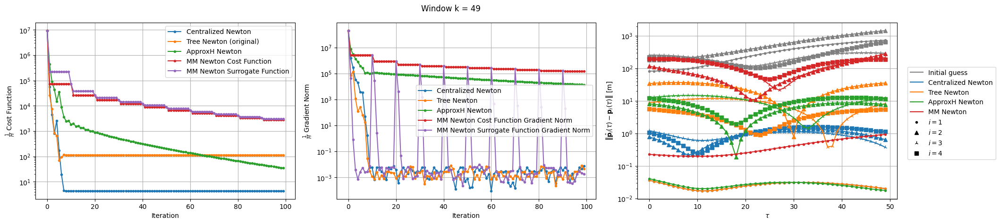


Windows:   0%|          | 1/346 [02:29<14:16:49, 149.01s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 34.20009532639671
Gradient norm: 12727.179582600886
Global relative error: 19.266754869362472
Position relative errors: 0.03743083301364421 m, 7.893185327187735 m, 13.096072855169561 m, 11.721638980831708 m

Before applying the algorithm
Cost function: 113.31599826448985
Gradient norm: 1567.5677069935743
Global relative error: 36.7388935978278
Position relative errors: 0.03347571729347732 m, 35.14346073224029 m, 9.190865137193637 m, 5.4963648376585335 m

Before applying the algorithm
L_norm = 4.34184021599099
Grad_L_norm = 1650.7215132357405

Iteration 1
Cost function: 33.48324997430488 (-2.10%)
Gradient norm: 12160.182832313154 (-4.46%)
Global relative error: 19.530202312727457 (1.37%)
Position relative errors: 0.0185305225701312 m, 7.674757992680016 m, 10.376478590683943 m, 1

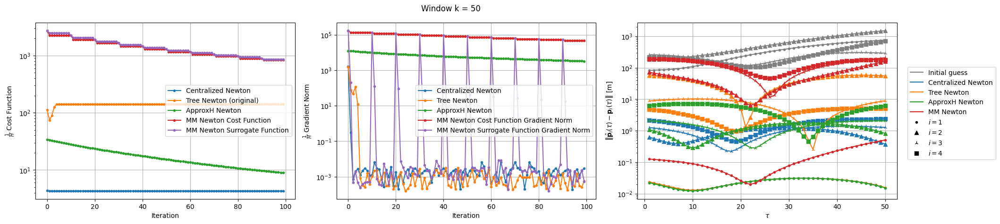


Windows:   1%|          | 2/346 [05:28<15:55:28, 166.65s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8.85267670012264
Gradient norm: 3009.7184724793474
Global relative error: 6.91513425032611
Position relative errors: 0.02050325606874402 m, 0.9773962358378488 m, 2.04042831729276 m, 6.5345227780688955 m

Before applying the algorithm
L_norm = 4.2145939398801024
Grad_L_norm = 509.0843061363497

Before applying the algorithm
Cost function: 129.1877047116782
Gradient norm: 540.7724653085862
Global relative error: 56.36748027963708
Position relative errors: 0.021734373104168953 m, 55.43254291746134 m, 9.104628672756938 m, 4.650900342720359 m

Iteration 1
Cost function: 8.738234527463828 (-1.29%)
Gradient norm: 3084.549603258431 (2.49%)
Global relative error: 6.500717330782691 (-5.99%)
Position relative errors: 0.028479175622740823 m, 1.3054304605851927 m, 5.178749726539746 m, 3.706

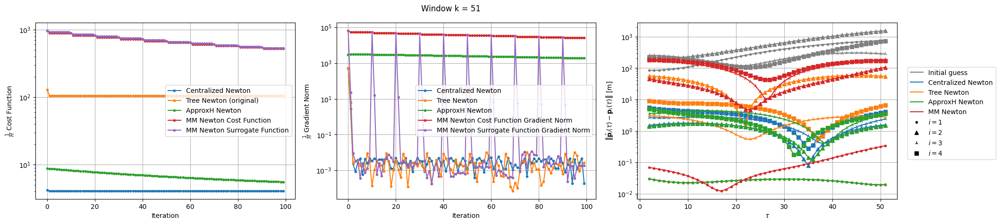


Windows:   1%|          | 3/346 [08:21<16:09:21, 169.57s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 93.85979395715769
Gradient norm: 600.0930745669704
Global relative error: 55.473127785461706
Position relative errors: 0.027606544477164704 m, 54.72659996791292 m, 2.9902515715749853 m, 8.562955636438963 m

Before applying the algorithm
Cost function: 5.684188158058962
Gradient norm: 2930.195918663135
Global relative error: 6.055382062698482
Position relative errors: 0.027893843462575025 m, 1.4527019047829193 m, 3.5915914780431013 m, 4.653702473623967 m

Before applying the algorithm
L_norm = 4.23869157106089
Grad_L_norm = 1402.7089932617482

Iteration 1
Cost function: 125.7172458896801 (33.94%)
Gradient norm: 695.675724903212 (15.93%)
Global relative error: 44.395085464699775 (-19.97%)
Position relative errors: 0.027962880068864316 m, 43.357983160677705 m, 8.495314330360584 m,

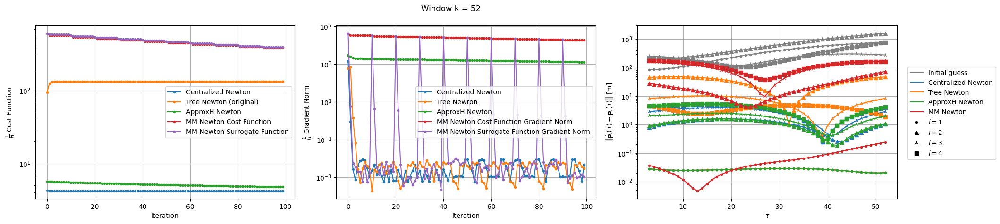


Windows:   1%|          | 4/346 [11:14<16:16:15, 171.27s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 121.94843045199195
Gradient norm: 624.5679493110138
Global relative error: 47.00694201310684
Position relative errors: 0.0270885586511393 m, 46.03032081617223 m, 8.5316284598424 m, 4.251163106676949 m

Before applying the algorithm
Cost function: 4.881072661110274
Gradient norm: 1025.6953943147241
Global relative error: 5.1356746875932835
Position relative errors: 0.027032603118216463 m, 0.9760370254590566 m, 2.0900099920648088 m, 4.588419814628428 m

Before applying the algorithm
L_norm = 4.326436233079734
Grad_L_norm = 1319.2071445844485

Iteration 1
Cost function: 173.6583705228009 (42.40%)
Gradient norm: 74.4547983523334 (-88.08%)
Global relative error: 42.30506186666969 (-10.00%)
Position relative errors: 0.02110683509707282 m, 33.35995200875398 m, 18.97701008217662 m, 17.

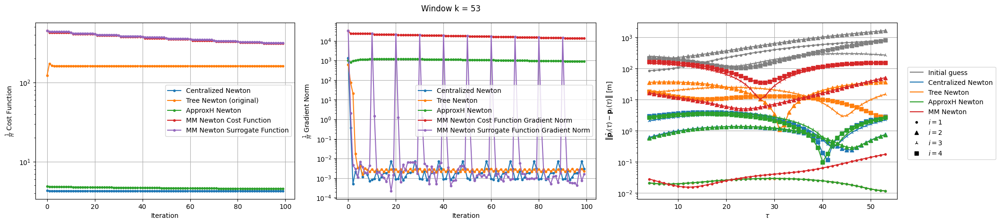


Windows:   1%|▏         | 5/346 [14:08<16:17:57, 172.08s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.585654244712993
Gradient norm: 2203.6792064091323
Global relative error: 3.9762804534310834
Position relative errors: 0.020451035531531842 m, 0.6396732814153847 m, 2.719418755262865 m, 2.8294783520653017 m

Before applying the algorithm
L_norm = 4.332231838889236
Grad_L_norm = 1615.505695426904

Before applying the algorithm
Cost function: 150.02296963996122
Gradient norm: 1159.3895481431387
Global relative error: 44.37746482811887
Position relative errors: 0.020412422408925105 m, 36.6071224588313 m, 18.137896656476887 m, 17.328954065472857 m

Before applying the algorithm
Cost function: 354.08359922122776
Gradient norm: 27631.778602641825
Global relative error: 219.47889148813928
Position relative errors: 0.02558173846499561 m, 15.477064929845485 m, 144.87364365612729 m, 164

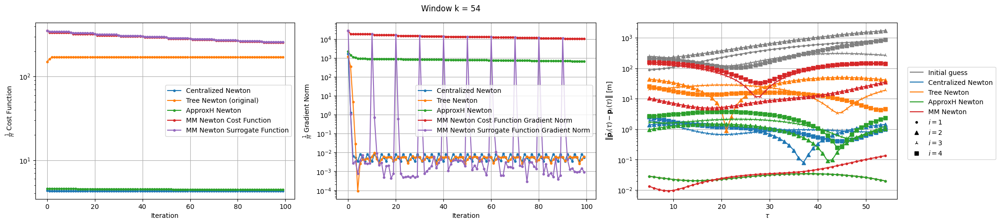


Windows:   2%|▏         | 6/346 [17:05<16:24:33, 173.75s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.274048059892091
Grad_L_norm = 1911.52253570725

Before applying the algorithm
Cost function: 152.62705906449625
Gradient norm: 1850.0119519519574
Global relative error: 52.19599892100157
Position relative errors: 0.02697730423937504 m, 41.761791292697076 m, 20.73265115251867 m, 23.463343974746813 m

Before applying the algorithm
Cost function: 4.397299036285026
Gradient norm: 1948.4665810664417
Global relative error: 3.3443723333390887
Position relative errors: 0.02688599314173476 m, 1.032799351046927 m, 1.6547367970261968 m, 2.7164773480912077 m

Iteration 1
L_norm = 4.248731306325826
Grad_L_norm = 0.2966394873486395

Iteration 1
Cost function: 172.70978417273508 (13.16%)
Gradient norm: 5.054665802434807 (-99.73%)
Global relative error: 56.25524792993761 (7.78%)
Position relative 

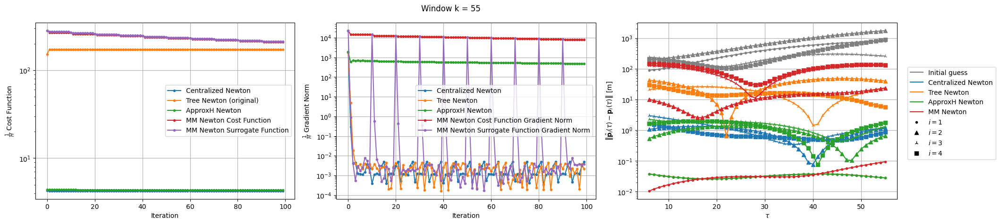


Windows:   2%|▏         | 7/346 [19:57<16:18:35, 173.20s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 155.81177074540912
Gradient norm: 2200.503288756786
Global relative error: 54.5349447283931
Position relative errors: 0.03579010046294548 m, 40.899903271104414 m, 22.11782382347657 m, 28.496596054755518 m

Before applying the algorithm
L_norm = 4.353558025219028
Grad_L_norm = 2284.7454581389716

Before applying the algorithm
Cost function: 4.435641169026556
Gradient norm: 2364.519479237012
Global relative error: 2.828711244116564
Position relative errors: 0.035737202048059455 m, 0.6264589013947551 m, 2.1622113842937654 m, 1.712514581304823 m

Before applying the algorithm
Cost function: 229.05212264329003
Gradient norm: 19246.921882880142
Global relative error: 194.07065074126442
Position relative errors: 0.01223351404612581 m, 9.295026712465855 m, 125.1019353649923 m, 148.0760

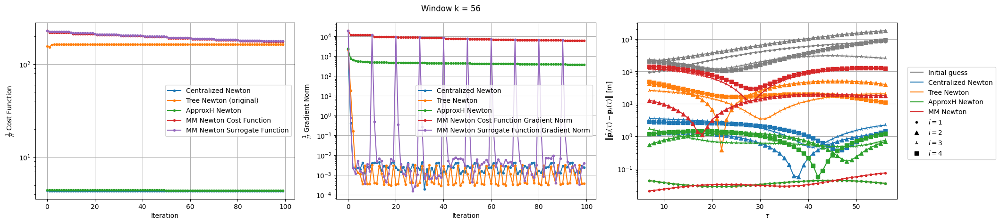


Windows:   2%|▏         | 8/346 [22:49<16:13:43, 172.85s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 141.40361180139672
Gradient norm: 1537.0563574709897
Global relative error: 65.63254611154285
Position relative errors: 0.04126360876763117 m, 40.33145064369956 m, 25.4445021244827 m, 45.0951891945012 m

Before applying the algorithm
L_norm = 4.3681783506134
Grad_L_norm = 1678.0955594787536

Before applying the algorithm
Cost function: 4.408881469321357
Gradient norm: 1625.993895206493
Global relative error: 2.0945896368419654
Position relative errors: 0.04117342817833852 m, 0.618548882267003 m, 1.5758153219297315 m, 1.2328040348973928 m

Iteration 1
Cost function: 212.74719891455416 (50.45%)
Gradient norm: 12.828404074927235 (-99.17%)
Global relative error: 75.54094711441246 (15.10%)
Position relative errors: 0.045714709208426366 m, 38.48257738460552 m, 18.63792578776482 m, 62

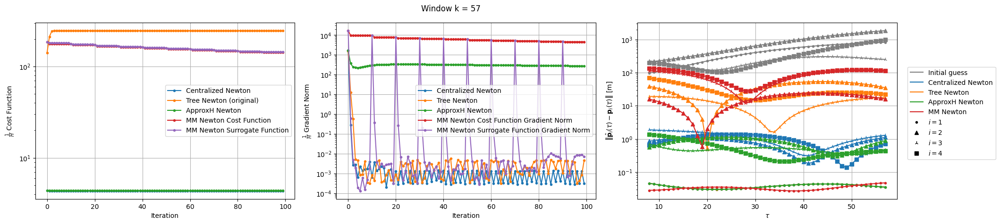


Windows:   3%|▎         | 9/346 [25:43<16:12:15, 173.10s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.284284360560822
Grad_L_norm = 2095.216257206103

Before applying the algorithm
Cost function: 4.312604241006888
Gradient norm: 2135.1915243107765
Global relative error: 1.5985642385095222
Position relative errors: 0.04323155179677986 m, 0.6170668937052708 m, 0.6299838375789906 m, 1.3326226666902665 m

Before applying the algorithm
Cost function: 217.95658403275542
Gradient norm: 2076.824369110704
Global relative error: 77.11837350801963
Position relative errors: 0.043268815414193584 m, 35.932089358002614 m, 19.08172572975484 m, 65.51340878450532 m

Iteration 1
L_norm = 4.260615021677799
Grad_L_norm = 0.3928309421746463

Iteration 1
Cost function: 4.295027072710443 (-0.41%)
Gradient norm: 536.380441230477 (-74.88%)
Global relative error: 3.39849401561542 (112.60%)
Position relative 

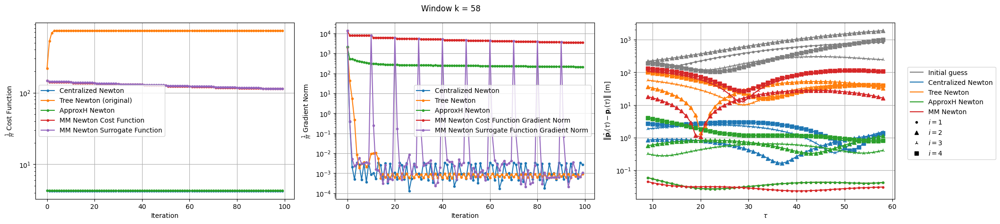


Windows:   3%|▎         | 10/346 [28:39<16:15:15, 174.15s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 666.5245016840709
Gradient norm: 771.1501403345618
Global relative error: 116.08187794983589
Position relative errors: 0.05484235393949222 m, 33.32124589826565 m, 55.43904586051129 m, 96.39082544658712 m

Before applying the algorithm
L_norm = 4.365316397588179
Grad_L_norm = 1131.6021892506453

Before applying the algorithm
Cost function: 4.381171309419042
Gradient norm: 998.885933308085
Global relative error: 3.8884767272202456
Position relative errors: 0.05478297438372478 m, 0.6031428969547595 m, 0.2980372466957292 m, 3.829440817791815 m

Iteration 1
Cost function: 1214.52010987786 (82.22%)
Gradient norm: 69.87112075814782 (-90.94%)
Global relative error: 135.45357209689803 (16.69%)
Position relative errors: 0.06034398533418205 m, 33.0571368850062 m, 89.29917617259629 m, 96.3

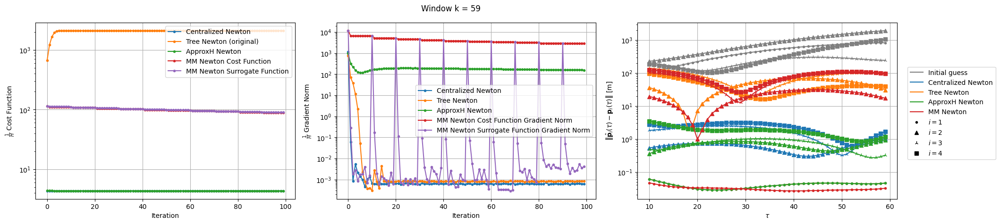


Windows:   3%|▎         | 11/346 [31:37<16:19:17, 175.40s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1943.0161281103988
Gradient norm: 3942.184243574208
Global relative error: 167.642225218358
Position relative errors: 0.05568725305840551 m, 32.66441898796594 m, 136.36133515996875 m, 91.88312265908924 m

Before applying the algorithm
Cost function: 4.4043386476013735
Gradient norm: 3891.0445135273567
Global relative error: 3.334443914272784
Position relative errors: 0.05565565134490414 m, 0.4080298741990842 m, 0.469919898377407 m, 3.275374746295634 m

Before applying the algorithm
L_norm = 4.3962381290008965
Grad_L_norm = 3905.5824103053765

Iteration 1
Cost function: 1964.1444633375224 (1.09%)
Gradient norm: 0.2561815186253584 (-99.99%)
Global relative error: 167.62400263354508 (-0.01%)
Position relative errors: 0.06274979936477226 m, 32.67318060663195 m, 136.33255950868957 m

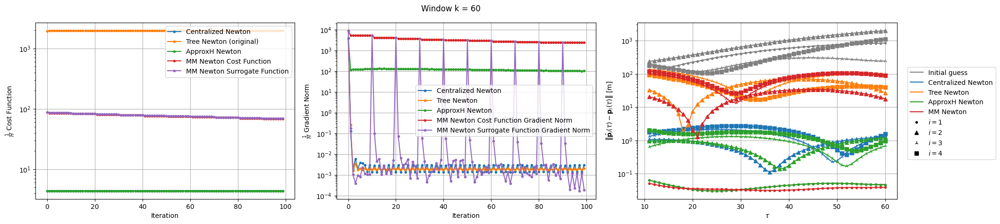


Windows:   3%|▎         | 12/346 [34:34<16:18:31, 175.78s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.268458204903264
Gradient norm: 223.72572505480292
Global relative error: 2.2636967690823973
Position relative errors: 0.05783441374456272 m, 0.9667554138095112 m, 0.6998965928757722 m, 1.9226271915570305 m

Before applying the algorithm
Cost function: 1815.0892702647395
Gradient norm: 210.11951414610462
Global relative error: 160.63708324263163
Position relative errors: 0.05786157040552252 m, 28.53296450116704 m, 131.7056091978459 m, 87.42852037976192 m

Before applying the algorithm
L_norm = 4.264332365842785
Grad_L_norm = 250.5919475606604

Before applying the algorithm
Cost function: 66.99406479265093
Gradient norm: 6918.395042546867
Global relative error: 151.7277426641809
Position relative errors: 0.046943421746194404 m, 18.586917596886856 m, 96.50852227063469 m, 115.593

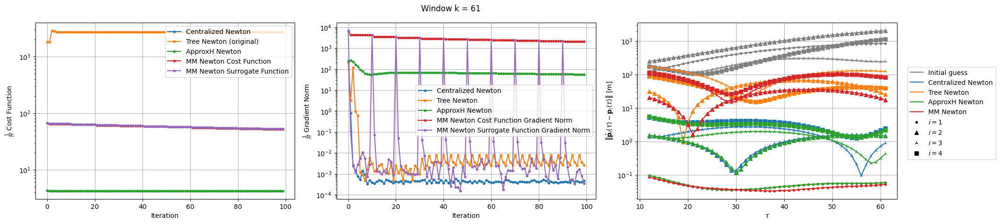


Windows:   4%|▍         | 13/346 [37:25<16:07:31, 174.33s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2528.7781590010954
Gradient norm: 2089.6486099826466
Global relative error: 186.05100369295042
Position relative errors: 0.08914097673270273 m, 26.96630481190359 m, 164.32147071462222 m, 82.98318959623002 m

Before applying the algorithm
Cost function: 4.266732067735541
Gradient norm: 2224.027118883326
Global relative error: 5.547397949693385
Position relative errors: 0.08912340717017558 m, 1.4659748841015454 m, 1.4400063551658069 m, 5.15198119045008 m

Before applying the algorithm
L_norm = 4.261021091263684
Grad_L_norm = 2215.7538570012266

Before applying the algorithm
Cost function: 50.182623139353176
Gradient norm: 5946.103869000916
Global relative error: 145.51241742121655
Position relative errors: 0.07979064674584178 m, 18.61008420983677 m, 93.2382901873465 m, 110.155009

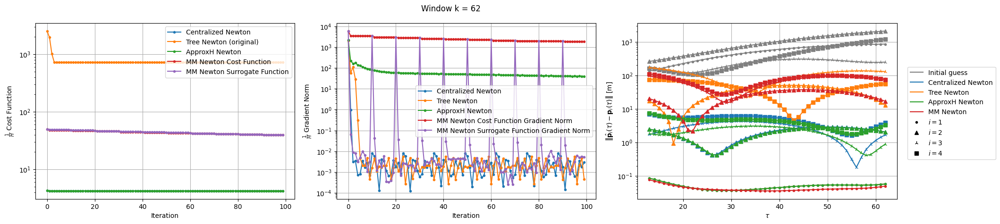


Windows:   4%|▍         | 14/346 [40:21<16:07:28, 174.85s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.234789756150792
Grad_L_norm = 806.286652745921

Before applying the algorithm
Cost function: 4.233209711963607
Gradient norm: 826.2795772901997
Global relative error: 7.458587781869318
Position relative errors: 0.07895441763559814 m, 2.31718314264358 m, 1.7402315948080418 m, 6.87214821165389 m

Before applying the algorithm
Cost function: 720.9201987496868
Gradient norm: 614.9284489015596
Global relative error: 180.9984999948013
Position relative errors: 0.07901066833697813 m, 14.023501862103961 m, 164.4252373020612 m, 74.35126397908188 m

Iteration 1
L_norm = 4.211839394959264
Grad_L_norm = 0.40021542289799605

Iteration 1
Cost function: 798.7818379527463 (10.80%)
Gradient norm: 115.52341224738706 (-81.21%)
Global relative error: 194.11376916527104 (7.25%)
Position relative errors

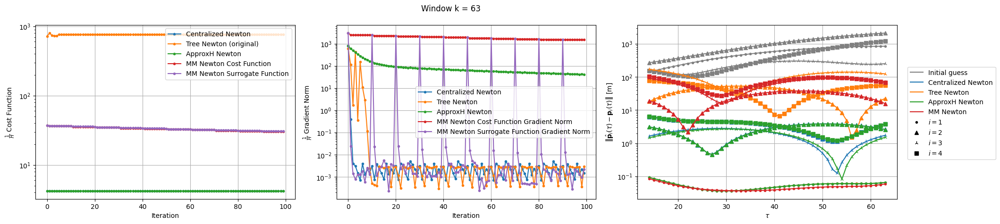


Windows:   4%|▍         | 15/346 [43:17<16:06:38, 175.22s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 757.0499644834028
Gradient norm: 1004.7750755977852
Global relative error: 182.02166195059854
Position relative errors: 0.08457816468523502 m, 21.39720582192317 m, 163.90929245151304 m, 76.20861535968396 m

Before applying the algorithm
Cost function: 4.271835185488223
Gradient norm: 1204.997976770721
Global relative error: 6.9405266569052975
Position relative errors: 0.0845710111083519 m, 2.8917091515374076 m, 1.5829611046255165 m, 6.107038019566802 m

Before applying the algorithm
L_norm = 4.27164366922101
Grad_L_norm = 1217.769543041918

Before applying the algorithm
Cost function: 27.82330460774704
Gradient norm: 2319.8078103705366
Global relative error: 132.8423639037278
Position relative errors: 0.07673745962781782 m, 16.96103744018506 m, 86.74003774389467 m, 99.174365891

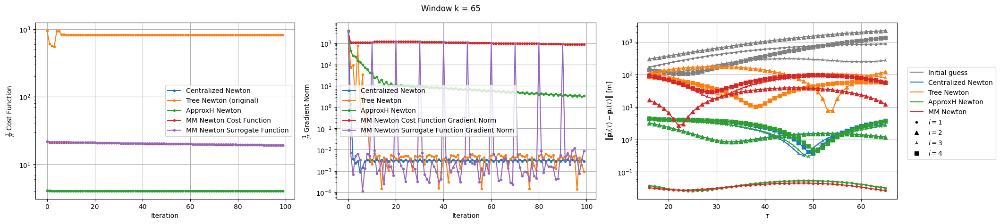


Windows:   5%|▍         | 17/346 [49:04<15:55:31, 174.26s/it]

-------- Tree Newton --------
-------- Centralized Newton ---------------- ApproxH Newton ---------------- MM Newton --------


Majorization-Minimization Iteration 1

Before applying the algorithm
Cost function: 815.9895488534504
Gradient norm: 764.4695024649055
Global relative error: 177.35158337416672
Position relative errors: 0.03552143134281197 m, 116.40276234601785 m, 107.19051475072523 m, 80.08829053824391 m

Before applying the algorithm
Cost function: 4.024575791257251
Gradient norm: 706.8630976493978
Global relative error: 6.622947419760663
Position relative errors: 0.03550939805845441 m, 2.9506455092080883 m, 4.129183995752417 m, 4.255072456029064 m

Before applying the algorithm
L_norm = 4.024148756772261
Grad_L_norm = 708.3915791868191

Iteration 1
Cost function: 612.1216020672266 (-24.98%)
Gradient norm: 82.57257142883614 (-89.20%)
Global relative error: 157.93676364795596 (-10.95%)
Position relative errors: 0.0243533131155603 m, 102.33080942975965 m, 89.75680895818991 m, 

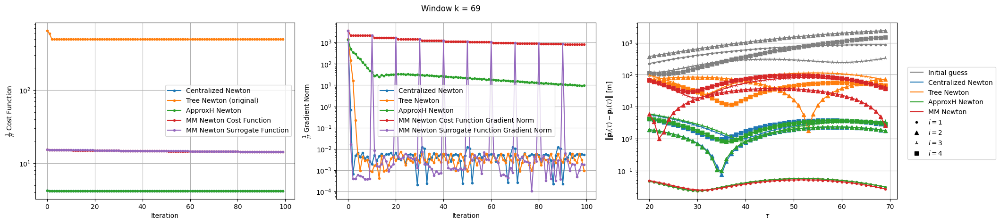


Windows:   6%|▌         | 21/346 [1:00:30<15:35:08, 172.64s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.2484715932834165
Gradient norm: 1272.0064004954186
Global relative error: 7.13294781017006
Position relative errors: 0.04367937022013794 m, 1.833948278774993 m, 5.608075504521176 m, 4.007879152209511 m

Before applying the algorithm
Cost function: 508.9377134582813
Gradient norm: 1256.8082018728467
Global relative error: 129.78676693884293
Position relative errors: 0.04367708181025141 m, 72.10608654941544 m, 87.40684170933895 m, 63.287722245735004 m

Before applying the algorithm
L_norm = 4.248737705559055
Grad_L_norm = 1271.12092355532

Before applying the algorithm
Cost function: 16.273347071222087
Gradient norm: 4503.336085984811
Global relative error: 82.01126568881091
Position relative errors: 0.04628245331331879 m, 3.4004100674255473 m, 55.1661317787464 m, 60.5884116131

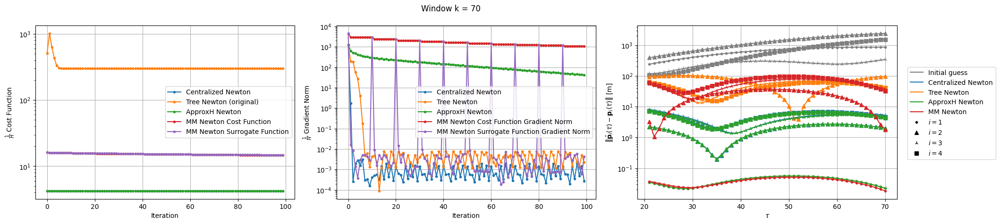


Windows:   6%|▋         | 22/346 [1:03:22<15:30:37, 172.34s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.270863600010673
Gradient norm: 1061.760462580001
Global relative error: 9.903916084564486
Position relative errors: 0.03222268916292525 m, 2.0978792617172606 m, 7.117912740795755 m, 6.559007751913951 m

Before applying the algorithm
Cost function: 307.874857068534
Gradient norm: 971.4024042641404
Global relative error: 122.78251670572426
Position relative errors: 0.03223998405928799 m, 96.16905255022147 m, 48.111298462443706 m, 59.265067678518 m

Before applying the algorithm
L_norm = 4.269716563531256
Grad_L_norm = 1062.5814059406678

Iteration 1
Cost function: 4.260490628684925 (-0.24%)
Gradient norm: 321.0283444329816 (-69.76%)
Global relative error: 9.830933571469266 (-0.74%)
Position relative errors: 0.03334006131070353 m, 2.6895249100657197 m, 7.300614884403581 m, 6.009

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 33
Cost function: 298.40721862004943 (0.00%)
Gradient norm: 6.578555726738844e-05 (-98.04%)
Global relative error: 96.66228571163387 (0.00%)
Position relative errors: 0.03527758088517751 m, 57.926574026901385 m, 54.29148709473102 m, 55.14096814670768 m

Iteration 33
L_norm = 4.297375957710723
Grad_L_norm = 0.005029042606805549

Iteration 33
Cost function: 4.298779550996193 (-0.00%)
Gradient norm: 37.953705404182195 (-15.01%)
Global relative error: 9.021493215629377 (-0.39%)
Position relative errors: 0.0353206041265136 m, 2.975059250700755 m, 6.475982288749974 m, 5.531425524451251 m

Iteration 34
Cost function: 298.40721777915417 (-0.00%)
Gradient norm: 0.0009678039633215285 (1371.15%)
Global relative error: 96.66228566593668 (-0.00%)
Position relative errors: 0.03527757874963163 m, 57.926574026867556 m, 54.29148701250409 m, 55.14096814759757 m

Iteration 34
L_norm = 4.297375959393609
Grad_L_norm = 0.006897287942866737

Iteration 34
Cost function: 4.298728867592443 (-0.00%)
Gr

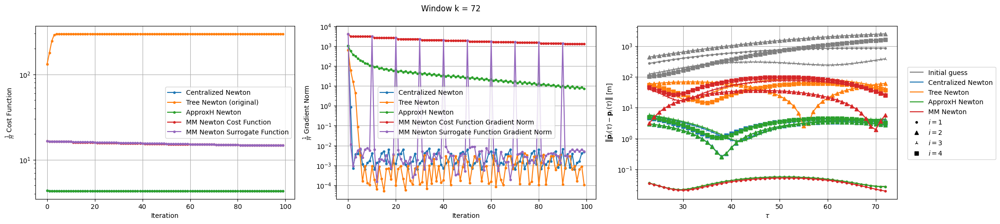


Windows:   7%|▋         | 24/346 [1:09:08<15:25:22, 172.43s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.3206084676036856
Gradient norm: 326.5948581917838
Global relative error: 7.701123060550445
Position relative errors: 0.031838374749336124 m, 2.8391270341977775 m, 5.4872918680128 m, 4.597302393566503 m

Before applying the algorithm
L_norm = 4.321806973120363
Grad_L_norm = 324.3334496895501

Before applying the algorithm
Cost function: 312.9927382163644
Gradient norm: 361.1824395533899
Global relative error: 92.65319716145468
Position relative errors: 0.03183197468344573 m, 60.247031000382336 m, 48.66098111524318 m, 50.86257881756022 m

Iteration 1
Cost function: 4.314458951582585 (-0.14%)
Gradient norm: 190.8007684037491 (-41.58%)
Global relative error: 7.899714567693773 (2.58%)
Position relative errors: 0.036750424690619496 m, 2.632528278235283 m, 5.437361135914268 m, 5.090

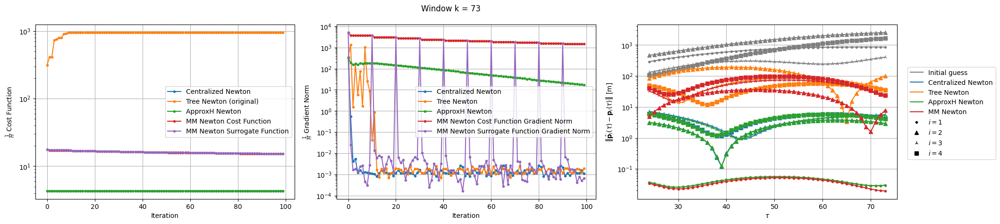


Windows:   7%|▋         | 25/346 [1:11:55<15:14:00, 170.84s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.410075674756055
Gradient norm: 1095.7275012545158
Global relative error: 9.009228457592917
Position relative errors: 0.03389816589209593 m, 2.9974477079586146 m, 6.51194012291028 m, 5.456636230802069 m

Before applying the algorithm
L_norm = 4.410863518041995
Grad_L_norm = 1085.227812844756

Before applying the algorithm
Cost function: 933.8188716543475
Gradient norm: 825.8286346216067
Global relative error: 111.11724882247184
Position relative errors: 0.03389587903609638 m, 94.85179657690671 m, 34.1940861707843 m, 46.70005694064377 m

Before applying the algorithm
Cost function: 17.347213262827
Gradient norm: 4829.272059194702
Global relative error: 45.082633557327156
Position relative errors: 0.03098989403203065 m, 6.984942501050845 m, 27.994006100097394 m, 34.6405307190752

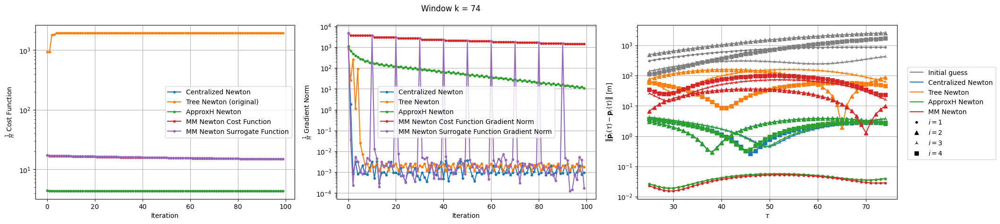


Windows:   8%|▊         | 26/346 [1:14:45<15:09:16, 170.49s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1923.7625927087022
Gradient norm: 3169.746263228369
Global relative error: 115.3408504060169
Position relative errors: 0.023465716693990137 m, 84.32876036244444 m, 55.114993267692604 m, 56.16451140355856 m

Before applying the algorithm
L_norm = 4.480230989954398
Grad_L_norm = 3320.8632650466548

Before applying the algorithm
Cost function: 4.481493737833514
Gradient norm: 3320.842014292178
Global relative error: 6.0605810940905585
Position relative errors: 0.023475945302325055 m, 2.7738783323322376 m, 4.052072176627538 m, 3.55195176862094 m

Iteration 1
Cost function: 1886.778350231438 (-1.92%)
Gradient norm: 11.243322917347886 (-99.65%)
Global relative error: 115.41137024700485 (0.06%)
Position relative errors: 0.023550710664503514 m, 84.31207085030374 m, 55.11330922183431 m,

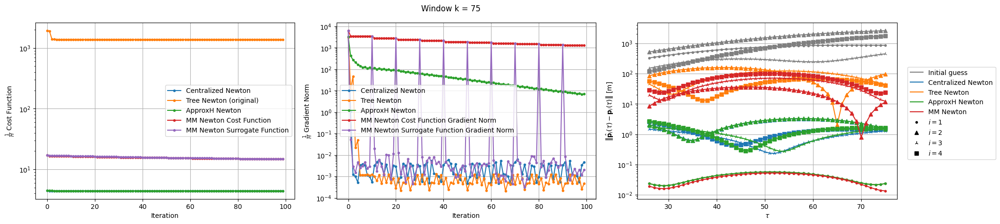


Windows:   8%|▊         | 27/346 [1:17:39<15:12:32, 171.64s/it]

-------- MM Newton ---------------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------


Majorization-Minimization Iteration 1


Before applying the algorithm
L_norm = 4.424001017378685
Grad_L_norm = 1268.6041955196977

Before applying the algorithm
Cost function: 1362.9545903779385
Gradient norm: 1212.3732862165657
Global relative error: 112.78062093670968
Position relative errors: 0.021597916545131587 m, 92.92375693879913 m, 37.333501969988475 m, 51.873000663236084 m

Before applying the algorithm
Cost function: 4.425200088454294
Gradient norm: 1261.7042052744355
Global relative error: 3.557552860264013
Position relative errors: 0.021587044116372845 m, 1.8414322627091357 m, 1.6834489446877474 m, 2.5359057203255326 m

Iteration 1
Cost function: 957.0679781310652 (-29.78%)
Gradient norm: 47.25134232111019 (-96.10%)
Global relative error: 108.15074164514266 (-4.11%)
Position relative errors: 0.020998128174767865 m, 90.66276178659207 m, 27.8368367918

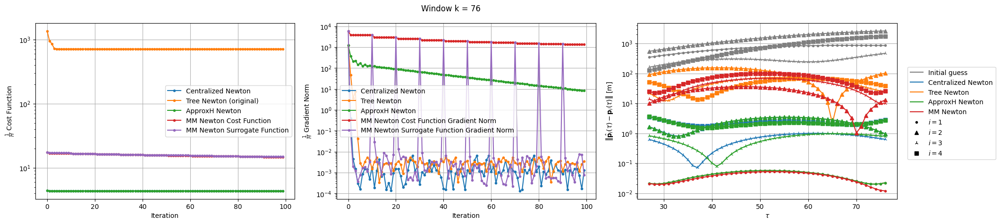


Windows:   8%|▊         | 28/346 [1:20:26<15:01:38, 170.12s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.455750830897795
Gradient norm: 2872.7824325609286
Global relative error: 3.6550828677405423
Position relative errors: 0.020369840623621533 m, 1.4120452604790432 m, 0.770975024330731 m, 3.281904310434095 m

Before applying the algorithm
L_norm = 4.456721866982118
Grad_L_norm = 2878.1860973497483

Before applying the algorithm
Cost function: 710.4936092401906
Gradient norm: 2923.8107122457363
Global relative error: 110.87864379712187
Position relative errors: 0.020386402272679037 m, 98.67571388651092 m, 17.719996981719415 m, 47.36188745207322 m

Iteration 1
Cost function: 4.440626926876613 (-0.34%)
Gradient norm: 87.61333504851544 (-96.95%)
Global relative error: 3.79926939618415 (3.94%)
Position relative errors: 0.015686593324097112 m, 1.768947494089622 m, 1.1732713116739024 m

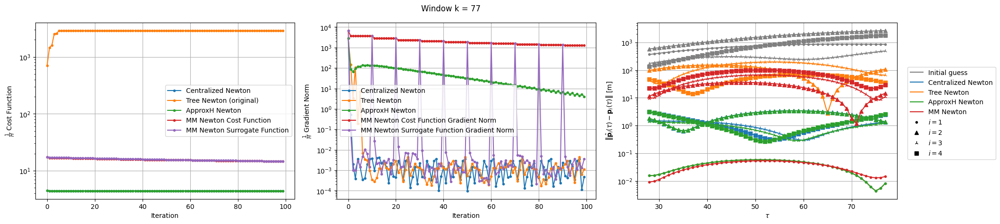


Windows:   8%|▊         | 29/346 [1:23:15<14:57:36, 169.89s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.485243843415318
Gradient norm: 1077.3326840441991
Global relative error: 3.5261381938610503
Position relative errors: 0.01578438725319407 m, 1.5823246589131907 m, 1.3473567299865472 m, 2.8485517305574084 m

Before applying the algorithm
L_norm = 4.485742533812657
Grad_L_norm = 1074.1914620766186

Before applying the algorithm
Cost function: 2919.6797527746253
Gradient norm: 938.8370525528278
Global relative error: 117.94126976468014
Position relative errors: 0.01577359810985052 m, 104.46694631340061 m, 34.28943626642446 m, 42.67275637021151 m

Iteration 1
Cost function: 4.473991661031749 (-0.25%)
Gradient norm: 667.1055991457956 (-38.08%)
Global relative error: 3.2700967852523184 (-7.26%)
Position relative errors: 0.02091770473514411 m, 1.0681615201722943 m, 1.347783091118445

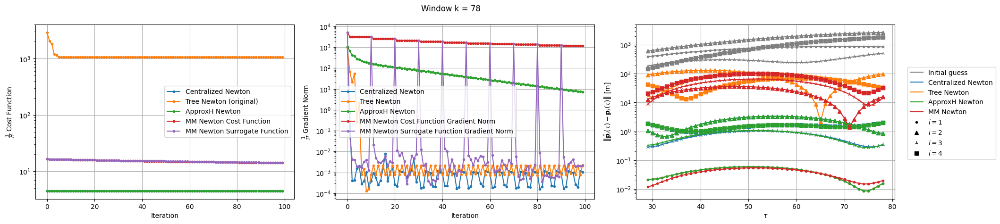


Windows:   9%|▊         | 30/346 [1:26:07<14:58:16, 170.56s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1068.4223356800612
Gradient norm: 2887.0107681017994
Global relative error: 104.45814216980739
Position relative errors: 0.021767336650372806 m, 96.15323699191015 m, 15.398346513888635 m, 37.80105228279732 m

Before applying the algorithm
L_norm = 4.514316809580739
Grad_L_norm = 3066.2634183953414

Before applying the algorithm
Cost function: 4.514281003272001
Gradient norm: 3067.910280562029
Global relative error: 1.9382179865576898
Position relative errors: 0.0217641561914552 m, 0.8878635052096568 m, 0.3446515248794264 m, 1.6879288084282837 m

Iteration 1
Cost function: 198.70072310207104 (-81.40%)
Gradient norm: 495.65857950856076 (-82.83%)
Global relative error: 105.09075016555032 (0.61%)
Position relative errors: 0.03674812640437684 m, 97.97102104566616 m, 2.11864570183648

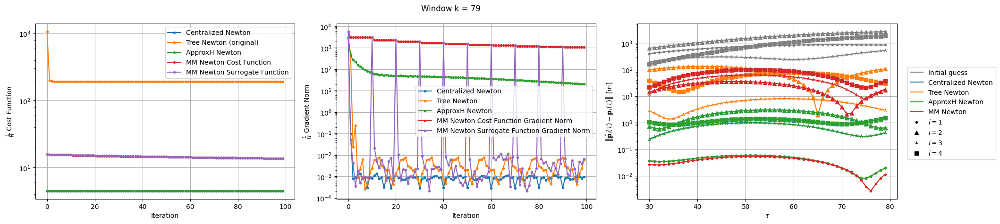


Windows:   9%|▉         | 31/346 [1:28:53<14:48:18, 169.20s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.514576398399759
Gradient norm: 727.3648195757013
Global relative error: 1.1947728792025116
Position relative errors: 0.03533710660230658 m, 0.621393083852044 m, 0.28015914981642376 m, 0.9806107056926243 m

Before applying the algorithm
L_norm = 4.514362941710944
Grad_L_norm = 730.6901302943484

Before applying the algorithm
Cost function: 196.53891114537956
Gradient norm: 631.7890191888706
Global relative error: 108.83852875704096
Position relative errors: 0.035331824662435826 m, 103.69571603147585 m, 2.3102195028588524 m, 32.97982890423244 m

Iteration 1
Cost function: 675.8022213419993 (243.85%)
Gradient norm: 252.26671351519926 (-60.07%)
Global relative error: 114.62714721410774 (5.32%)
Position relative errors: 0.023002574300022016 m, 109.25382946848886 m, 12.712260011695

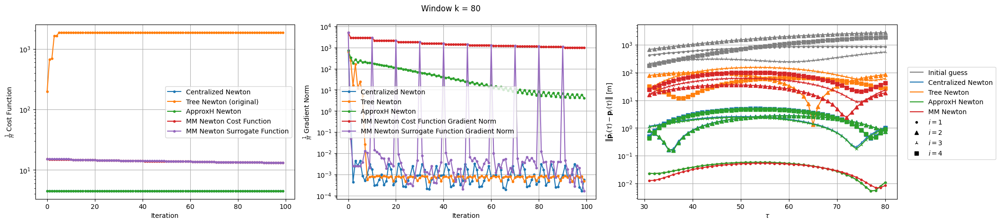


Windows:   9%|▉         | 32/346 [1:31:42<14:45:01, 169.11s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.544154295612666
Grad_L_norm = 2062.947048675932

Before applying the algorithm
Cost function: 1885.9700385465535
Gradient norm: 1880.0908472948606
Global relative error: 92.41602399551631
Position relative errors: 0.022698215179303805 m, 81.8012345992796 m, 32.59336219567701 m, 28.05198894696389 m

Before applying the algorithm
Cost function: 4.544951069138426
Gradient norm: 2060.4336146630126
Global relative error: 1.515332875090618
Position relative errors: 0.022705997235186345 m, 0.6477728239678927 m, 1.1692171838151393 m, 0.7134407062942317 m

Iteration 1
L_norm = 4.523022781025587
Grad_L_norm = 0.3975988857598321

Iteration 1
Cost function: 1187.853083394485 (-37.02%)
Gradient norm: 54.28984223073681 (-97.11%)
Global relative error: 94.77061345034434 (2.55%)
Position relative 

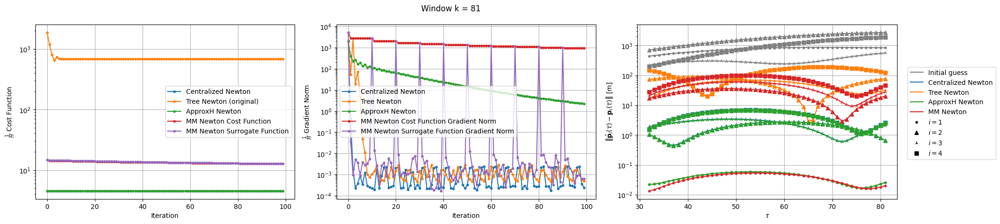


Windows:  10%|▉         | 33/346 [1:34:31<14:42:03, 169.08s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 565.2027019170446
Gradient norm: 1643.8610167955167
Global relative error: 158.07670066337624
Position relative errors: 0.022697796138199982 m, 76.27909686749112 m, 20.389539860295468 m, 136.94511643637657 m

Before applying the algorithm
L_norm = 4.522003167384294
Grad_L_norm = 1920.9731387241793

Before applying the algorithm
Cost function: 4.522275818991128
Gradient norm: 1924.2559848853375
Global relative error: 2.8940076739232903
Position relative errors: 0.02269897442333613 m, 0.868626116341228 m, 2.007137441594539 m, 1.8951465171282043 m

Iteration 1
Cost function: 674.0457290001161 (19.26%)
Gradient norm: 39.78244547121389 (-97.58%)
Global relative error: 157.92997601440817 (-0.09%)
Position relative errors: 0.017406154613178227 m, 73.89755201114849 m, 26.84712231948248

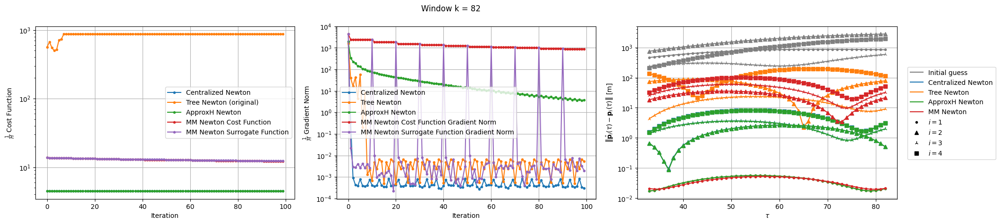


Windows:  10%|▉         | 34/346 [1:37:13<14:27:31, 166.83s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 819.1489386842446
Gradient norm: 988.5539289284048
Global relative error: 144.40800801827137
Position relative errors: 0.018284363649129436 m, 76.84367394701206 m, 5.499985318855878 m, 122.14101660484246 m

Before applying the algorithm
Cost function: 4.51446884380881
Gradient norm: 1338.7359513486551
Global relative error: 2.603864186568719Before applying the algorithm
L_norm = 4.514635962918574
Grad_L_norm = 1338.483711679637


Position relative errors: 0.018285164755075373 m, 0.5013756878811821 m, 1.6225915369410737 m, 1.9737004533609328 m

Iteration 1
Cost function: 203.6670278717229 (-75.14%)
Gradient norm: 431.9741018347134 (-56.30%)
Global relative error: 106.55535523640229 (-26.21%)
Position relative errors: 0.04399319794623219 m, 76.35895415029472 m, 6.69871263377025 m

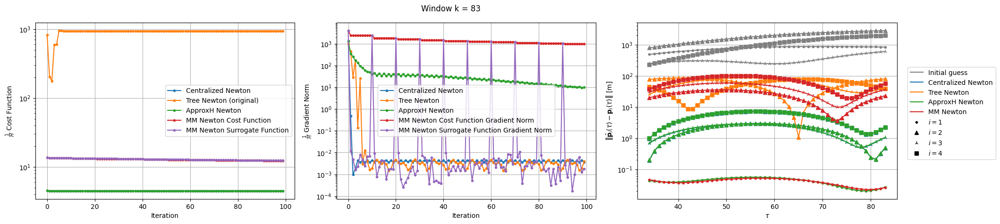


Windows:  10%|█         | 35/346 [1:39:53<14:13:28, 164.66s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.521545033960179
Gradient norm: 2149.7533505910415
Global relative error: 1.681762165271612
Position relative errors: 0.04181546442649295 m, 0.38747721377948635 m, 0.878977816702171 m, 1.3797657306309574 m

Before applying the algorithm
L_norm = 4.521427641537813
Grad_L_norm = 2153.78256814934

Before applying the algorithm
Cost function: 951.2697997976597
Gradient norm: 1702.530105366764
Global relative error: 93.2048422744478
Position relative errors: 0.041818397019275054 m, 78.71912966771016 m, 30.075849915630663 m, 39.822939602986416 m

Iteration 1
Cost function: 4.501432336401951 (-0.44%)
Gradient norm: 521.2554021774366 (-75.75%)
Global relative error: 1.9566465266646549 (16.35%)
Position relative errors: 0.039237818341236366 m, 0.3068723598986079 m, 1.1189952001812453 m

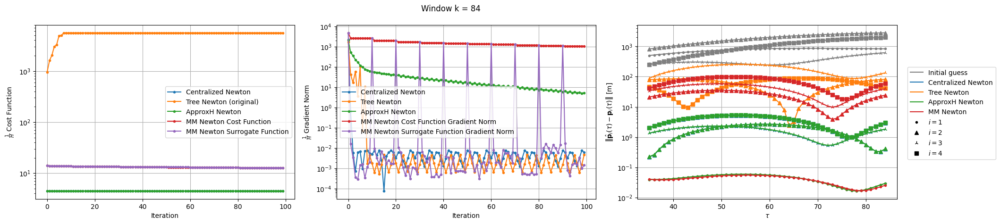


Windows:  10%|█         | 36/346 [1:42:37<14:10:57, 164.70s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.51076811651399
Grad_L_norm = 2340.6900725296036

Before applying the algorithm
Cost function: 5616.747464463854
Gradient norm: 2686.3979935101856
Global relative error: 137.27917822075466
Position relative errors: 0.03925417151538961 m, 80.48930052015416 m, 103.26065936003744 m, 41.28199356466156 m

Before applying the algorithm
Cost function: 4.511085206701631
Gradient norm: 2341.2984990068753
Global relative error: 2.7787193307597895
Position relative errors: 0.039251064188051146 m, 0.2643271414741526 m, 1.4817094355821325 m, 2.335458886060551 m

Iteration 1
L_norm = 4.488980467668536
Grad_L_norm = 0.6781965769106773

Iteration 1
Cost function: 5021.537183162464 (-10.60%)
Gradient norm: 194.57410712654342 (-92.76%)
Global relative error: 131.29832262612584 (-4.36%)
Position relat

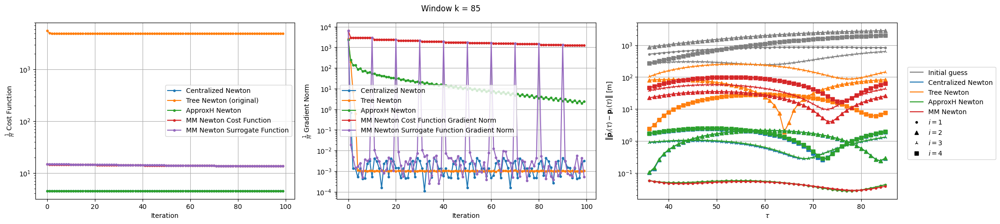


Windows:  11%|█         | 37/346 [1:45:10<13:49:33, 161.08s/it]

-------- Centralized Newton --------
-------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4893.810756792296
Gradient norm: 2385.4842310725835
Global relative error: 143.5607709834422
Position relative errors: 0.0545099443028546 m, 81.96012829207038 m, 117.82335892321018 m, 3.133911181058434 m

Before applying the algorithm
L_norm = 4.465874192494822
Grad_L_norm = 2188.2790226089824

Before applying the algorithm
Cost function: 4.465758801026785
Gradient norm: 2189.5938120121205
Global relative error: 2.0637847331610253
Position relative errors: 0.054505706034455606 m, 0.14562008778303506 m, 0.9420029486654646 m, 1.8296588828624472 m

Iteration 1
Cost function: 5406.014182000439 (10.47%)
Gradient norm: 13.364437303411394 (-99.44%)
Global relative error: 150.62108732791137 (4.92%)
Position relative errors: 0.06679284384313258 m, 81.9626983033777 m, 126.1524718658469 m

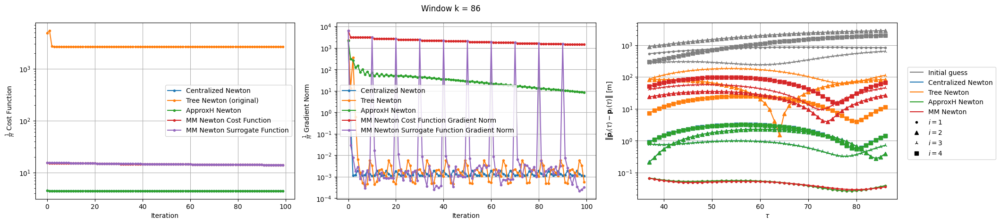


Windows:  11%|█         | 38/346 [1:48:34<14:52:23, 173.84s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.50883131431414
Gradient norm: 4485.001388805016
Global relative error: 1.358199726541647
Position relative errors: 0.06313729629138397 m, 0.29137197582757324 m, 0.7593358569611619 m, 1.0859155799526188 m

Before applying the algorithm
Cost function: 2624.3305773986353
Gradient norm: 4609.926221984229
Global relative error: 127.45925717281858
Position relative errors: 0.06313706490030833 m, 82.8483497540982 m, 96.45365993701128 m, 8.869595897606683 m

Before applying the algorithm
L_norm = 4.508739589125316
Grad_L_norm = 4483.944895227313

Before applying the algorithm
Cost function: 16.35419249273259
Gradient norm: 8834.957558318967
Global relative error: 75.49862519725409
Position relative errors: 0.06189482209022764 m, 25.212067512861513 m, 43.45376044337575 m, 56.357343755

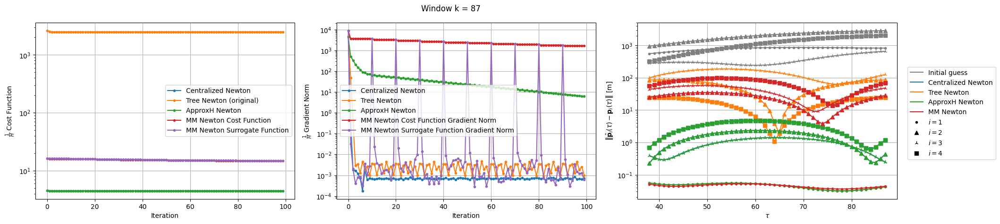


Windows:  11%|█▏        | 39/346 [1:51:54<15:30:01, 181.76s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.550760263484285
Grad_L_norm = 1640.0445538203996

Before applying the algorithm
Cost function: 2468.5497154060718
Gradient norm: 1699.0130000989334
Global relative error: 141.86563411487538
Position relative errors: 0.05312521954658566 m, 86.10657462965128 m, 110.00404886137437 m, 24.710202918457533 m

Before applying the algorithm
Cost function: 4.550784269816045
Gradient norm: 1640.0539042852868
Global relative error: 1.0481706892486198
Position relative errors: 0.05312506828463707 m, 0.3436880951985743 m, 0.34006387687975653 m, 0.928460904033547 m

Iteration 1
L_norm = 4.531054626067584
Grad_L_norm = 0.09424723785406504

Iteration 1
Cost function: 2222.6411058601284 (-9.96%)
Gradient norm: 130.87671272761628 (-92.30%)
Global relative error: 149.9528871880799 (5.70%)
Position rel

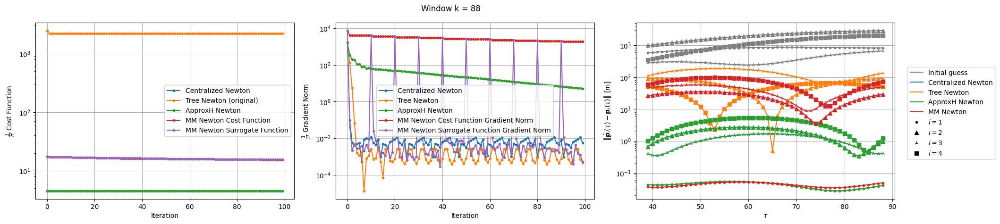


Windows:  12%|█▏        | 40/346 [1:54:36<14:57:42, 176.02s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.512361282982715
Grad_L_norm = 1366.915339877407

Before applying the algorithm
Cost function: 2143.6756922336303
Gradient norm: 1774.6421289249315
Global relative error: 158.7195700961185
Position relative errors: 0.042079118819287414 m, 89.80573986994614 m, 120.83233040142763 m, 50.26279622320856 m

Before applying the algorithm
Cost function: 4.51234903323914
Gradient norm: 1366.9627938641083
Global relative error: 1.5337351869502047
Position relative errors: 0.04207875108332394 m, 0.8365491780352234 m, 0.3579954674702599 m, 1.2339176531984142 m

Iteration 1
L_norm = 4.4919573395142915
Grad_L_norm = 0.06204441587043121

Iteration 1
Cost function: 2022.7510625261734 (-5.64%)
Gradient norm: 53.24993853117234 (-97.00%)
Global relative error: 153.13708095942945 (-3.52%)
Position rela

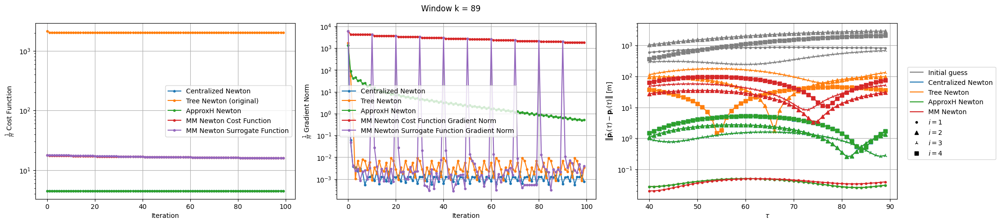


Windows:  12%|█▏        | 41/346 [1:57:41<15:07:04, 178.44s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------

-------- MM Newton --------


Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.4668885604299415
Grad_L_norm = 1058.079769413023

Before applying the algorithm
Cost function: 1990.8311930066563
Gradient norm: 823.4490666790219
Global relative error: 159.916152785605
Position relative errors: 0.027578180530239395 m, 97.29598794629075 m, 121.75152867070575 m, 35.821918608820745 m

Before applying the algorithm
Cost function: 4.466861806861639
Gradient norm: 1058.1784471260983
Global relative error: 2.2926973420078416
Position relative errors: 0.027577734177921517 m, 1.2404169821409954 m, 0.8630528641921745 m, 1.7239967038589827 m

Iteration 1
Cost function: 2137.698619173009 (7.38%)
Gradient norm: 60.46988483482178 (-92.66%)
Global relative error: 155.42669299986997 (-2.81%)
Position relative errors: 0.02124851617801739 m, 94.14643822647308 m, 121.75560790591396

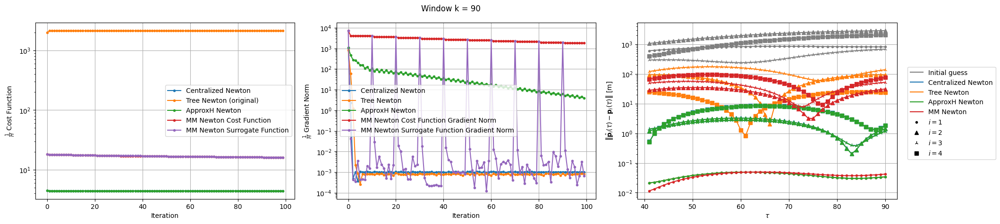


Windows:  12%|█▏        | 42/346 [2:00:43<15:09:50, 179.57s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2103.760433475184
Gradient norm: 469.240367973421
Global relative error: 162.24948194336775
Position relative errors: 0.022311295211495892 m, 94.30966314626558 m, 129.828270614655 m, 23.982987606922652 m

Before applying the algorithm
L_norm = 4.456433419664153
Grad_L_norm = 403.81983543224715

Before applying the algorithm
Cost function: 4.456274403245093
Gradient norm: 406.2661934565218
Global relative error: 2.2284179341836325
Position relative errors: 0.022313291219975103 m, 1.367866449914129 m, 1.4649937608897237 m, 0.9736421282629325 m

Iteration 1
Cost function: 2121.3714255268246 (0.84%)
Gradient norm: 14.683146391880431 (-96.87%)
Global relative error: 158.86359203295342 (-2.09%)
Position relative errors: 0.030254169513060217 m, 90.15416331658389 m, 129.83911515214143 

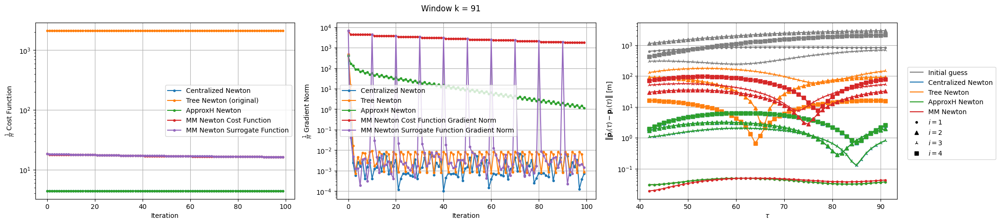


Windows:  12%|█▏        | 43/346 [2:03:34<14:54:50, 177.20s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.464237584189727
Gradient norm: 2216.626301366315
Global relative error: 3.1699291928103954
Position relative errors: 0.030322954193463446 m, 1.8728741619233262 m, 1.104736723590383 m, 2.3063769150729843 m

Before applying the algorithm
L_norm = 4.46406672681092
Grad_L_norm = 2216.866982135362

Before applying the algorithm
Cost function: 2104.893935330088
Gradient norm: 2500.619924589966
Global relative error: 164.91216692963707
Position relative errors: 0.030323306912076735 m, 89.85812891332725 m, 137.36188590775535 m, 15.913376977452504 m

Iteration 1
Cost function: 4.445238355480952 (-0.43%)
Gradient norm: 358.6903715612925 (-83.82%)
Global relative error: 4.593873978062304 (44.92%)
Position relative errors: 0.03216474210261362 m, 2.1350252887380967 m, 1.177037339275607 m,

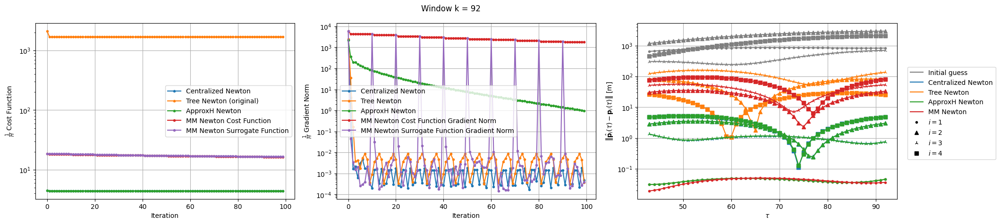


Windows:  13%|█▎        | 44/346 [2:06:29<14:48:25, 176.51s/it]

-------- Centralized Newton ---------------- MM Newton ---------------- Tree Newton ---------------- ApproxH Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1671.6746311696534
Gradient norm: 2197.351323909664
Global relative error: 154.68484411979986
Position relative errors: 0.0313293221537538 m, 80.69568799133022 m, 129.53788300426044 m, 25.209752348847495 m

Before applying the algorithm
Cost function: 4.49593879095219
Gradient norm: 2575.7507119320057
Global relative error: 5.858932971417054
Position relative errors: 0.0313261833271261 m, 2.9713747866190885 m, 1.2353748379000473 m, 4.896006251905056 m

Before applying the algorithm
L_norm = 4.49590147636627
Grad_L_norm = 2574.8819286361054

Iteration 1
Cost function: 1278.375278264496 (-23.53%)
Gradient norm: 64.82499399232854 (-97.05%)
Global relative error: 142.0790239033631 (-8.15%)
Position relative errors: 0.027890886218755687 m, 80.69637215748743 m, 109.59485245390495 m, 

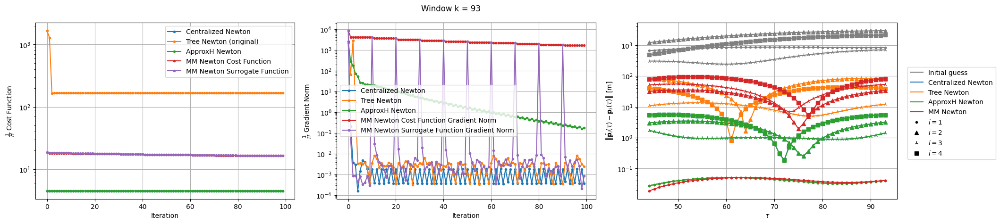


Windows:  13%|█▎        | 45/346 [2:09:26<14:45:54, 176.59s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 166.71676099340073
Gradient norm: 602.8031271774241
Global relative error: 89.06948166912086
Position relative errors: 0.030052426963674914 m, 79.26821849542183 m, 11.354441102431387 m, 38.99995242343187 m

Before applying the algorithm
L_norm = 4.365401316843968
Grad_L_norm = 944.628320834146

Before applying the algorithm
Cost function: 4.365440187091134
Gradient norm: 944.9241165686881
Global relative error: 6.517898568140623
Position relative errors: 0.03004880531830579 m, 3.1140585196293418 m, 1.5797421543260342 m, 5.503556991862474 m

Iteration 1
Cost function: 166.34964908845774 (-0.22%)
Gradient norm: 8.733528412568361 (-98.55%)
Global relative error: 85.82989139658508 (-3.64%)
Position relative errors: 0.041082544816214546 m, 79.27269249978063 m, 11.357674521108972 m, 

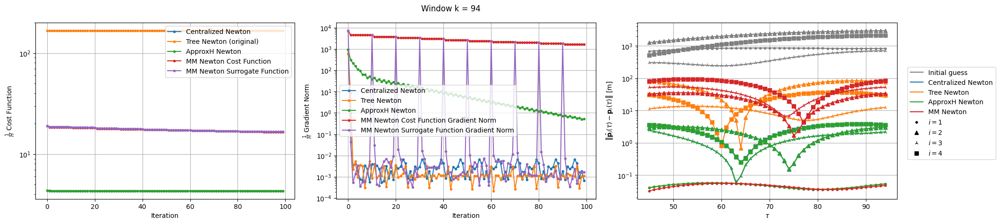


Windows:  13%|█▎        | 46/346 [2:12:25<14:46:46, 177.35s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.231575104149175
Gradient norm: 2167.936478600269
Global relative error: 5.1750192044021235
Position relative errors: 0.043333745168560624 m, 3.0250231617823937 m, 2.258420692400929 m, 3.539449659210116 m

Before applying the algorithm
L_norm = 4.231618320361935
Grad_L_norm = 2168.6475100551197

Before applying the algorithm
Cost function: 166.1662687487957
Gradient norm: 2565.7369122492387
Global relative error: 83.54163963086842
Position relative errors: 0.04333694224824222 m, 77.3513870906933 m, 11.820449433789108 m, 29.26160576046775 m

Iteration 1
Cost function: 4.198245732156504 (-0.79%)
Gradient norm: 208.2810163382144 (-90.39%)
Global relative error: 6.01000274537108 (16.13%)
Position relative errors: 0.06268341817420704 m, 2.984201991298676 m, 2.229554466548482 m, 4.7

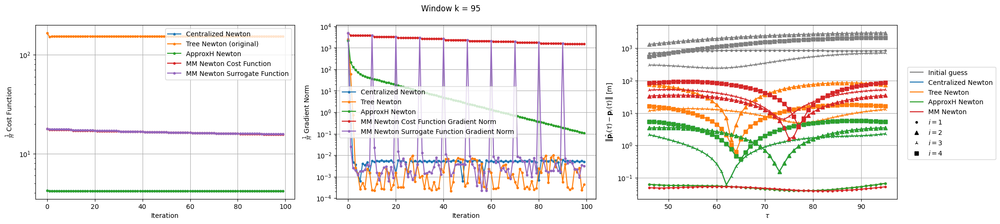


Windows:  14%|█▎        | 47/346 [2:15:13<14:29:16, 174.44s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.201073679271602
Gradient norm: 2104.1960134609335
Global relative error: 6.650340920020286
Position relative errors: 0.060928223460818144 m, 3.4726425721769134 m, 1.9630254818329345 m, 5.320769877596299 m

Before applying the algorithm
Cost function: 154.12963251142733
Gradient norm: 1876.4686627609224
Global relative error: 77.49406666185871
Position relative errors: 0.06092883021962514 m, 74.83176982527614 m, 12.230674625513915 m, 15.998166250870963 m

Before applying the algorithm
L_norm = 4.201073437914893
Grad_L_norm = 2104.1937132533767

Iteration 1
Cost function: 143.38711784426766 (-6.97%)
Gradient norm: 95.25949740790634 (-94.92%)
Global relative error: 76.4277245519951 (-1.38%)
Position relative errors: 0.05334956954147042 m, 74.82898219832677 m, 12.236645336838526 

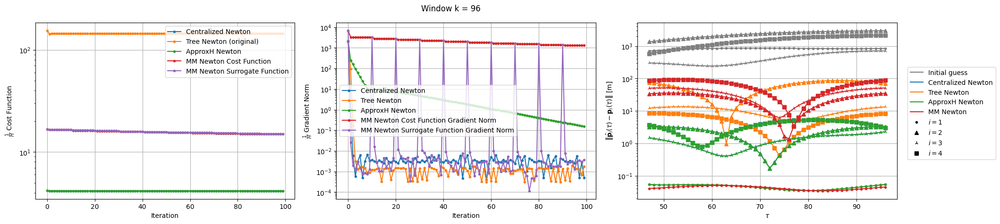


Windows:  14%|█▍        | 48/346 [2:18:02<14:18:58, 172.95s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 144.6234659013258
Gradient norm: 3281.413140223544
Global relative error: 73.39471668399229
Position relative errors: 0.052760655277092464 m, 71.81273182435919 m, 12.575300874513664 m, 8.460032453983455 m

Before applying the algorithm
L_norm = 4.202141144877036
Grad_L_norm = 3241.7945784596204

Before applying the algorithm
Cost function: 4.202132291179501
Gradient norm: 3241.6165668090866
Global relative error: 4.938708749990563
Position relative errors: 0.052757745918918644 m, 3.2522361028794573 m, 1.4076524979789706 m, 3.439405316406802 m

Iteration 1
Cost function: 214.8930546615532 (48.59%)
Gradient norm: 101.35787964252135 (-96.91%)
Global relative error: 71.73204962738481 (-2.27%)
Position relative errors: 0.06666320449783322 m, 70.60156553900747 m, 12.570143071865054 m

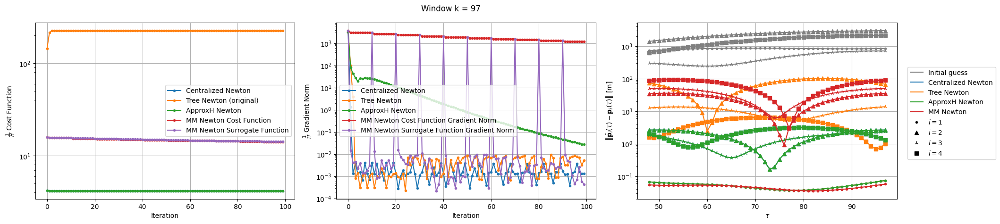


Windows:  14%|█▍        | 49/346 [2:20:52<14:11:02, 171.93s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 226.19220107546664
Gradient norm: 564.119764883815
Global relative error: 70.34564717026531
Position relative errors: 0.0648383105477912 m, 69.14192241573332 m, 12.86578108244402 m, 1.5379706762356193 m

Before applying the algorithm
L_norm = 4.232288165947013
Grad_L_norm = 611.5475673689081

Before applying the algorithm
Cost function: 4.2322901669393715
Gradient norm: 611.5797427281126
Global relative error: 3.6593845853115687
Position relative errors: 0.06483762543505034 m, 2.637627092663548 m, 1.737579278186902 m, 1.8467856147626835 m

Iteration 1
Cost function: 748.6481020964992 (230.98%)
Gradient norm: 1034.063191297125 (83.31%)
Global relative error: 91.84889516405912 (30.57%)
Position relative errors: 0.061016077510744046 m, 66.90786570731656 m, 61.91462974887523 m, 11.

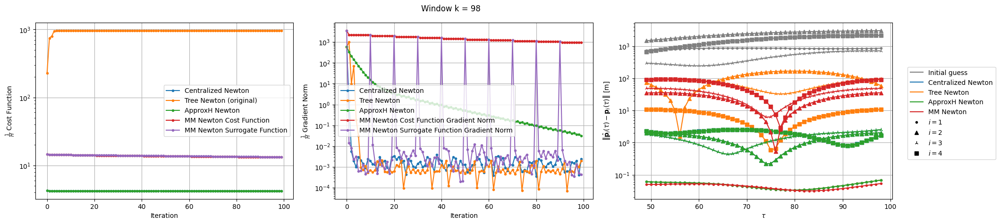


Windows:  14%|█▍        | 50/346 [2:23:41<14:03:42, 171.02s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.196517427077008
Grad_L_norm = 3017.1572891715978

Before applying the algorithm
Cost function: 4.19651674051644
Gradient norm: 3017.1894230887083
Global relative error: 3.389916390334949
Position relative errors: 0.06013285518306381 m, 1.9630232002036974 m, 1.7612048671991583 m, 2.128989369529987 m

Before applying the algorithm
Cost function: 959.8745713684065
Gradient norm: 3195.153315222544
Global relative error: 110.47743907054416
Position relative errors: 0.060130812406813824 m, 63.018392070093334 m, 90.10799733511557 m, 10.698713949641501 m

Iteration 1
Cost function: 4.175284210817811 (-0.51%)
Gradient norm: 297.89246098095657 (-90.13%)
Global relative error: 3.3482990828628667 (-1.23%)
Position relative errors: 0.06014052838843541 m, 1.983679911805706 m, 1.440424126947404 m

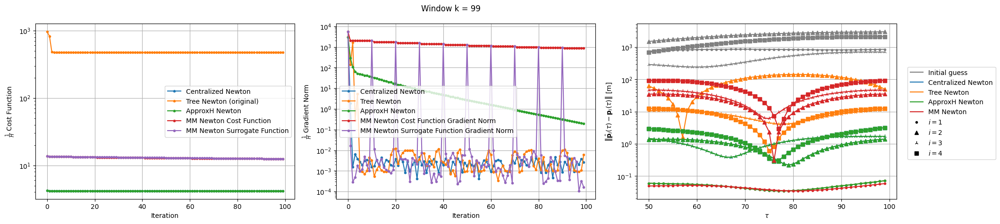


Windows:  15%|█▍        | 51/346 [2:26:30<13:57:31, 170.34s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 473.8158324722624
Gradient norm: 485.9373878879547
Global relative error: 56.198512282972025
Position relative errors: 0.05946415857081708 m, 53.74605849442548 m, 10.679178647548737 m, 12.472541976357233 m

Before applying the algorithm
Cost function: 4.085378661489262
Gradient norm: 654.5157017258841
Global relative error: 3.505352419973386
Position relative errors: 0.05946594565260621 m, 1.362646784641242 m, 1.4196242941097494 m, 2.9003121841296102 m

Before applying the algorithm
L_norm = 4.085383490819733
Grad_L_norm = 654.4331266132778

Iteration 1
Cost function: 533.4082837583435 (12.58%)
Gradient norm: 88.3831268053858 (-81.81%)
Global relative error: 62.166677350920004 (10.62%)
Position relative errors: 0.06474377432311679 m, 53.76713200377161 m, 30.827141329456712 m, 4

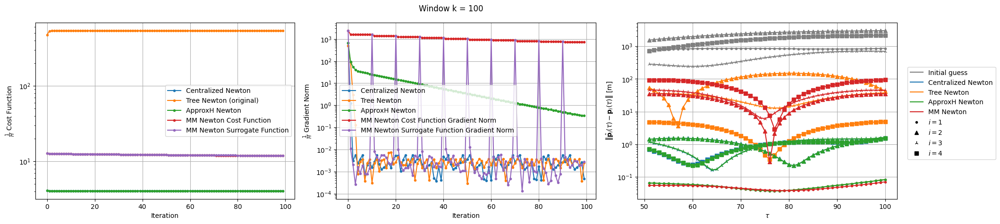


Windows:  15%|█▌        | 52/346 [2:29:21<13:55:44, 170.56s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 538.7571818188395
Gradient norm: 3916.71271915405
Global relative error: 57.41208993715654
Position relative errors: 0.06381501959127224 m, 44.91621029696172 m, 35.44814853295045 m, 4.699176597258711 m

Before applying the algorithm
Cost function: 4.072694933294988
Gradient norm: 3713.739727743548
Global relative error: 1.9168854580775563
Before applying the algorithm
L_norm = 4.072685135191079
Grad_L_norm = 3713.8961202954015
Position relative errors: 0.06381738900099664 m, 1.4432480468314708 m, 1.0879192405372333 m, 0.6354840314828645 m


Iteration 1
Cost function: 691.1359966274965 (28.28%)
Gradient norm: 91.78677822714538 (-97.66%)
Global relative error: 47.947550212485005 (-16.49%)
Position relative errors: 0.06214896960296398 m, 41.147220330664396 m, 24.595598668500216 m,

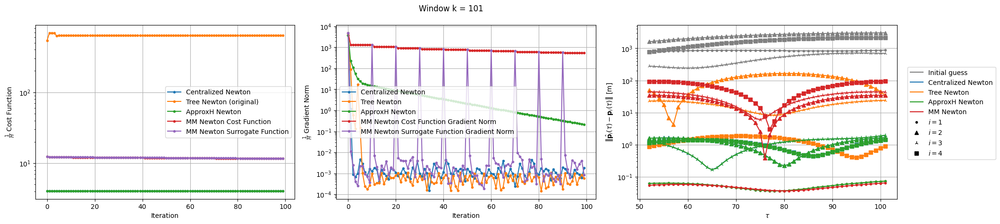


Windows:  15%|█▌        | 53/346 [2:32:10<13:51:30, 170.28s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 632.348729230993
Gradient norm: 1026.1299756314693
Global relative error: 45.32404298114153
Position relative errors: 0.06265594958934773 m, 39.030499473879736 m, 23.021827829138108 m, 0.9216795880946884 m

Before applying the algorithm
Cost function: 4.143254556158613
Gradient norm: 1402.4329417229783
Global relative error: 2.3536097902567854
Position relative errors: 0.06265683745198806 m, 1.6025601839004227 m, 1.2427290429559952 m, 1.1928846805544504 m

Before applying the algorithm
L_norm = 4.143205542470525
Grad_L_norm = 1402.1018765241054

Iteration 1
Cost function: 332.7892311995531 (-47.37%)
Gradient norm: 446.4905589846832 (-56.49%)
Global relative error: 44.67430238565996 (-1.43%)
Position relative errors: 0.056976069795309565 m, 39.83104668661412 m, 19.34326596181195

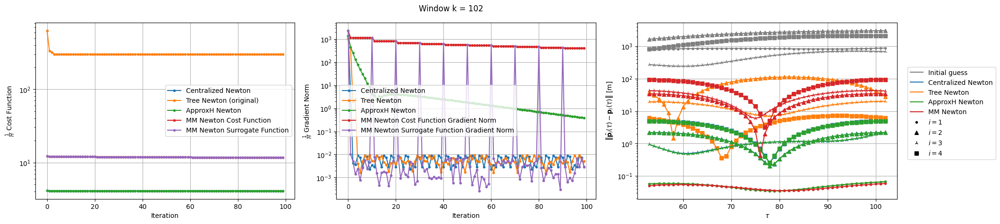


Windows:  16%|█▌        | 54/346 [2:34:59<13:45:55, 169.71s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.103789786059705
Gradient norm: 844.4583736846502
Global relative error: 5.45428539760023
Position relative errors: 0.05769982682270968 m, 2.1647469225175744 m, 0.838173605820242 m, 4.9353044070550105 m

Before applying the algorithm
Cost function: 300.4025429953785
Gradient norm: 715.328942168831
Global relative error: 36.84241956798083
Position relative errors: 0.0576985043957938 m, 30.729516772280874 m, 19.453053182451615 m, 5.884031262105544 m

Before applying the algorithm
L_norm = 4.103928512334372
Grad_L_norm = 845.2300844360649

Iteration 1
Cost function: 80.50746777770846 (-73.20%)
Gradient norm: 598.9299725673536 (-16.27%)
Global relative error: 33.37978048377449 (-9.40%)
Position relative errors: 0.061618883979073655 m, 32.221822063943286 m, 7.281612316777174 m, 4.7

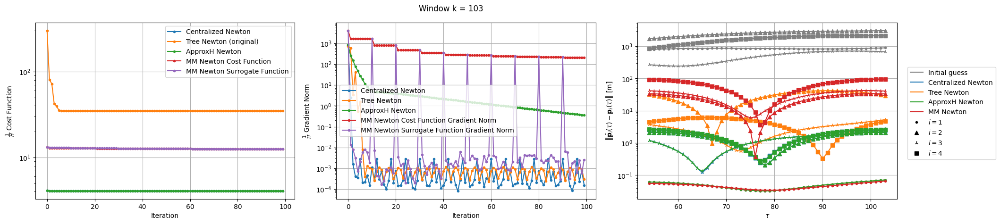


Windows:  16%|█▌        | 55/346 [2:37:48<13:43:17, 169.75s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- MM Newton ---------------- ApproxH Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 35.46604330621005
Gradient norm: 959.4432447525105
Global relative error: 30.957763303647255
Position relative errors: 0.06089119181399068 m, 30.395177820487103 m, 3.545403240095381 m, 4.684188771019509 m

Before applying the algorithm
Cost function: 4.157395014556477
Gradient norm: 858.2551079037587
Global relative error: 3.5462020340942093
Position relative errors: 0.060890672452464906 m, 2.131631551611052 m, 1.0801302791924234 m, 2.6194087842719744 m

Before applying the algorithm
L_norm = 4.157313379588805
Grad_L_norm = 857.8697799137045

Iteration 1
Cost function: 176.17529365825231 (396.74%)
Gradient norm: 2082.914988224254 (117.10%)
Global relative error: 28.072304826981618 (-9.32%)
Position relative errors: 0.05731748003858932 m, 23.922074367706678 m, 14.05688907297389 

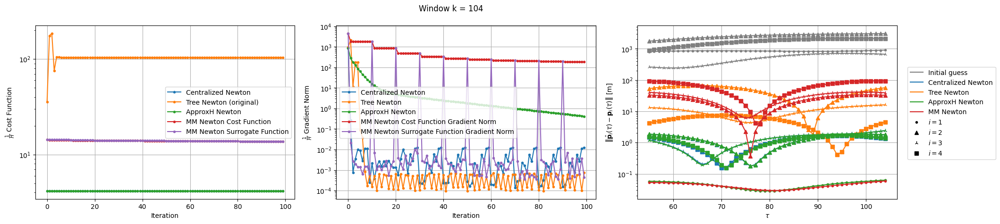


Windows:  16%|█▌        | 56/346 [2:40:37<13:38:12, 169.28s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 108.4228396026417
Gradient norm: 502.1323595600253
Global relative error: 57.52020321714781
Position relative errors: 0.056988797555020884 m, 55.86096571847827 m, 12.932319569755245 m, 4.569075477813696 m

Before applying the algorithm
L_norm = 4.169114937962132
Grad_L_norm = 1148.4577768540207

Before applying the algorithm
Cost function: 4.169080270041765
Gradient norm: 1148.0520452083094
Global relative error: 2.5746275362019553
Position relative errors: 0.0569887235212576 m, 1.8255224172918432 m, 1.0796977817610292 m, 1.4584840243997381 m

Iteration 1
Cost function: 197.5760031674506 (82.23%)
Gradient norm: 95.95896710894637 (-80.89%)
Global relative error: 62.92316548533343 (9.39%)
Position relative errors: 0.05520092443912728 m, 61.172391447125676 m, 14.669594956059099 m,

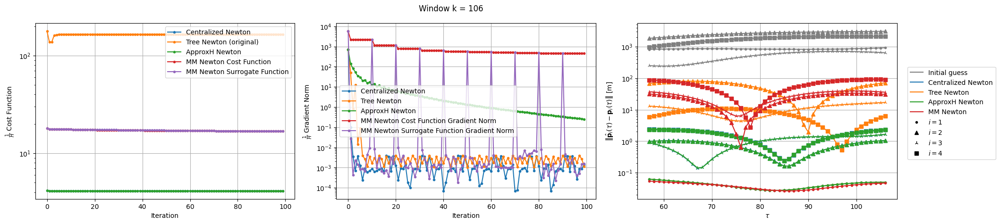


Windows:  17%|█▋        | 58/346 [2:46:15<13:32:34, 169.28s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 172.67124392143862
Gradient norm: 536.1309519674202
Global relative error: 71.49794316254719
Position relative errors: 0.06051828315912658 m, 70.07539719747 m, 12.70061211326911 m, 6.331137874156834 m

Before applying the algorithm
L_norm = 4.175512258221595
Grad_L_norm = 892.7982248591917

Before applying the algorithm
Cost function: 4.175405602905486
Gradient norm: 891.8965697571965
Global relative error: 2.6659956631197903
Position relative errors: 0.06051853436012384 m, 0.9991359362315098 m, 0.8318857580584544 m, 2.3267058432905428 m

Iteration 1
Cost function: 146.35379054983412 (-15.24%)
Gradient norm: 472.1236726784182 (-11.94%)
Global relative error: 82.72668119714244 (15.70%)
Position relative errors: 0.05627487384034138 m, 81.94715059519909 m, 10.121375365526813 m, 5.

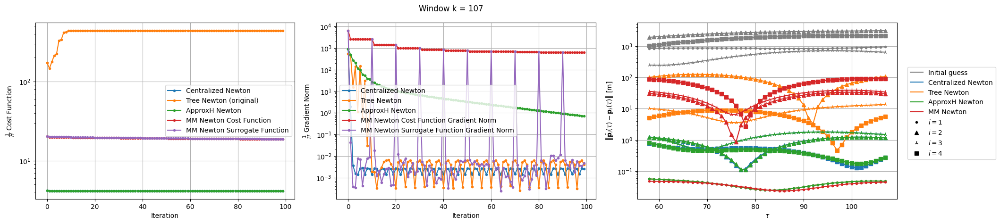


Windows:  17%|█▋        | 59/346 [2:49:04<13:29:17, 169.19s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.14094437772895
Grad_L_norm = 699.1718229415584
Before applying the algorithm
Cost function: 456.6043057989697
Gradient norm: 463.29056329533904
Global relative error: 104.70738877611682

Position relative errors: 0.055366339102992795 m, 104.09976735831715 m, 9.829971192807154 m, 5.498960108450602 m

Before applying the algorithm
Cost function: 4.140706577924075
Gradient norm: 697.5230238273134
Global relative error: 1.802470169443512
Position relative errors: 0.05536757113225631 m, 1.1794709616794505 m, 1.1481269439380364 m, 0.7324494214578103 m

Iteration 1
L_norm = 4.123324886369027
Grad_L_norm = 1.033753265969598
Iteration 1
Cost function: 804.8685853451223 (76.27%)
Gradient norm: 366.4817022035215 (-20.90%)
Global relative error: 108.43109316504767 (3.56%)

Position relative er

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 2
Cost function: 22.998033913727536 (0.00%)
Gradient norm: 0.0004694904557131503 (-94.51%)
Global relative error: 88.1814207853972 (0.00%)
Position relative errors: 0.06406571610688949 m, 27.493790975181163 m, 29.809688364869082 m, 78.3034502916842 m

Iteration 89
Cost function: 4.076007881692126 (-0.00%)
Gradient norm: 0.20530283589631051 (-3.02%)
Global relative error: 1.977331280160753 (0.00%)
Position relative errors: 0.08127605069657227 m, 1.321670430457169 m, 1.148932673392392 m, 0.9145312812698458 m

Iteration 89
L_norm = 4.076007621676752
Grad_L_norm = 0.0020125526811871483

Iteration 91
Cost function: 761.0667614596347 (0.00%)
Gradient norm: 0.0017343998327052103 (-67.49%)
Global relative error: 123.65200327147336 (-0.00%)
Position relative errors: 0.08127458398861141 m, 123.55580661781715 m, 3.698657107272588 m, 3.175665165111615 m

Iteration 90
Cost function: 4.076007865413344 (-0.00%)
Gradient norm: 0.19812155496206013 (-3.50%)
Global relative error: 1.97739876229

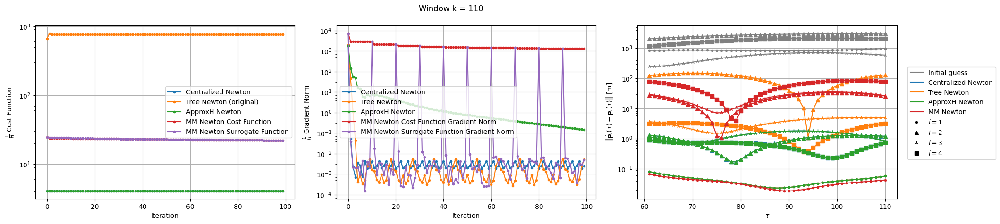


Windows:  18%|█▊        | 62/346 [2:57:44<13:36:45, 172.55s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 785.0306882280695
Gradient norm: 1640.9024065051692
Global relative error: 129.0610225156738
Position relative errors: 0.07562850785611511 m, 128.97297584771025 m, 3.5392417608128053 m, 3.1905634017442006 m

Before applying the algorithm
L_norm = 4.091771372118291
Grad_L_norm = 1458.8035005153733

Before applying the algorithm
Cost function: 4.091801550317481
Gradient norm: 1459.1836036280147
Global relative error: 1.8601294851061294
Position relative errors: 0.07562973190157492 m, 1.2631133494515048 m, 1.0514708379862596 m, 0.8679337631336763 m

Iteration 1
Cost function: 889.9925576325082 (13.37%)
Gradient norm: 20.253233069040387 (-98.77%)
Global relative error: 134.3245846971658 (4.08%)
Position relative errors: 0.08555642247782709 m, 134.25518066863293 m, 2.412610009187996

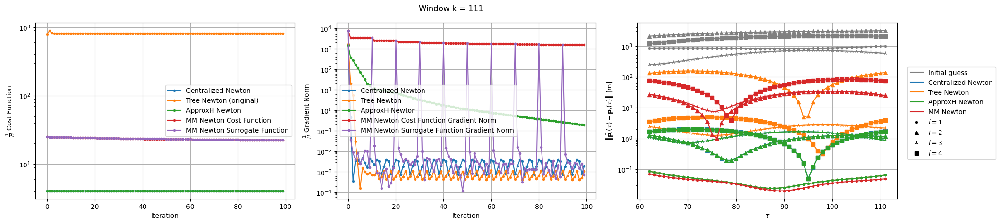


Windows:  18%|█▊        | 63/346 [3:00:45<13:44:44, 174.86s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 842.6045063333854
Gradient norm: 5427.726317700696
Global relative error: 135.65403130834392
Position relative errors: 0.07962802800056461 m, 135.5826970484664 m, 2.298631881147476 m, 3.7485440024782197 m

Before applying the algorithm
Cost function: 4.0894380988611605
Gradient norm: 5323.500803881425
Global relative error: 2.346396116180099
Position relative errors: 0.07962940249912338 m, 1.196401293293399 m, 1.0093822687439034 m, 1.7461383938531625 m

Before applying the algorithm
L_norm = 4.089452361356579
Grad_L_norm = 5323.277113809793

Iteration 1
Cost function: 1024.1179807314275 (21.54%)
Gradient norm: 75.47419836777304 (-98.61%)
Global relative error: 139.2356489413371 (2.64%)
Position relative errors: 0.05433834068832621 m, 139.12294800719204 m, 1.163113624521744 m, 5

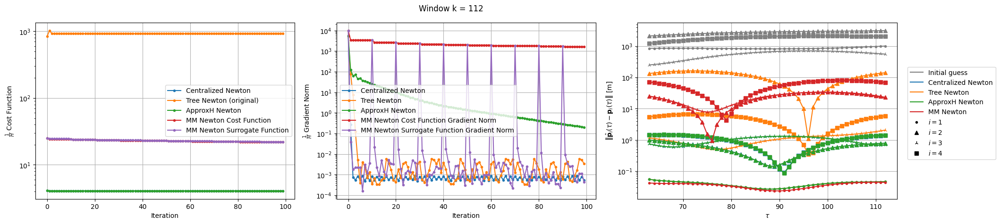


Windows:  18%|█▊        | 64/346 [3:03:33<13:33:12, 173.02s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 954.3932940238476
Gradient norm: 3528.752936393717
Global relative error: 139.88045285800993
Position relative errors: 0.052121122945590216 m, 139.75923636978405 m, 1.1099098407887202 m, 5.714363058628961 m

Before applying the algorithm
Cost function: 4.149754000146582
Gradient norm: 3565.441356977332
Global relative error: 1.8839548080587354
Position relative errors: 0.052119581168192305 m, 0.9551244942169638 m, 0.6936750831130452 m, 1.467350705164023 m

Before applying the algorithm
L_norm = 4.149748594470912
Grad_L_norm = 3565.274566082044

Iteration 1
Cost function: 717.365692612057 (-24.84%)
Gradient norm: 92.52706611054025 (-97.38%)
Global relative error: 119.93494241401437 (-14.26%)
Position relative errors: 0.06076082699329053 m, 119.65189223283915 m, 1.411111311122143

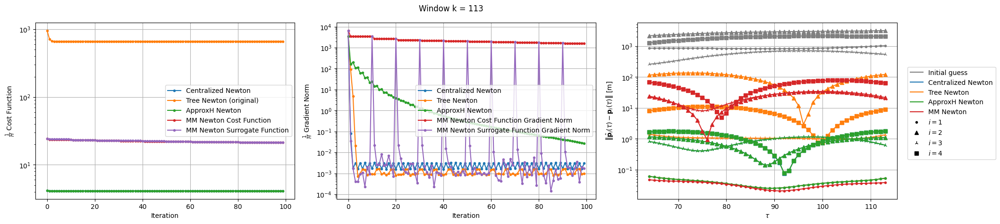


Windows:  19%|█▉        | 65/346 [3:06:22<13:24:39, 171.81s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.182744597844881
Gradient norm: 4527.5662888489815
Global relative error: 2.1915707895230736
Position relative errors: 0.05772587122282755 m, 1.1364418156333627 m, 0.7678823992462075 m, 1.7083632851486084 m

Before applying the algorithm
L_norm = 4.182743870366149
Grad_L_norm = 4527.594629556554

Before applying the algorithm
Cost function: 684.5277570307903
Gradient norm: 4488.484462804294
Global relative error: 119.85960836249457
Position relative errors: 0.057726198046085614 m, 119.54584999387644 m, 1.3317880871848644 m, 8.563489921012609 m

Iteration 1
Cost function: 4.1652487855437705 (-0.42%)
Gradient norm: 111.7896431586126 (-97.53%)
Global relative error: 2.224662406301478 (1.51%)
Position relative errors: 0.046915338634866736 m, 1.0318027120252415 m, 0.849000680019285

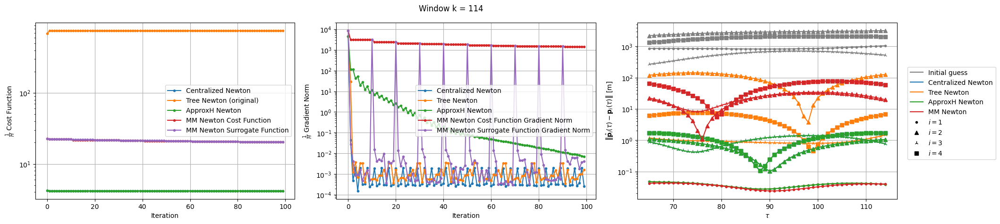


Windows:  19%|█▉        | 66/346 [3:09:08<13:12:56, 169.91s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 776.7854317629585
Gradient norm: 826.9649719675502
Global relative error: 124.69463277312478
Position relative errors: 0.046544204610221095 m, 124.52650073948529 m, 1.1374251251153604 m, 6.371818458663107 m

Before applying the algorithm
L_norm = 4.271282509191856
Grad_L_norm = 849.5487950383846

Before applying the algorithm
Cost function: 4.271280063463748
Gradient norm: 849.5360466920692
Global relative error: 2.182190254913742
Position relative errors: 0.046543785820830595 m, 1.0748701039155981 m, 0.8210790499573495 m, 1.7118027517345562 m

Iteration 1
Cost function: 1085.6020844655602 (39.76%)
Gradient norm: 96.50733453752244 (-88.33%)
Global relative error: 141.90210294197823 (13.80%)
Position relative errors: 0.04177658473816979 m, 141.80262880595558 m, 2.676455965359908

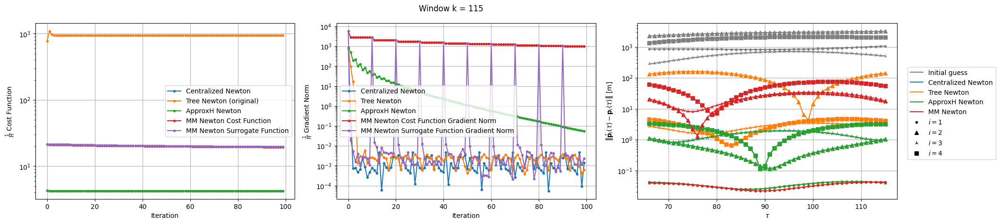


Windows:  19%|█▉        | 67/346 [3:11:54<13:04:28, 168.70s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 976.6397209786612
Gradient norm: 868.1492720727215
Global relative error: 138.94070903851107
Position relative errors: 0.041355412765833585 m, 138.84762688698206 m, 2.5720596677279137 m, 4.385477234412715 m

Before applying the algorithm
Cost function: 4.266652273754477
Gradient norm: 945.2090308835586
Global relative error: 3.547479436860404
Position relative errors: 0.04135497214360731 m, 1.0402689872667763 m, 0.9332602348805017 m, 3.2603310356945774 m

Before applying the algorithm
L_norm = 4.266646702516214
Grad_L_norm = 945.2560422719065

Iteration 1
Cost function: 1010.4831871448935 (3.47%)
Gradient norm: 159.99794626505317 (-81.57%)
Global relative error: 151.1449709958386 (8.78%)
Position relative errors: 0.04060280883466525 m, 151.0483645862556 m, 1.3765251574329327 m,

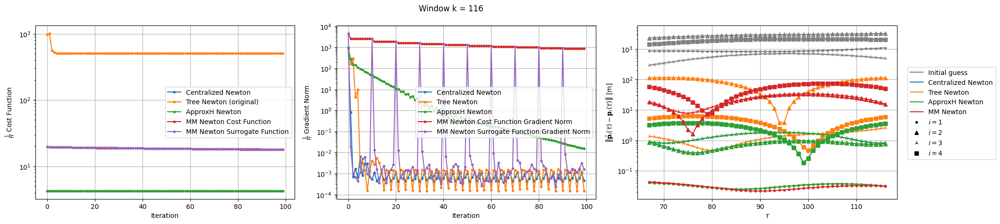


Windows:  20%|█▉        | 68/346 [3:14:41<12:59:50, 168.31s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 524.5041217059074
Gradient norm: 2850.1450249953186
Global relative error: 113.19039983726283
Position relative errors: 0.0400417347190565 m, 113.05245092243263 m, 1.3062292679524836 m, 5.431537140009539 m

Before applying the algorithm
Cost function: 4.44111706262244
Gradient norm: 2912.275227947232
Global relative error: 3.527505863226511
Position relative errors: 0.040040888720959476 m, 0.7873909612644576 m, 0.8606686762347903 m, 3.3288059813146083 m

Iteration 1
Cost function: 967.5283670577146 (84.47%)
Gradient norm: 4218.690781692959 (48.02%)
Global relative error: 137.16437003886023 (21.18%)
Position relative errors: 0.03258415413393143 m, 137.11172850409082 m, 2.0006886827668393 m, 3.2265517454038832 m

Iteration 1
Cost function: 4.41253051297048 (-0.64%)
Gradient norm:

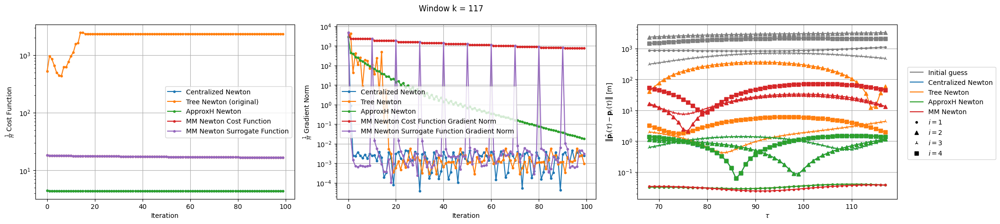


Windows:  20%|█▉        | 69/346 [3:17:28<12:55:08, 167.90s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.271590848180789
Grad_L_norm = 601.4625374493461

Before applying the algorithm
Cost function: 2357.0690152257616
Gradient norm: 798.1926702108177
Global relative error: 56.839638470038864
Position relative errors: 0.03259149057855618 m, 56.73511726362388 m, 1.9132040000250596 m, 2.837649603055296 m

Before applying the algorithm
Cost function: 4.2715911378093185
Gradient norm: 601.4682202667509
Global relative error: 1.8748031161197745
Position relative errors: 0.0325911218663639 m, 1.0867663179231453 m, 0.677805343938208 m, 1.3686998777961064 m

Iteration 1
L_norm = 4.240654524250919
Grad_L_norm = 0.7733021514053166

Iteration 1
Cost function: 2132.8561431802127 (-9.51%)
Gradient norm: 89.53849743447552 (-88.78%)
Global relative error: 61.66199520352694 (8.48%)
Position relative e

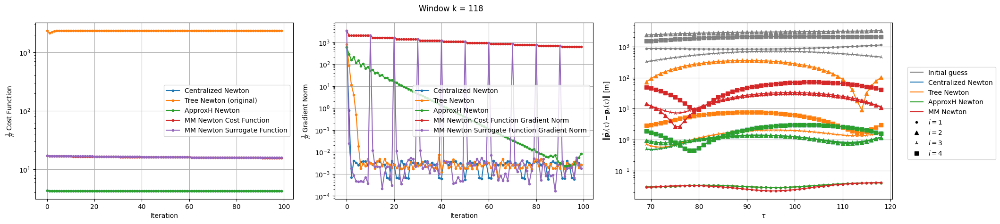


Windows:  20%|██        | 70/346 [3:20:18<12:55:51, 168.66s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2377.1839779535685
Gradient norm: 823.1150709217545
Global relative error: 93.5840085680864
Position relative errors: 0.029659580416072025 m, 93.53396810974158 m, 0.6325606060914025 m, 2.968983646734793 m

Before applying the algorithm
Cost function: 4.215771113755246
Gradient norm: 671.6769667701996
Global relative error: 1.9831887860525759
Position relative errors: 0.029659700167953693 m, 0.8737294975475648 m, 0.4799050775876242 m, 1.7141851238890602 m

Before applying the algorithm
L_norm = 4.215771074825106
Grad_L_norm = 671.6700321711796

Iteration 1
Cost function: 2135.8217720886178 (-10.15%)
Gradient norm: 160.7025110805716 (-80.48%)
Global relative error: 100.92957137087471 (7.85%)
Position relative errors: 0.03844237156869061 m, 100.83138554657609 m, 0.9270553947206106

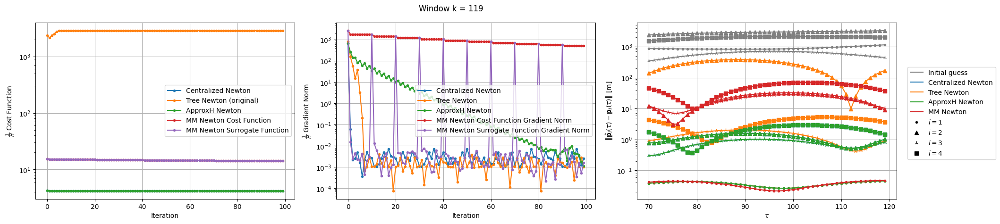


Windows:  21%|██        | 71/346 [3:23:09<12:55:59, 169.31s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2952.487632205599
Gradient norm: 1785.1633885792976
Global relative error: 160.6849786612081
Position relative errors: 0.03942817542524959 m, 160.63107132792368 m, 0.9655008926488451 m, 4.029687453303105 m

Before applying the algorithm
L_norm = 4.190306912162232
Grad_L_norm = 1665.2437429863842

Before applying the algorithm
Cost function: 4.1903071004813555
Gradient norm: 1665.2471955548926
Global relative error: 1.754578743838757
Position relative errors: 0.03942829167227489 m, 0.783203820040832 m, 0.3060027214198295 m, 1.5394584219147809 m

Iteration 1
Cost function: 2693.1130143157125 (-8.78%)
Gradient norm: 48.25691448876116 (-97.30%)
Global relative error: 156.9524820610434 (-2.32%)
Position relative errors: 0.04397639657445383 m, 156.8565532857737 m, 1.032900980904407 m

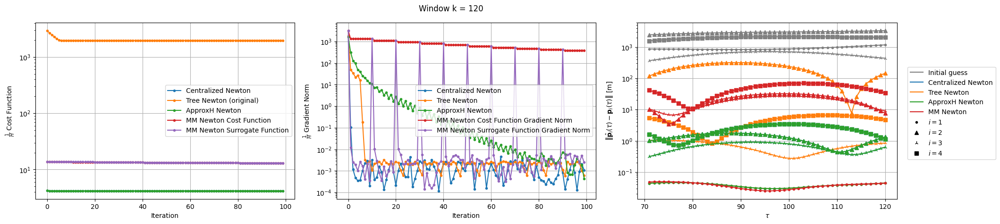


Windows:  21%|██        | 72/346 [3:25:56<12:50:15, 168.67s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2049.9476933005494
Gradient norm: 2968.6585579032594
Global relative error: 136.58706951564525
Position relative errors: 0.04470542314084468 m, 136.49023558395524 m, 1.0378988286415944 m, 5.026333503938608 m

Before applying the algorithm
Cost function: 4.072661944527522
Gradient norm: 2786.9101271633085
Global relative error: 1.7689715900609897
Position relative errors: 0.044704912532818344 m, 1.0505820913052812 m, 0.3425793010465752 m, 1.3806371218545084 m

Before applying the algorithm
L_norm = 4.072662001581808
Grad_L_norm = 2786.90850081219

Iteration 1
Cost function: 1895.444508509456 (-7.54%)
Gradient norm: 106.23228313909223 (-96.42%)
Global relative error: 141.89863834490913 (3.89%)
Position relative errors: 0.04845010618506944 m, 141.87386004645853 m, 0.44846369506072

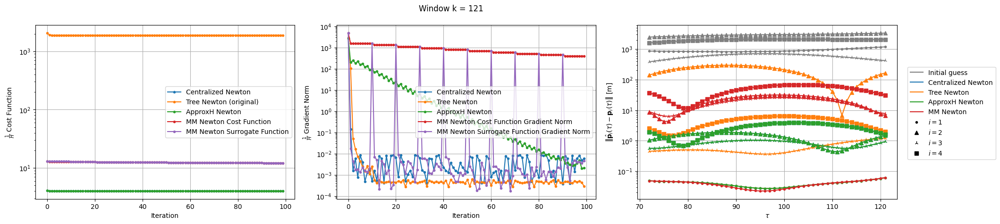


Windows:  21%|██        | 73/346 [3:28:44<12:46:11, 168.39s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.019028307802313
Grad_L_norm = 1668.4187806629352

Before applying the algorithm
Cost function: 1974.5239715339753
Gradient norm: 1638.8720239851382
Global relative error: 158.5297996508273
Position relative errors: 0.04744881635222085 m, 158.5131552810273 m, 0.4590695278918699 m, 2.2329855931537392 m

Before applying the algorithm
Cost function: 4.01902814527433
Gradient norm: 1668.4138745330513
Global relative error: 2.123927881658083
Position relative errors: 0.04744900259415557 m, 1.132080171092947 m, 0.5633888106346052 m, 1.7058087428436635 m

Iteration 1
L_norm = 3.991320064349338
Grad_L_norm = 0.13908169736889367

Iteration 1
Cost function: 2100.119951234893 (6.36%)
Gradient norm: 45.03490896581871 (-97.25%)
Global relative error: 157.3618897380685 (-0.74%)
Position relative 

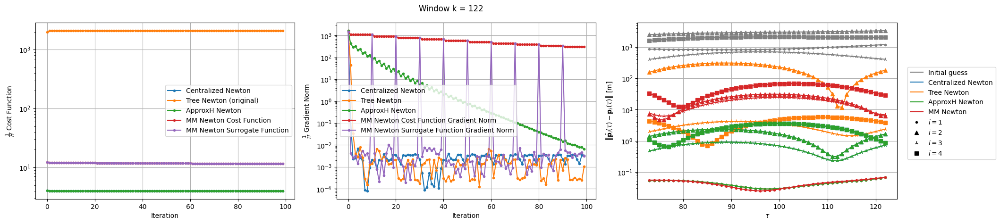


Windows:  21%|██▏       | 74/346 [3:31:36<12:47:37, 169.33s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.005512290675752
Grad_L_norm = 1112.075063481071

Before applying the algorithm
Cost function: 2195.4612253307832
Gradient norm: 997.4313981381133
Global relative error: 174.46439001759006
Position relative errors: 0.053010648244771585 m, 174.4060367522323 m, 2.106256786708447 m, 3.979631550464416 m

Before applying the algorithm
Cost function: 4.005512552174389
Gradient norm: 1112.0719068083574
Global relative error: 1.8169516149182672
Position relative errors: 0.053010221656889844 m, 1.491097723063419 m, 0.5147277520128916 m, 0.9000915480671422 m

Iteration 1
Cost function: 1950.646969854659 (-11.15%)
Gradient norm: 313.62147433247566 (-68.56%)
Global relative error: 180.19960052034733 (3.29%)
Position relative errors: 0.04722738180719714 m, 180.16860747975932 m, 3.080180615578355

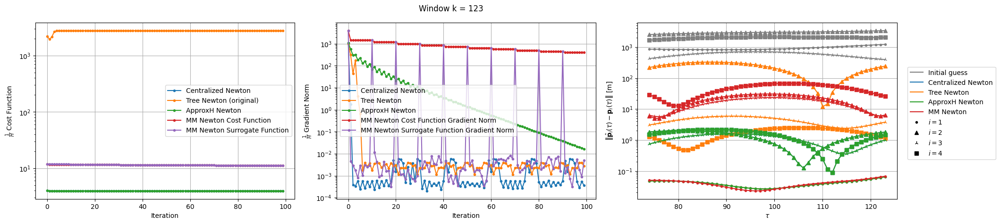


Windows:  22%|██▏       | 75/346 [3:34:23<12:42:19, 168.78s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 2928.5209274422236
Gradient norm: 2443.280901762202
Global relative error: 235.76121163086685
Position relative errors: 0.047414600206515986 m, 235.73566123343397 m, 3.2709590403449997 m, 1.1319088402908108 m

Before applying the algorithm
L_norm = 3.9477097742627882
Grad_L_norm = 2407.879723984989

Before applying the algorithm
Cost function: 3.947710875992003
Gradient norm: 2407.886088081443
Global relative error: 2.5996933420231487
Position relative errors: 0.04741511318538369 m, 1.8786849444578033 m, 0.8215481327279515 m, 1.5974201819562046 m

Iteration 1
Cost function: 3134.3046801324467 (7.03%)
Gradient norm: 96.95926849228906 (-96.03%)
Global relative error: 236.09997045806116 (0.14%)
Position relative errors: 0.04684849956212471 m, 236.03725477645398 m, 3.04941801383924

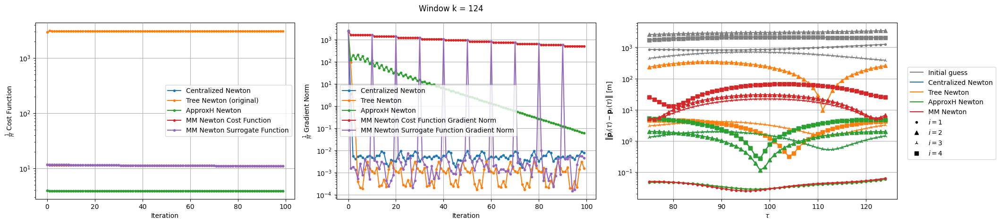


Windows:  22%|██▏       | 76/346 [3:37:15<12:43:24, 169.65s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3254.5356016688825
Gradient norm: 1354.3820185872223
Global relative error: 249.83839740725918
Position relative errors: 0.047035013980773956 m, 249.77687836009318 m, 3.135137677397101 m, 4.56466376428954 m

Before applying the algorithm
Cost function: 3.880306999964378
Gradient norm: 1229.159881341323
Global relative error: 5.6948570571227926
Position relative errors: 0.04703473043675796 m, 1.988788320626817 m, 1.385269615967458 m, 5.15314653580192 m

Before applying the algorithm
L_norm = 3.8803086802516717
Grad_L_norm = 1229.135846955897

Iteration 1
Cost function: 3.8710560427207144 (-0.24%)
Gradient norm: 230.63473599365798 (-81.24%)
Global relative error: 5.781957473416769 (1.53%)
Position relative errors: 0.05571449567986605 m, 1.7792897812978201 m, 1.4480616941403759 m,

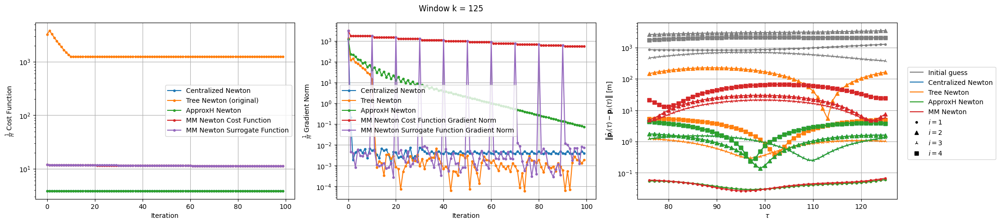


Windows:  22%|██▏       | 77/346 [3:40:07<12:43:38, 170.33s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1305.5129843728587
Gradient norm: 876.6913202703145
Global relative error: 158.76191934099458
Position relative errors: 0.0546635276180632 m, 158.66820722946258 m, 1.2006690731063403 m, 5.317055872902507 m

Before applying the algorithm
L_norm = 3.920508632878507
Grad_L_norm = 829.4612007026745

Before applying the algorithm
Cost function: 3.9205077527547125
Gradient norm: 829.4130394256637
Global relative error: 4.714711404314858
Position relative errors: 0.05466385459639314 m, 1.7130473833035962 m, 1.2692061135225665 m, 4.204769669221513 m

Iteration 1
Cost function: 1862.8097389623 (42.69%)
Gradient norm: 274.323612894938 (-68.71%)
Global relative error: 187.96524104171604 (18.39%)
Position relative errors: 0.06911056936738327 m, 187.81921642784937 m, 4.99124503220169 m, 5.4

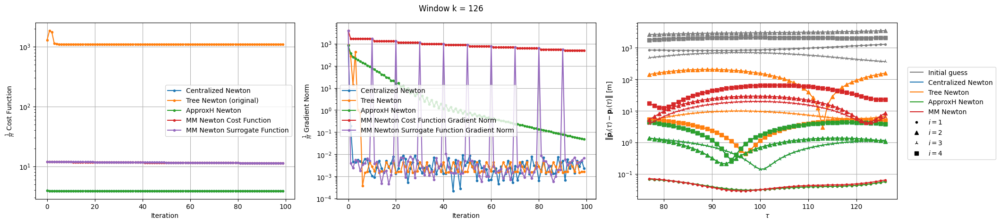


Windows:  23%|██▎       | 78/346 [3:42:55<12:38:26, 169.80s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1158.1082650583653
Gradient norm: 1136.3925283927756
Global relative error: 153.29799501193287
Position relative errors: 0.06746399709303715 m, 153.11348124961037 m, 5.314039307339017 m, 5.316947330714334 m

Before applying the algorithm
L_norm = 3.975214776303473
Grad_L_norm = 1129.5018824298731

Before applying the algorithm
Cost function: 3.975217801993848
Gradient norm: 1129.5348889250113
Global relative error: 4.626343121242523
Position relative errors: 0.06746349358619183 m, 1.303923310882329 m, 1.3189725586934937 m, 4.237755853086687 m

Iteration 1
Cost function: 1205.9528801299357 (4.13%)
Gradient norm: 52.23018921940205 (-95.40%)
Global relative error: 153.10761965551532 (-0.12%)
Position relative errors: 0.07150547628075125 m, 153.04395063174636 m, 1.6446586194157438 

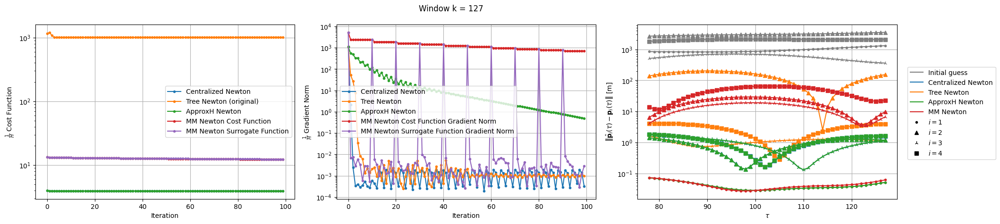


Windows:  23%|██▎       | 79/346 [3:45:51<12:43:52, 171.66s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1041.7928521639064
Gradient norm: 827.3280969029043
Global relative error: 148.86870822145522
Position relative errors: 0.06940372699705354 m, 148.80459596662425 m, 1.47505492606807 m, 4.108666351947158 m

Before applying the algorithm
L_norm = 3.912507155586405
Grad_L_norm = 863.7326088092043

Before applying the algorithm
Cost function: 3.9125262350511685
Gradient norm: 863.911799840288
Global relative error: 2.8540190209219736
Position relative errors: 0.06940532437628513 m, 1.3498788955523204 m, 1.7574838111976978 m, 1.7971307751185175 m

Iteration 1
Cost function: 1032.075689488167 (-0.93%)
Gradient norm: 149.70613950756933 (-81.90%)
Global relative error: 138.62294758489531 (-6.88%)
Position relative errors: 0.07923258322456585 m, 138.53382129325607 m, 2.737087519801098 m

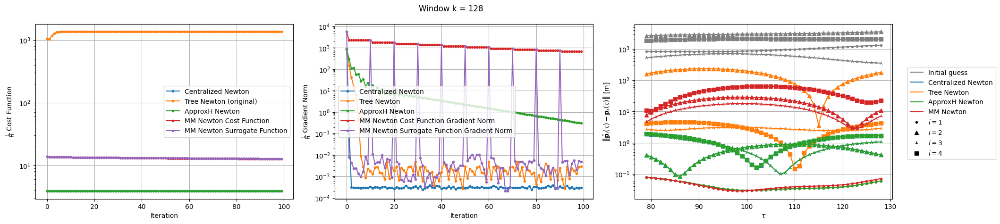


Windows:  23%|██▎       | 80/346 [3:48:46<12:45:07, 172.59s/it]

-------- Tree Newton --------
-------- Centralized Newton ---------------- ApproxH Newton ---------------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 1394.6090635418648
Gradient norm: 2417.3649021240617
Global relative error: 172.2804751664421
Position relative errors: 0.07649287593427645 m, 172.20779712167413 m, 2.6231232984938826 m, 4.256640556383889 m

Before applying the algorithm
L_norm = 3.916262594833963
Grad_L_norm = 2341.3486642487255

Before applying the algorithm
Cost function: 3.916294258930364
Gradient norm: 2341.2850665082206
Global relative error: 2.6240765905170385
Position relative errors: 0.0764942342369719 m, 0.3510862252797081 m, 1.7894878309012288 m, 1.885309394074291 m

Iteration 1
Cost function: 2036.8150338912278 (46.05%)
Gradient norm: 427.8475018019374 (-82.30%)
Global relative error: 206.57186250814812 (19.90%)
Position relative errors: 0.07664675337569724 m, 206.48648979374477 m, 5.781647124976338

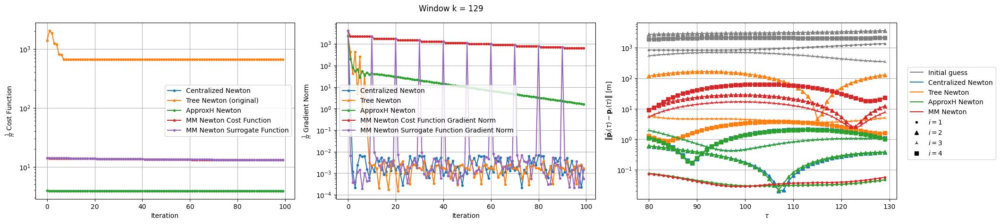


Windows:  23%|██▎       | 81/346 [3:51:54<13:01:52, 177.03s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3.8838557573326176
Gradient norm: 2429.7716973694505
Global relative error: 2.141788679822419
Position relative errors: 0.07339856123800764 m, 0.5865140255704597 m, 1.8029520387449371 m, 0.9935919396332792 m

Before applying the algorithm
Cost function: 674.3643230261425
Gradient norm: 2399.737119963426
Global relative error: 125.89111469520671
Position relative errors: 0.0733909598783416 m, 125.7667199588676 m, 5.478200271235599 m, 1.1290691725803996 m

Before applying the algorithm
L_norm = 3.8835719215480715
Grad_L_norm = 2428.92309274388

Iteration 1
Cost function: 3.8646722267254403 (-0.49%)
Gradient norm: 442.6351234419525 (-81.78%)
Global relative error: 3.3066793424616368 (54.39%)
Position relative errors: 0.06383878908149068 m, 1.1140499305273566 m, 1.8283086528893993 

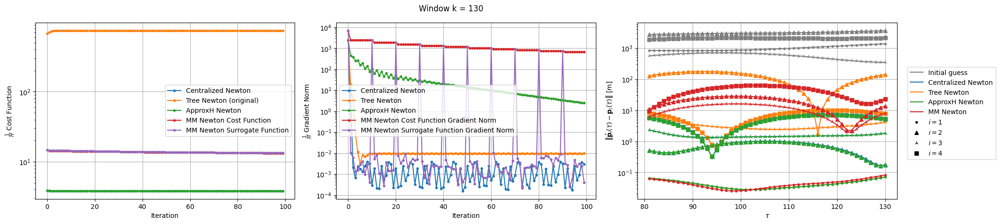


Windows:  24%|██▎       | 82/346 [3:55:06<13:19:22, 181.68s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 3.8979485233841102
Grad_L_norm = 4485.100803042807

Before applying the algorithm
Cost function: 754.3385186569291
Gradient norm: 4527.048550782415
Global relative error: 137.20222855730367
Position relative errors: 0.06254154582198583 m, 136.83168123930278 m, 6.292469737183461 m, 7.86945603747251 m

Before applying the algorithm
Cost function: 3.8979610441621095
Gradient norm: 4484.743335386028
Global relative error: 5.679002867675024
Position relative errors: 0.0625525763092343 m, 0.46469139152938643 m, 2.116632142232114 m, 5.248908128868598 m

Iteration 1
Cost function: 804.7581663126111 (6.68%)
Gradient norm: 28.973025421208206 (-99.36%)
Global relative error: 143.1892881414819 (4.36%)
Position relative errors: 0.06106632029857807 m, 142.93499138649247 m, 5.413285166157129 m, 6.5

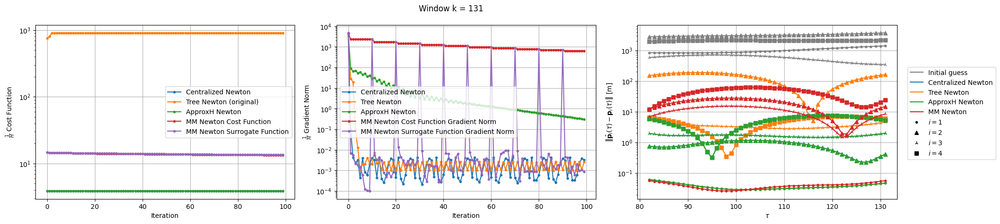


Windows:  24%|██▍       | 83/346 [3:58:09<13:17:48, 182.01s/it]

-------- Centralized Newton ---------------- Tree Newton --------
-------- ApproxH Newton ---------------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3.8863747797102106
Gradient norm: 1442.1501109336823
Global relative error: 5.780448480384381
Position relative errors: 0.05861763274833044 m, 0.7267329226029182 m, 1.862641723317482 m, 5.423330788451025 m
Before applying the algorithm
L_norm = 3.8863775966103087
Grad_L_norm = 1442.2809748655432


Before applying the algorithm
Cost function: 916.5761740648222
Gradient norm: 1271.1448296467572
Global relative error: 158.169171234495
Position relative errors: 0.058616475510590446 m, 157.96326065887493 m, 5.0577458257122965 m, 6.284681205957987 m

Iteration 1
Cost function: 3.866966978967166 (-0.50%)
Gradient norm: 244.87783124926335 (-83.02%)
Global relative error: 6.079501793831351 (5.17%)
Iteration 1
Cost function: 292.66189128899015 (-68.07%)
Gradient norm: 5477.650084870672 (

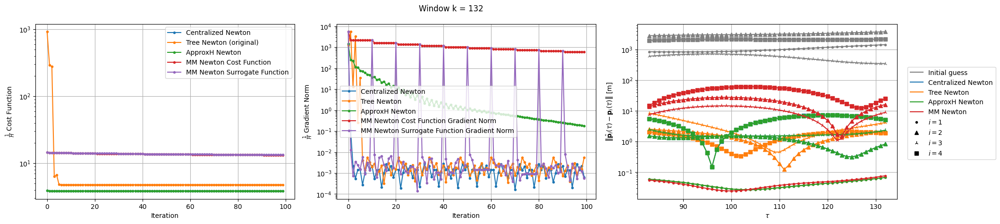


Windows:  24%|██▍       | 84/346 [4:01:17<13:22:32, 183.79s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.903780596531177
Gradient norm: 4571.287825956314
Global relative error: 8.443105735791237
Position relative errors: 0.05775654835504892 m, 2.463242022515206 m, 7.827123118404543 m, 1.9877531750752482 m

Before applying the algorithm
L_norm = 4.043058180655089
Grad_L_norm = 4394.4686333467225

Before applying the algorithm
Cost function: 4.043024041602734
Gradient norm: 4394.435450280629
Global relative error: 5.860187412609542
Position relative errors: 0.05775719246391935 m, 1.4620302093123494 m, 2.291716221579265 m, 5.191233586256032 m

Iteration 1
Cost function: 8.354037207858147 (70.36%)
Gradient norm: 8.94350110958812 (-99.80%)
Global relative error: 10.111669953345487 (19.76%)
Position relative errors: 0.06923921178208978 m, 2.4155143822820153 m, 9.309422546200274 m, 3.1

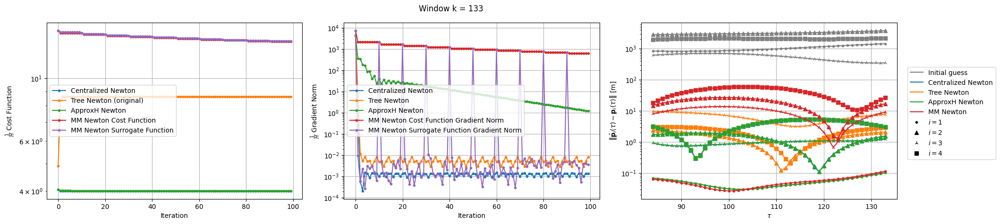


Windows:  25%|██▍       | 85/346 [4:04:22<13:21:24, 184.23s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8.466941565299425
Gradient norm: 1035.4208435549237
Global relative error: 10.249008490169327
Position relative errors: 0.06727475076494668 m, 2.338135472830122 m, 9.490586614859728 m, 3.082122729304343 m

Before applying the algorithm
Cost function: 3.9444268148970196
Gradient norm: 1146.624157682944
Global relative error: 3.489695760481115
Position relative errors: 0.0672704529988027 m, 1.7526870233063512 m, 0.8747743739331117 m, 2.887260732323938 m
Before applying the algorithm
L_norm = 3.944344755444302
Grad_L_norm = 1146.0956332043297


Iteration 1
Cost function: 7.732818286086548 (-8.67%)
Gradient norm: 45.64274682437486 (-95.59%)
Global relative error: 10.33191175541834 (0.81%)
Position relative errors: 0.07272829516075834 m, 2.2122406508734374 m, 9.945623003775188 m, 1.

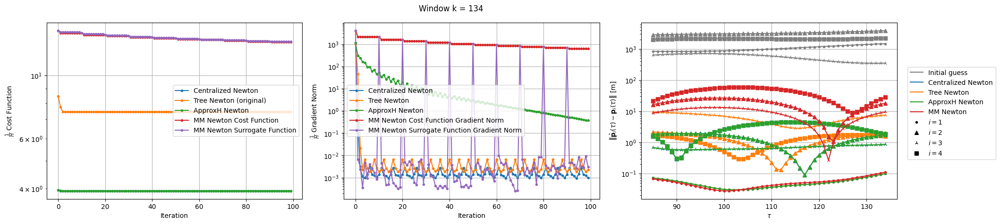


Windows:  25%|██▍       | 86/346 [4:07:52<13:51:26, 191.87s/it]

-------- Centralized Newton ---------------- MM Newton ---------------- Tree Newton ---------------- ApproxH Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.044571903597679
Grad_L_norm = 4552.868632179704

Before applying the algorithm
Cost function: 7.701887633660223
Gradient norm: 4524.164594837255
Global relative error: 9.805405613576593
Position relative errors: 0.06988989439895728 m, 2.114554561492979 m, 9.421729876432948 m, 1.7031419060361999 m

Before applying the algorithm
Cost function: 4.044574147649287
Gradient norm: 4552.947269441047
Global relative error: 2.3803706203044173
Position relative errors: 0.06988783178699662 m, 1.8686755174908658 m, 0.6547376384071976 m, 1.3193272286253535 m

Iteration 1
L_norm = 4.022442536706635
Grad_L_norm = 0.4570269064945024

Iteration 1
Cost function: 4.026445116247707 (-0.45%)
Gradient norm: 123.94540628030154 (-97.28%)
Global relative error: 2.8857367023948535 (21.23%)
Position relative 

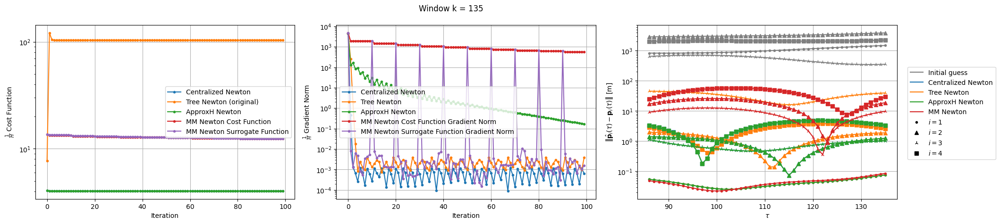


Windows:  25%|██▌       | 87/346 [4:11:21<14:11:23, 197.23s/it]

-------- Centralized Newton ---------------- MM Newton ---------------- Tree Newton ---------------- ApproxH Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 104.02051109297783
Gradient norm: 5946.812708376455
Global relative error: 45.29709473845597
Position relative errors: 0.052407110476610695 m, 1.9625364663555462 m, 45.176463162238186 m, 2.6568485327773836 m

Before applying the algorithm
Cost function: 4.137060194926419
Gradient norm: 5911.282248555957
Global relative error: 3.5693919060938963
Position relative errors: 0.05240670815509294 m, 1.395012961532704 m, 1.049409640803516 m, 3.112951389281002 m

Before applying the algorithm
L_norm = 4.137091086617411
Grad_L_norm = 5911.34623679851

Iteration 1
Cost function: 354.5353749259689 (240.83%)
Gradient norm: 229.33007370082157 (-96.14%)
Global relative error: 81.2646436064405 (79.40%)
Position relative errors: 0.06070346244783482 m, 1.6587413103058615 m, 80.12695120456503 m, 

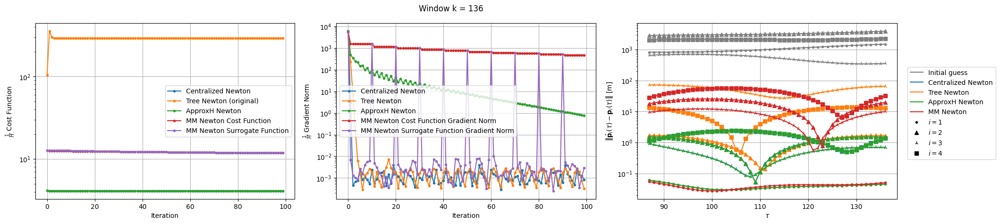


Windows:  25%|██▌       | 88/346 [4:14:36<14:04:14, 196.34s/it]

-------- Centralized Newton ---------------- Tree Newton --------
-------- ApproxH Newton ---------------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.0635262709489615
Gradient norm: 1176.9855138439505
Global relative error: 2.1210864986323337
Position relative errors: 0.05750981699294993 m, 1.5200432063914764 m, 0.846453449759201 m, 1.211890459951035 m

Before applying the algorithm
Cost function: 294.13656432205823
Gradient norm: 1249.4402191674344
Global relative error: 73.63384081198483
Position relative errors: 0.05751353015436853 m, 1.6848803836963473 m, 72.4429210561585 m, 13.081362463354228 m

Before applying the algorithm
L_norm = 4.063407603477214
Grad_L_norm = 1176.236524207313

Iteration 1
Cost function: 4.051269977385035 (-0.30%)
Gradient norm: 326.1143144156571 (-72.29%)
Global relative error: 2.59436854145541 (22.31%)
Position relative errors: 0.05370952533591911 m, 1.6535680850953043 m, 0.4589072533882668 m,

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Before applying the algorithm
Cost function: 26.974517661044718
Gradient norm: 2461.2275883914367
Global relative error: 33.39173347768202
Position relative errors: 0.0554307447383064 m, 1.6240817810501957 m, 21.90256830246068 m, 25.152401816630366 m

Before applying the algorithm
L_norm = 4.101330510722049
Grad_L_norm = 2525.7006899220946

Before applying the algorithm
Cost function: 4.1014093447878075
Gradient norm: 2525.743743464763
Global relative error: 5.673430422685138
Position relative errors: 0.05543416384696163 m, 2.054086828723425 m, 2.215303193156368 m, 4.801861461814641 m

Iteration 1
Cost function: 19.80061600330734 (-26.60%)
Gradient norm: 273.85507315987735 (-88.87%)
Global relative error: 19.31076565028457 (-42.17%)
Position relative errors: 0.05048999508292102 m, 1.5949272936387047 m, 7.646441274317519 m, 17.660418519831094 m

Iteration 1
L_norm = 4.076804905883303
Grad_L_norm = 0.4062304394154119

Before applying the algorithm
Cost function: 6.649940327680545
Gradien

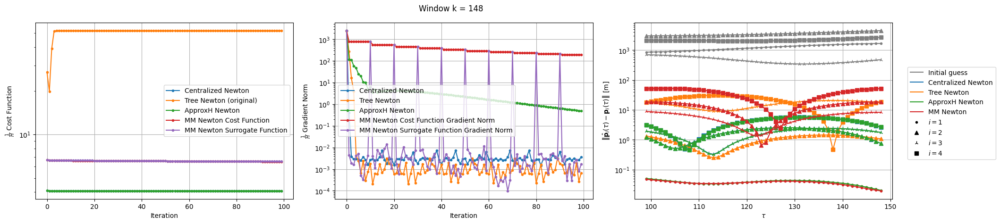


Windows:  29%|██▉       | 100/346 [4:52:26<12:28:00, 182.44s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.056994263578149
Grad_L_norm = 1549.054564371385

Before applying the algorithm
Cost function: 52.84137513219129
Gradient norm: 1731.1046363025494
Global relative error: 26.109378233218894
Position relative errors: 0.04863535557618137 m, 1.2526641878721345 m, 17.72044575351516 m, 19.13407805377802 m

Before applying the algorithm
Cost function: 4.056926971035386
Gradient norm: 1548.9905414290304
Global relative error: 3.514194986657867
Position relative errors: 0.048640963797211105 m, 1.057471497235546 m, 1.8278598914430266 m, 2.8085300562203854 m

Iteration 1
Cost function: 42.41485840509222 (-19.73%)
Gradient norm: 616.3755455518801 (-64.39%)
Global relative error: 33.207063078272405 (27.18%)
Position relative errors: 0.07758750380415637 m, 1.1446846413221043 m, 24.99168935163381 

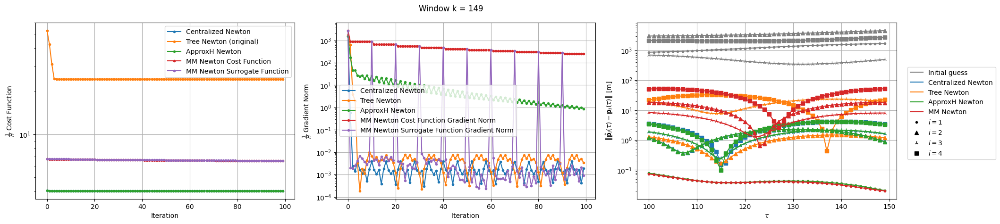


Windows:  29%|██▉       | 101/346 [4:55:17<12:11:56, 179.25s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.05682093976898
Gradient norm: 1487.3294311344857
Global relative error: 3.8963998116201157
Position relative errors: 0.07345694669759695 m, 1.0415993830984742 m, 1.8073801645902834 m, 3.2901315776931637 m

Before applying the algorithm
L_norm = 4.056806269070316
Grad_L_norm = 1488.24784712807

Before applying the algorithm
Cost function: 25.44768267274186
Gradient norm: 1263.4831453326096
Global relative error: 29.67844258658842
Position relative errors: 0.07346667446637539 m, 1.2256500702308544 m, 18.409705929889178 m, 23.24616281088222 m

Iteration 1
Cost function: 4.034341889676545 (-0.55%)
Gradient norm: 255.75341408721886 (-82.80%)
Global relative error: 3.079760056787269 (-20.96%)
Iteration 1
L_norm = 4.030382438649438
Grad_L_norm = 0.3586025609675855
Position relative 

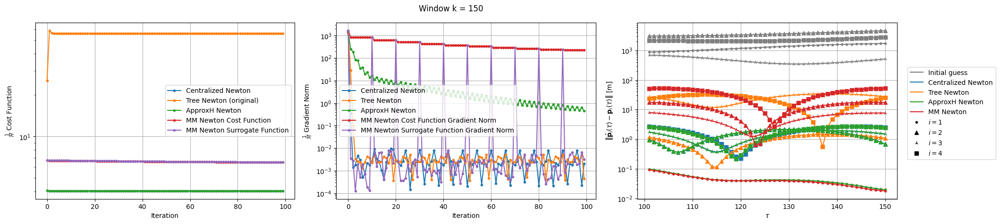


Windows:  29%|██▉       | 102/346 [4:58:12<12:02:58, 177.78s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 59.84549146158523
Gradient norm: 3759.511421842222
Global relative error: 35.638149292689455
Position relative errors: 0.09134853236773657 m, 1.081888334704275 m, 25.617315929070873 m, 24.751782676351972 m

Before applying the algorithm
Cost function: 4.062097272653639
Gradient norm: 3723.008139888539
Global relative error: 3.1227591466461986
Position relative errors: 0.09134337826309916 m, 0.8146845509968522 m, 1.6420630043920106 m, 2.5264970269461666 m
Before applying the algorithm
L_norm = 4.062256257336101
Grad_L_norm = 3722.6043009196283


Iteration 1
Cost function: 9.863757045371642 (-83.52%)
Gradient norm: 98.47260690718039 (-97.38%)
Global relative error: 27.473253528027275 (-22.91%)
Position relative errors: 0.11578042979507852 m, 1.2010761083959782 m, 9.65841238528922

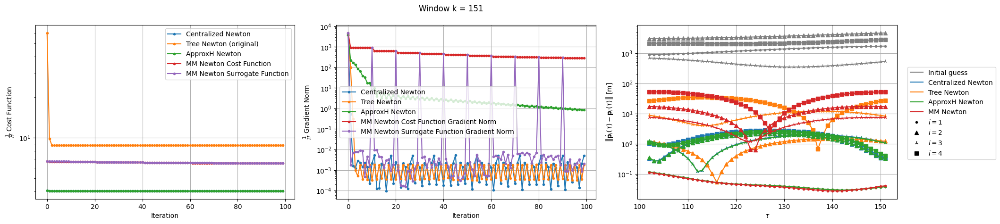


Windows:  30%|██▉       | 103/346 [5:01:00<11:48:23, 174.91s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8.949226334944356
Gradient norm: 2558.9635215112476
Global relative error: 28.290795889892458
Position relative errors: 0.10938945624739856 m, 1.1192564357436363 m, 8.239531691275532 m, 27.040966352299815 m

Before applying the algorithm
Cost function: 4.012311211393564
Gradient norm: 2429.467691695967
Global relative error: 1.515216715993606
Position relative errors: 0.10939918015338836 m, 0.26970312256600487 m, 1.1048420819762084 m, 0.9952287411561561 m

Before applying the algorithm
L_norm = 4.012263646106889
Grad_L_norm = 2431.19023096681

Iteration 1
Cost function: 6.969115184166452 (-22.13%)
Gradient norm: 11.730413245924437 (-99.54%)
Global relative error: 23.708889296492494 (-16.20%)
Position relative errors: 0.12150811964091665 m, 1.0958755034838887 m, 8.28913195470493

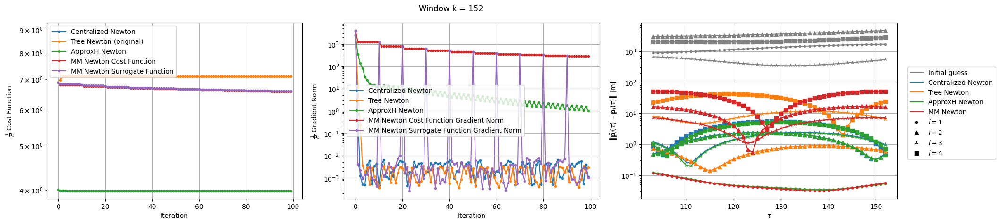


Windows:  30%|███       | 104/346 [5:03:54<11:43:54, 174.52s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 3.958357440255164
Gradient norm: 1034.0471845196566
Global relative error: 1.3435966505068366
Position relative errors: 0.11458725470256242 m, 0.49551158966883263 m, 1.0035463904809188 m, 0.734466155005018 m

Before applying the algorithm
Cost function: 6.9791929143977836
Gradient norm: 724.0926224824053
Global relative error: 25.60267849522247
Position relative errors: 0.11457221516178989 m, 0.6687433742791093 m, 7.744899591227148 m, 24.39367990652253 m

Before applying the algorithm
L_norm = 3.9575709628680587
Grad_L_norm = 1029.4207638082437

Iteration 1
Cost function: 18.217414469217534 (161.02%)
Gradient norm: 13.626512216623809 (-98.12%)
Global relative error: 24.881063487151103 (-2.82%)
Position relative errors: 0.13697909151549645 m, 1.4071397082394321 m, 11.54452258983

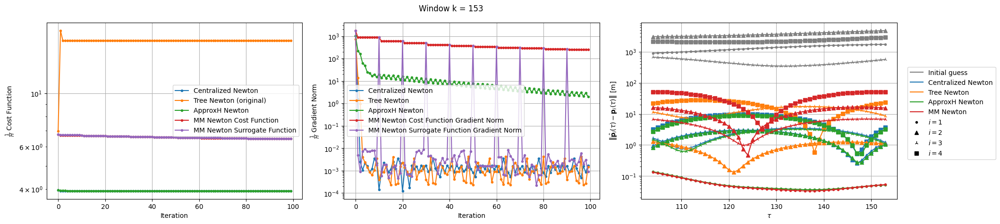


Windows:  30%|███       | 105/346 [5:06:44<11:36:14, 173.34s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 16.6579408066721
Gradient norm: 1304.30729707166
Global relative error: 25.441336170355047
Position relative errors: 0.12818917296751747 m, 1.22021353296246 m, 10.759396577228443 m, 23.021534006458086 m

Before applying the algorithm
Cost function: 3.9872704184545484
Gradient norm: 1352.4875078185455
Global relative error: 3.588553323769913
Position relative errors: 0.12821810134081443 m, 0.9927454851806675 m, 1.3177057835018855 m, 3.184223404948573 m

Before applying the algorithm
L_norm = 3.986723736235911
Grad_L_norm = 1363.600347571214

Iteration 1
Cost function: 41.848718493447 (151.22%)
Gradient norm: 29.368290634568176 (-97.75%)
Global relative error: 14.274038677909347 (-43.89%)
Position relative errors: 0.1217351076353784 m, 1.017194301773494 m, 12.536856299373133 m, 6

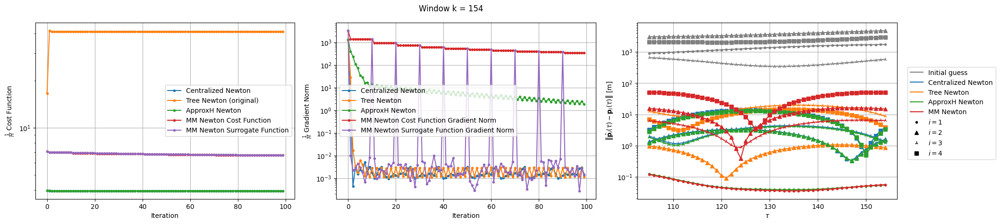


Windows:  31%|███       | 106/346 [5:09:34<11:29:30, 172.38s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 41.019418662074166
Gradient norm: 4146.2900460586925
Global relative error: 13.217748337306233
Position relative errors: 0.11362918298913843 m, 0.9232941401060127 m, 11.724395094870331 m, 6.031698980148029 m

Before applying the algorithm
L_norm = 4.062786449283523
Grad_L_norm = 4179.479924142933

Before applying the algorithm
Cost function: 4.063934970871458
Gradient norm: 4186.870455110068
Global relative error: 4.0309530161547045
Position relative errors: 0.11365754090532433 m, 1.4000485587167286 m, 1.6100873382987615 m, 3.4180296835460866 m

Iteration 1
Cost function: 27.681262721838813 (-32.52%)
Gradient norm: 11.92716037489468 (-99.71%)
Global relative error: 21.858916911560303 (65.38%)
Position relative errors: 0.12694389409623763 m, 0.8500222538141896 m, 11.721751587661

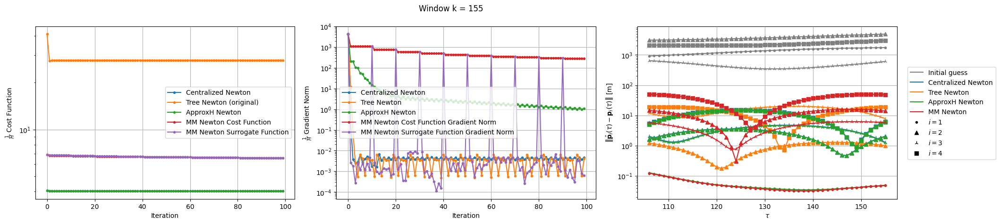


Windows:  31%|███       | 107/346 [5:12:26<11:25:29, 172.09s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 27.846270579253247
Gradient norm: 3818.0653377956755
Global relative error: 21.98737546676915
Position relative errors: 0.11827696960539577 m, 1.1568183754428296 m, 10.942588281805982 m, 19.035540292589076 m

Before applying the algorithm
Cost function: 4.169044978302955
Gradient norm: 3716.8637387049957
Global relative error: 6.3829086530740735
Position relative errors: 0.11829270560685384 m, 1.7754351308474086 m, 1.73107430455122 m, 5.880347065955041 m

Before applying the algorithm
L_norm = 4.169591462704555
Grad_L_norm = 3720.691857924387

Iteration 1
Cost function: 58.928820704171095 (111.62%)
Gradient norm: 24.30110930772717 (-99.36%)
Global relative error: 18.147790594693923 (-17.46%)
Position relative errors: 0.09820891203647368 m, 1.089910953547583 m, 12.36634052143289

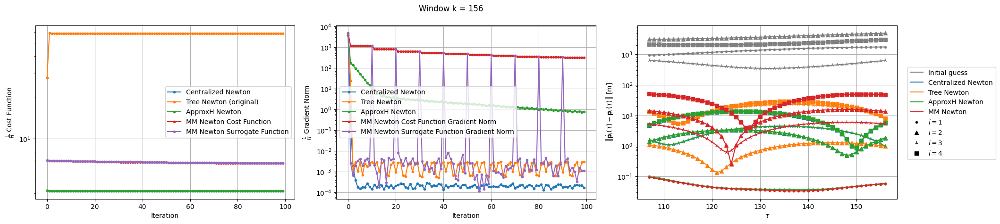


Windows:  31%|███       | 108/346 [5:15:14<11:18:15, 170.99s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 58.51837657254698
Gradient norm: 1539.3731164115072
Global relative error: 16.376431329447353Before applying the algorithm
Cost function: 4.22903029115168
Gradient norm: 1546.1403765644245
Global relative error: 5.971580005041458

Position relative errors: 0.09209757885157363 m, 1.027682996419679 m, 11.53785539841854 m, 11.575803116168727 m
Position relative errors: 0.09208783855841275 m, 1.5692075621448383 m, 1.427539273777677 m, 5.581288258865803 m


Before applying the algorithm
L_norm = 4.228434944347418
Grad_L_norm = 1542.0869089922671

Iteration 1
Cost function: 133.589000388712 (128.29%)
Gradient norm: 177.56339861365015 (-88.47%)
Global relative error: 31.905001940227947 (94.82%)
Position relative errors: 0.08573299721099835 m, 1.003515473418967 m, 9.396719104718468 m, 

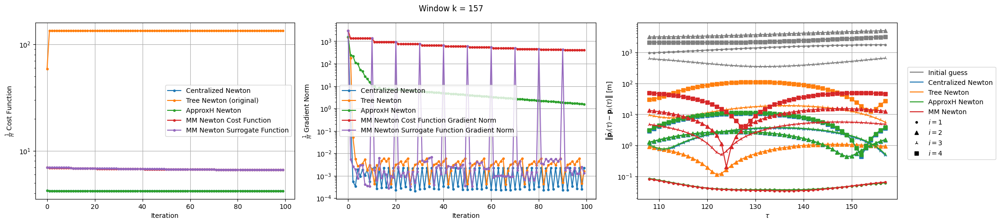


Windows:  32%|███▏      | 109/346 [5:18:05<11:15:00, 170.89s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.266414868847108
Grad_L_norm = 761.1323511328777

Before applying the algorithm
Cost function: 4.2657628884252095
Gradient norm: 747.0622719733633
Global relative error: 4.1076630180063205
Position relative errors: 0.0804689527435053 m, 1.400145197779298 m, 0.897824266800443 m, 3.7549644766480466 m

Before applying the algorithm
Cost function: 132.17606227418008
Gradient norm: 486.43696793060985
Global relative error: 32.63313151649801
Position relative errors: 0.08049325865226778 m, 0.850848075625427 m, 8.80086783010712 m, 31.412095536148044 m

Iteration 1
Cost function: 4.253325507466091 (-0.29%)
Gradient norm: 500.85635123237637 (-32.96%)
Global relative error: 3.9957598826314342 (-2.72%)
Position relative errors: 0.08323551516407052 m, 1.3604461407309685 m, 1.1847607630744024 m,

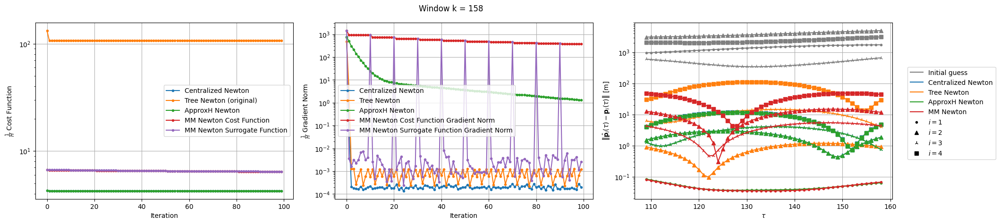


Windows:  32%|███▏      | 110/346 [5:20:55<11:10:56, 170.58s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.376603881087779
Grad_L_norm = 5399.333754836946

Before applying the algorithm
Cost function: 105.60799313950228
Gradient norm: 5702.877517731512
Global relative error: 32.70346187351004Before applying the algorithm
Cost function: 4.376429439185408
Gradient norm: 5399.607759379285
Global relative error: 5.0207894977188765

Position relative errors: 0.0776439991419856 m, 0.8383189423565581 m, 5.869927296215938 m, 32.161089485172994 m
Position relative errors: 0.07764919256932055 m, 1.64945932227502 m, 1.1095825953226324 m, 4.609797937463852 m


Iteration 1
L_norm = 4.3357999464484624
Grad_L_norm = 2.197174869421975

Iteration 1
Cost function: 4.345775370099277 (-0.70%)
Gradient norm: 285.1919389110761 (-94.72%)
Global relative error: 5.733117622847461 (14.19%)
Position relative erro

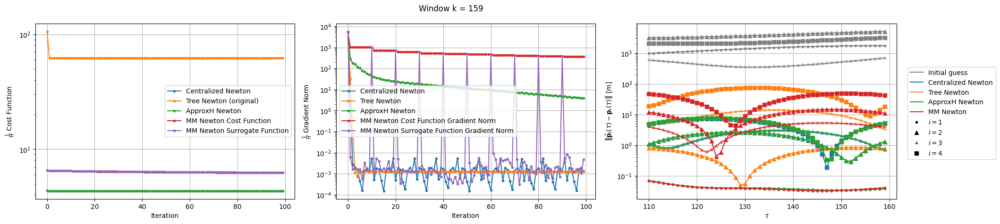


Windows:  32%|███▏      | 111/346 [5:23:46<11:08:34, 170.70s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 61.501158126200345
Gradient norm: 2905.1822543926583
Global relative error: 20.586026160799513
Position relative errors: 0.0652636028403206 m, 0.7869770830871541 m, 5.292662788412197 m, 19.87816684540383 m

Before applying the algorithm
L_norm = 4.413862256589104
Grad_L_norm = 2700.98532453723

Before applying the algorithm
Cost function: 4.414431724882714
Gradient norm: 2699.1581114398805
Global relative error: 5.417570093260435
Position relative errors: 0.06524282296331037 m, 1.2232185615708888 m, 0.971689517167819 m, 5.187032745971609 m

Iteration 1
Cost function: 27.829866974971786 (-54.75%)
Gradient norm: 17.265438359455146 (-99.41%)
Global relative error: 26.321096094583822 (27.86%)
Position relative errors: 0.04553393021245533 m, 1.2101942591485235 m, 1.4665050643440165 

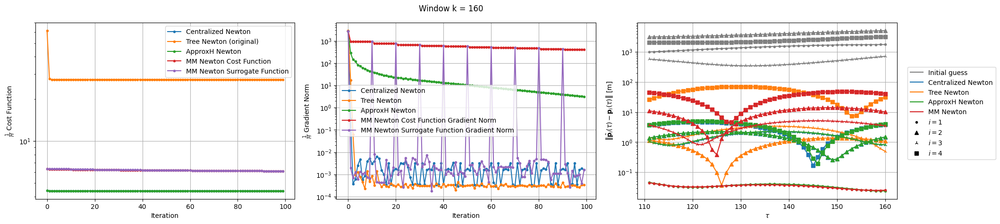


Windows:  32%|███▏      | 112/346 [5:26:37<11:06:47, 170.97s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 27.28873918910548
Gradient norm: 1208.260798914213
Global relative error: 29.633735641904387
Position relative errors: 0.04268255470025779 m, 1.0999757594087347 m, 1.3307291979043758 m, 29.583278586770227 m

Before applying the algorithm
L_norm = 4.550606645449052
Grad_L_norm = 1663.1105139309134

Before applying the algorithm
Cost function: 4.551445152128562
Gradient norm: 1666.9624040920255
Global relative error: 4.326529545419848
Position relative errors: 0.04266986064453766 m, 1.4767907244352645 m, 0.9611631621694947 m, 3.9512364650183027 m

Iteration 1
Cost function: 7.56117938109912 (-72.29%)
Gradient norm: 14.939840537934286 (-98.76%)
Global relative error: 20.52207349828281 (-30.75%)
Position relative errors: 0.036522614039155396 m, 1.4124040853456499 m, 2.2025121335792

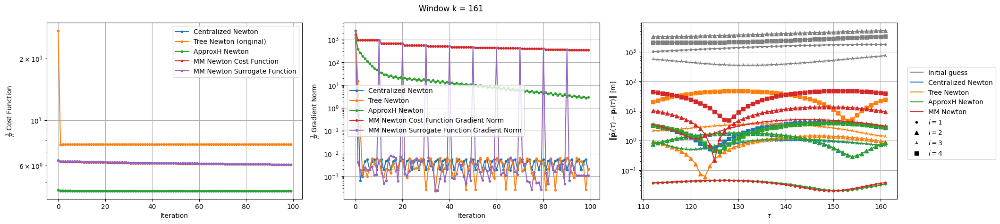


Windows:  33%|███▎      | 113/346 [5:29:31<11:07:24, 171.87s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.563597464351247
Gradient norm: 2579.0380541172212
Global relative error: 3.24611760669157
Position relative errors: 0.03687939983170467 m, 0.833731964329463 m, 0.836170026738053 m, 3.0235101107155464 m

Before applying the algorithm
Cost function: 7.6818097960104375
Gradient norm: 2804.683062750026
Global relative error: 22.727150781578786
Position relative errors: 0.03689599759943621 m, 0.8429479705596242 m, 2.165893550037025 m, 22.607923168079964 m

Before applying the algorithm
L_norm = 4.563134887864887
Grad_L_norm = 2580.810505387349

Iteration 1
Cost function: 4.550762472008789 (-0.28%)
Gradient norm: 174.4108291229071 (-93.24%)
Global relative error: 4.663244775924441 (43.66%)
Position relative errors: 0.028294989063940068 m, 0.8524468343468738 m, 0.8524323235329381 m,

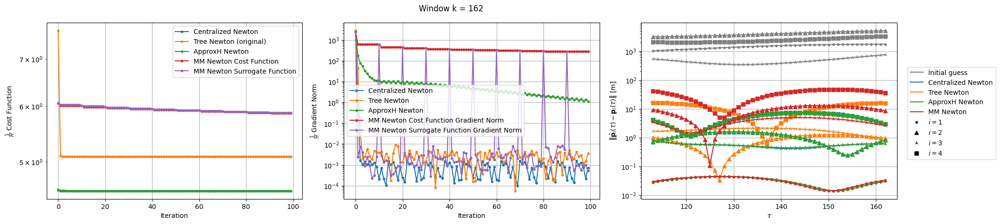


Windows:  33%|███▎      | 114/346 [5:32:23<11:03:55, 171.71s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.061413843419352
Gradient norm: 650.8230335795834
Global relative error: 16.466347470790403
Position relative errors: 0.030178162985017198 m, 0.9542534409636392 m, 1.688198022604903 m, 16.351729097585753 m

Before applying the algorithm
L_norm = 4.503654321319363
Grad_L_norm = 864.6114692323196

Before applying the algorithm
Cost function: 4.503728796755226
Gradient norm: 864.7452478980849
Global relative error: 3.8090066515898306
Position relative errors: 0.030176068597283768 m, 0.7950256750272016 m, 0.7611834810662346 m, 3.6463805633115074 m

Iteration 1
Cost function: 15.59922676187916 (208.20%)
Gradient norm: 9.121212593687984 (-98.60%)
Global relative error: 9.627938096361028 (-41.53%)
Position relative errors: 0.056057451531224024 m, 1.0961575277936895 m, 4.8316568230746

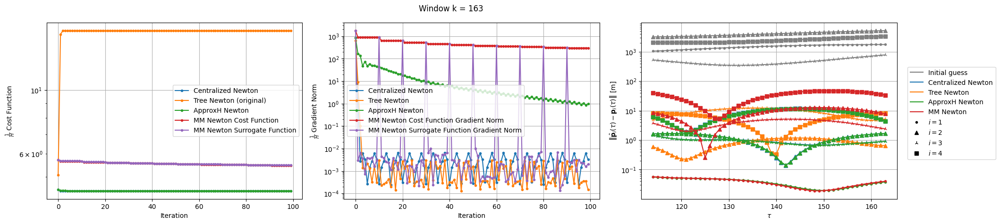


Windows:  33%|███▎      | 115/346 [5:35:11<10:57:39, 170.82s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 15.968904205355061
Gradient norm: 1269.0297367417695
Global relative error: 9.64439963188958
Position relative errors: 0.05467845124982276 m, 0.5155815690324681 m, 5.214385055617822 m, 8.096644031996135 m

Before applying the algorithm
Cost function: 4.4102639362531635
Gradient norm: 1296.5412691574843
Global relative error: 5.803440949680534
Position relative errors: 0.054676766499704176 m, 1.6417979058598435 m, 1.351289513046561 m, 5.39956418989749 m

Before applying the algorithm
L_norm = 4.410326319073466
Grad_L_norm = 1296.341615718376

Iteration 1
Cost function: 69.80368016972658 (337.12%)
Gradient norm: 37.73257044680355 (-97.03%)
Global relative error: 16.611781972058218 (72.24%)
Position relative errors: 0.061233051526834614 m, 0.7653149973273811 m, 9.565138046001518 m

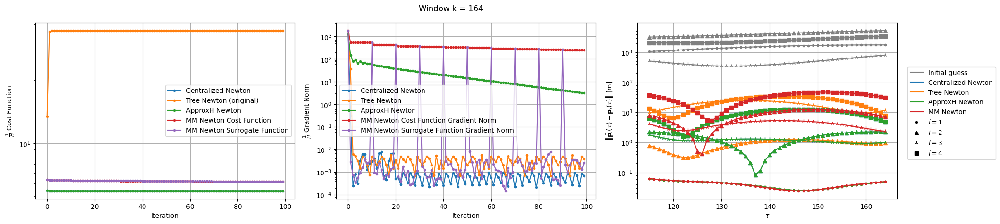


Windows:  34%|███▎      | 116/346 [5:38:01<10:53:10, 170.39s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 71.14379673212227
Gradient norm: 2065.759217953098
Global relative error: 15.45465987113025
Position relative errors: 0.058948532954176534 m, 0.6844150745085806 m, 10.53957509087472 m, 11.282274574094624 m

Before applying the algorithm
L_norm = 4.361248717934291
Grad_L_norm = 2126.5465710252506

Before applying the algorithm
Cost function: 4.361248031069976
Gradient norm: 2126.8319283548194
Global relative error: 6.226411844969389
Position relative errors: 0.05894895491950982 m, 2.197992323606022 m, 1.6171742730887517 m, 5.596259563983587 m

Iteration 1
Cost function: 87.20627495959167 (22.58%)
Gradient norm: 15.719952405006477 (-99.24%)
Global relative error: 24.77949854477531 (60.34%)
Position relative errors: 0.07365347072499771 m, 0.520080311484791 m, 11.462890706859556 m,

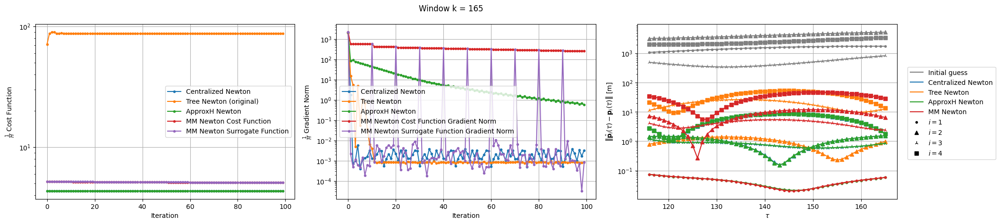


Windows:  34%|███▍      | 117/346 [5:40:50<10:48:54, 170.02s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 86.52377974987002
Gradient norm: 3366.2819169920344
Global relative error: 22.220877893611597
Position relative errors: 0.07054352261103049 m, 0.8501284678668235 m, 12.503277966217473 m, 18.34947980849759 m

Before applying the algorithm
Cost function: 4.360972203467281
Gradient norm: 3203.8520288094473
Global relative error: 2.919195430012942
Position relative errors: 0.07054483080613197 m, 1.4577947577247208 m, 1.1054918957203304 m, 2.273621096458427 m

Before applying the algorithm
L_norm = 4.360986003464925
Grad_L_norm = 3204.1904493107186

Iteration 1
Cost function: 70.20923921435953 (-18.86%)
Gradient norm: 793.7881299028664 (-76.42%)
Global relative error: 11.353901396278493 (-48.90%)
Position relative errors: 0.07933475737404097 m, 2.2744487632160526 m, 10.2544636676424

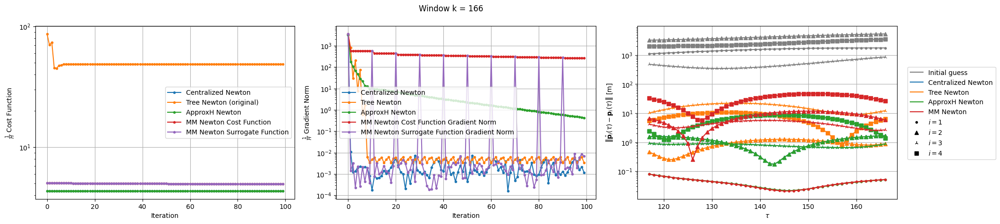


Windows:  34%|███▍      | 118/346 [5:43:40<10:46:04, 170.02s/it]

-------- Centralized Newton --------
-------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------


Majorization-Minimization Iteration 1

Before applying the algorithm
Cost function: 48.196401464195105
Gradient norm: 1368.9700429545119
Global relative error: 12.681801363004368
Position relative errors: 0.07481819643118529 m, 0.38711131841157176 m, 11.177402007107105 m, 5.97810435503885 m

Before applying the algorithm
L_norm = 4.274277718097168
Grad_L_norm = 1504.3488766524815

Before applying the algorithm
Cost function: 4.274273861179953
Gradient norm: 1504.328396914036
Global relative error: 2.613188247870432
Position relative errors: 0.07481821638162194 m, 1.5639884919586204 m, 0.8866042925525804 m, 1.894976027668366 m

Iteration 1
Cost function: 59.20691789878119 (22.85%)
Gradient norm: 109.13885905026156 (-92.03%)
Global relative error: 28.773630350542707 (126.89%)
Position relative errors: 0.05408082258686086 m, 0.2057465146369296 m, 12.0684169810789

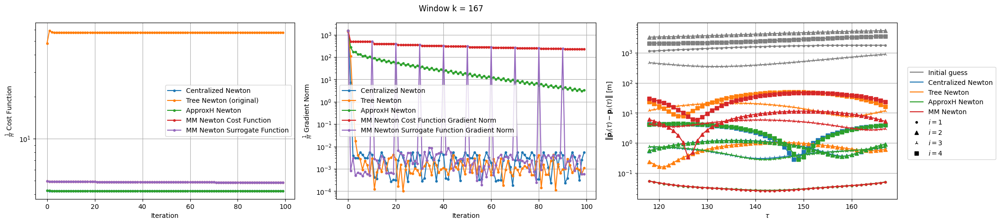


Windows:  34%|███▍      | 119/346 [5:46:30<10:43:45, 170.16s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 56.52099843894117
Gradient norm: 1322.5905644943268
Global relative error: 23.71199027002393
Position relative errors: 0.05042756020528063 m, 0.19492226506134158 m, 12.893688446818073 m, 19.898927958724958 m

Before applying the algorithm
L_norm = 4.242753420564323
Grad_L_norm = 1689.3413942641148

Before applying the algorithm
Cost function: 4.2430015468207545
Gradient norm: 1689.609966207704
Global relative error: 4.308713880427319
Position relative errors: 0.05042548282656392 m, 0.6178652900992948 m, 0.7506426353025657 m, 4.197289702248315 m

Iteration 1
Cost function: 55.81224526760852 (-1.25%)
Gradient norm: 532.6259562024568 (-59.73%)
Global relative error: 90.02036571054543 (279.64%)
Position relative errors: 0.049483466215075676 m, 0.22021103382496374 m, 7.3560851926100

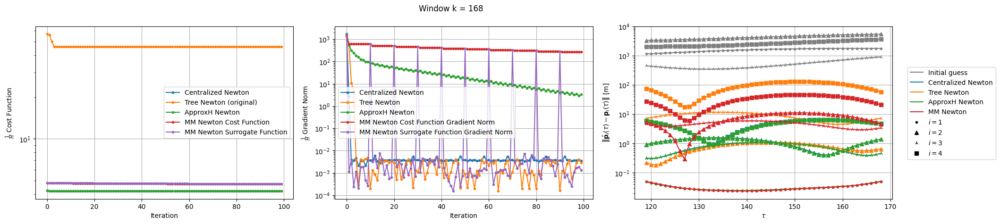


Windows:  35%|███▍      | 120/346 [5:49:21<10:41:54, 170.42s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.244386243159985
Gradient norm: 2076.4256333294857
Global relative error: 5.689191936663592
Position relative errors: 0.04558248166741416 m, 1.0072902102786423 m, 0.31074646425116625 m, 5.590490515852012 m

Before applying the algorithm
L_norm = 4.244576766536648
Grad_L_norm = 2076.2087352027365

Before applying the algorithm
Cost function: 46.26127095653144
Gradient norm: 1852.1902218972252
Global relative error: 67.11694305179653
Position relative errors: 0.04558454953604143 m, 0.19360594270490306 m, 7.741146383506729 m, 66.6685843398422 m

Iteration 1
Cost function: 4.232368555839999 (-0.28%)
Gradient norm: 457.87945681228115 (-77.95%)
Global relative error: 4.030143728950534 (-29.16%)
Position relative errors: 0.044861680618778904 m, 0.8293799385575747 m, 0.366910089323166

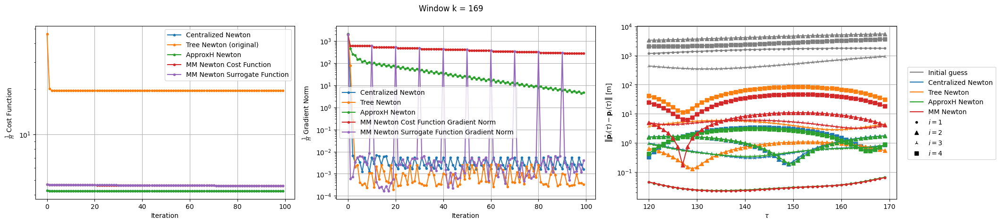


Windows:  35%|███▍      | 121/346 [5:52:11<10:37:42, 170.06s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 19.56955424099309
Gradient norm: 1308.0682552875014
Global relative error: 37.11963370456795
Position relative errors: 0.041279348950153755 m, 0.5877259329129618 m, 3.917736130344315 m, 36.907494330163686 m

Before applying the algorithm
Cost function: 4.294923429114214
Gradient norm: 1308.463320629993
Global relative error: 1.9115986918418213
Position relative errors: 0.0412888600050413 m, 1.6010865153629708 m, 0.8630113345064347 m, 0.5867072785590578 m

Before applying the algorithm
L_norm = 4.295510461543255
Grad_L_norm = 1308.9864521310199

Iteration 1
Cost function: 10.47382621896385 (-46.48%)
Gradient norm: 8.596448039845132 (-99.34%)
Global relative error: 28.277456253560437 (-23.82%)
Position relative errors: 0.03226507495056906 m, 0.7554715920485853 m, 1.41338888872784

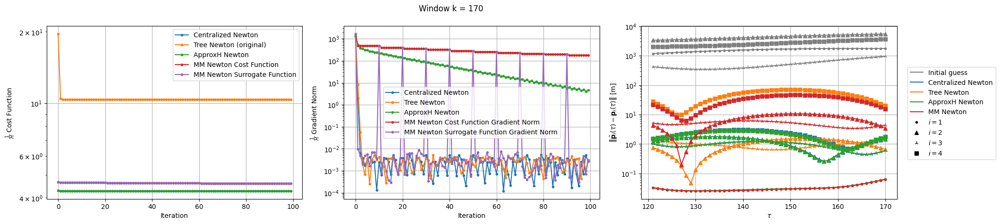


Windows:  35%|███▌      | 122/346 [5:55:07<10:41:32, 171.84s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.2880598009729
Grad_L_norm = 1909.4053500004013

Before applying the algorithm
Cost function: 10.447926718575552
Gradient norm: 1981.279074033244
Global relative error: 23.639540980981163
Position relative errors: 0.030402801859906837 m, 0.662266915318233 m, 1.3190292943891078 m, 23.593272056283137 m

Before applying the algorithm
Cost function: 4.288121599405503
Gradient norm: 1909.8136985319788
Global relative error: 2.281103711549948
Position relative errors: 0.030399652188813957 m, 1.2980475192535434 m, 0.9570892758129496 m, 1.6129312385966101 m

Iteration 1
Cost function: 21.66756588742814 (107.39%)
Gradient norm: 170.02245024120467 (-91.42%)
Global relative error: 64.7301514640972 (173.82%)
Position relative errors: 0.03071670542286046 m, 0.6996128816117231 m, 7.02455218711652

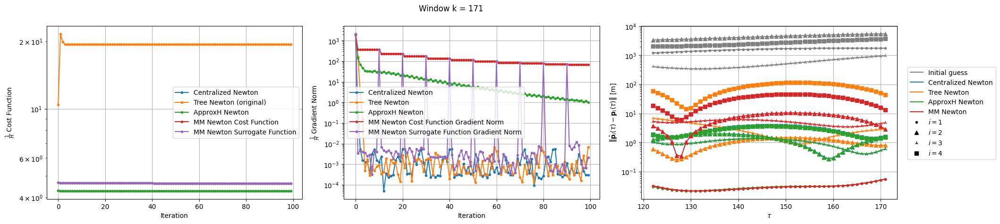


Windows:  36%|███▌      | 123/346 [5:57:54<10:33:46, 170.52s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 19.71364065262127
Gradient norm: 2205.9818807903616
Global relative error: 51.521989765020905
Position relative errors: 0.028426230455615223 m, 0.49839982753731776 m, 6.593958082074438 m, 51.09569647879705 m

Before applying the algorithm
L_norm = 4.289032238129026
Grad_L_norm = 2151.274274651365

Before applying the algorithm
Cost function: 4.288883052554046
Gradient norm: 2151.070392393086
Global relative error: 2.3718833030051307
Position relative errors: 0.028424820669092736 m, 1.3424408274425286 m, 0.9725012641072365 m, 1.6961976100761325 m

Iteration 1
Cost function: 16.183631115324307 (-17.91%)
Gradient norm: 268.0873487577838 (-87.85%)
Global relative error: 15.98649685144765 (-68.97%)
Position relative errors: 0.012502518826308397 m, 0.462503247997467 m, 12.56722826910

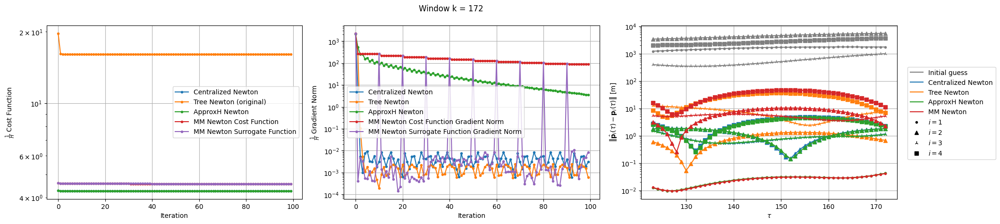


Windows:  36%|███▌      | 124/346 [6:00:43<10:29:42, 170.19s/it]

-------- ApproxH Newton ---------------- Centralized Newton ---------------- Tree Newton --------

-------- MM Newton --------


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 14.908424451968918
Gradient norm: 4108.114357701175
Global relative error: 13.866425712338545
Position relative errors: 0.01117305433312427 m, 0.5245831740061894 m, 12.18003491310667 m, 6.606617211315032 m

Before applying the algorithm
Cost function: 4.29045742007035
Gradient norm: 4145.032431090444
Global relative error: 3.2285914350288585
Position relative errors: 0.011179982395973941 m, 1.7812284189997416 m, 1.3522961786836967 m, 2.3285562093384056 m

Before applying the algorithm
L_norm = 4.290793114947611
Grad_L_norm = 4146.43336516649

Iteration 1
Cost function: 44.12354389952055 (195.96%)
Gradient norm: 116.37833871444784 (-97.17%)
Global relative error: 35.55503757892348 (156.41%)
Position relative errors: 0.025443322173210072 m, 0.5229233228172078 m, 26.51927492593071

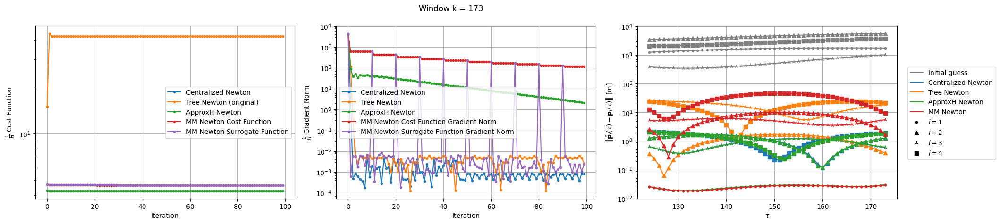


Windows:  36%|███▌      | 125/346 [6:03:35<10:28:34, 170.65s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 36.65683372311228
Gradient norm: 1726.379483799325
Global relative error: 34.60552269538035
Position relative errors: 0.023644173089674685 m, 0.2489620536576426 m, 25.67019179455063 m, 23.206036411259998 m

Before applying the algorithm
Cost function: 4.271346765109004
Gradient norm: 1588.8217127345038
Global relative error: 2.4929167819106395
Position relative errors: 0.023640595759806166 m, 1.3245320743408302 m, 0.5788060591197199 m, 2.030927678897015 m

Before applying the algorithm
L_norm = 4.271513698333181
Grad_L_norm = 1590.7132865885744

Iteration 1
Cost function: 68.00376083531246 (85.51%)
Gradient norm: 96.60545158633711 (-94.40%)
Global relative error: 54.7118981212695 (58.10%)
Position relative errors: 0.010407751738949915 m, 0.1901746171128287 m, 36.19883859420666 

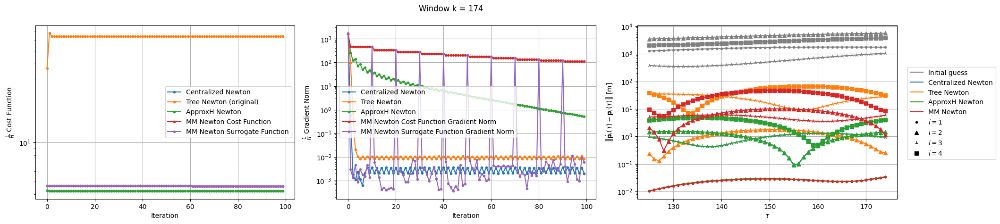


Windows:  36%|███▋      | 126/346 [6:06:24<10:23:48, 170.13s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 55.77196653100641
Gradient norm: 861.0996318457477
Global relative error: 49.0461083188764
Position relative errors: 0.011515324337539648 m, 0.1524229698991844 m, 35.152646812755286 m, 34.2020929557747 m

Before applying the algorithm
L_norm = 4.372700704100959
Grad_L_norm = 603.9061968667185

Before applying the algorithm
Cost function: 4.372728200991862
Gradient norm: 603.5656293276129
Global relative error: 4.4070655141790365
Position relative errors: 0.01151476026482908 m, 1.451810945809662 m, 0.9029807235151296 m, 4.061889895060636 m

Iteration 1
Cost function: 192.44316857449834 (245.05%)
Gradient norm: 114.27257776944535 (-86.73%)
Global relative error: 61.71789947457486 (25.84%)
Position relative errors: 0.012212424225443127 m, 0.11713140321041066 m, 59.671797645317305 

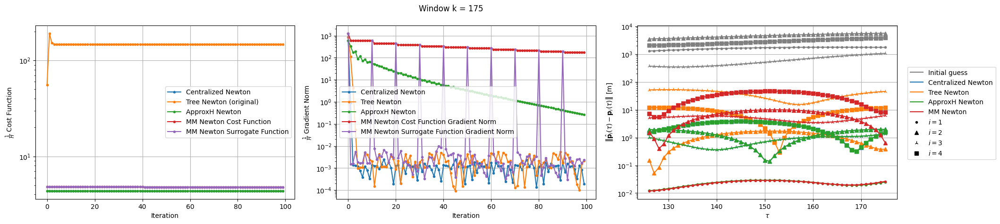


Windows:  37%|███▋      | 127/346 [6:09:13<10:19:49, 169.82s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 134.0718042893537
Gradient norm: 2994.9176236229673
Global relative error: 53.43499660219278
Position relative errors: 0.012534240395934065 m, 0.05209436675629202 m, 52.060327889165315 m, 12.042299738789776 m

Before applying the algorithm
Cost function: 4.320592578903337
Gradient norm: 2946.012817605645
Global relative error: 2.68175431205045
Position relative errors: 0.012533818044162199 m, 1.9167230805124773 m, 0.9184749968140441 m, 1.6353002893425623 m

Before applying the algorithm
L_norm = 4.3206154245610175
Grad_L_norm = 2945.9198939806774

Iteration 1
Cost function: 20.879991445506757 (-84.43%)
Gradient norm: 126.80662855366602 (-95.77%)
Global relative error: 34.60909426187345 (-35.23%)
Position relative errors: 0.017318128355009618 m, 0.19291228592655352 m, 16.7758795

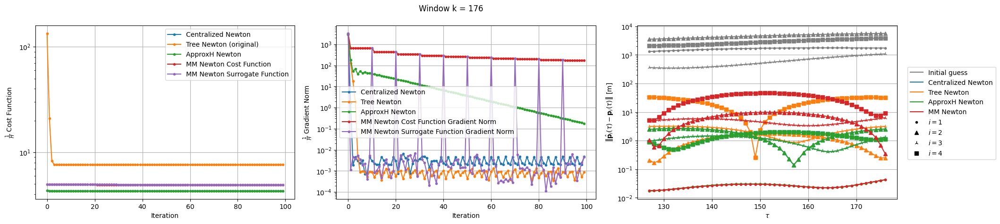


Windows:  37%|███▋      | 128/346 [6:12:03<10:17:21, 169.91s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7.633976078046908
Gradient norm: 658.9097550726154
Global relative error: 33.08611205202264
Position relative errors: 0.017685226529628863 m, 0.16642836125302962 m, 3.177630770229194 m, 32.93273862334744 m

Before applying the algorithm
Cost function: 4.281167823477735
Gradient norm: 901.4645665378915
Global relative error: 2.8451047671249907
Position relative errors: 0.01768605211996741 m, 2.5401283382769333 m, 1.0126209802580046 m, 0.7852680522721073 m

Before applying the algorithm
L_norm = 4.2811551870512305
Grad_L_norm = 901.2577706029787

Iteration 1
Cost function: 5.761221511255258 (-24.53%)
Gradient norm: 30.591121120157137 (-95.36%)
Global relative error: 23.608041139642047 (-28.65%)
Position relative errors: 0.018620263890125954 m, 0.24264210611672896 m, 1.84801222358

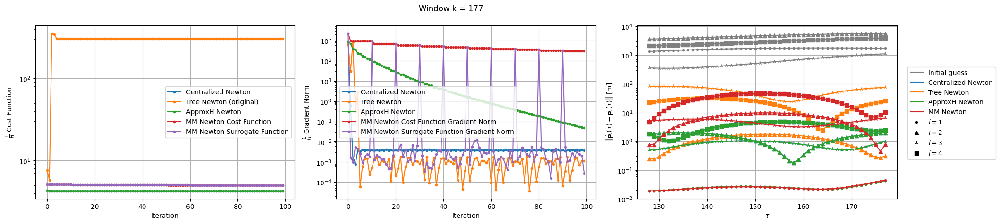


Windows:  37%|███▋      | 129/346 [6:14:52<10:13:02, 169.50s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 280.8811225459916
Gradient norm: 4530.349399071932
Global relative error: 85.18384612249328
Position relative errors: 0.01882601651437654 m, 0.24195296707337294 m, 81.79763688643786 m, 23.77756939507455 m

Before applying the algorithm
Cost function: 4.274988619391707
Gradient norm: 4457.1636914492
Global relative error: 2.4712701942818573Before applying the algorithm
L_norm = 4.274985973082832
Grad_L_norm = 4457.151733632005


Position relative errors: 0.018825860924734532 m, 1.8891266115148053 m, 0.5054281445227078 m, 1.5108047849582 m

Iteration 1
Cost function: 330.07701202073315 (17.51%)
Gradient norm: 22.039638439476697 (-99.51%)
Global relative error: 96.37157886201898 (13.13%)
Position relative errors: 0.020043451346125226 m, 0.25515960538915916 m, 90.73454693299838 m, 

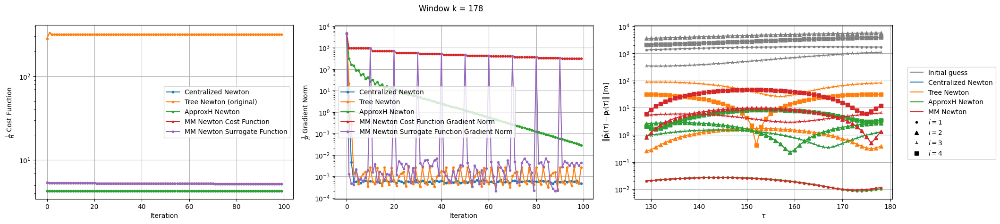


Windows:  38%|███▊      | 130/346 [6:17:46<10:14:57, 170.82s/it]

-------- ApproxH Newton ---------------- Centralized Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.25587772672894
Gradient norm: 624.8632374083296
Global relative error: 3.3237433569931265
Position relative errors: 0.020798207630352165 m, 2.6472960639000083 m, 0.972277410882599 m, 1.7587608504621677 m

Before applying the algorithm
L_norm = 4.255874441723105
Grad_L_norm = 624.8614040380388

Before applying the algorithm
Cost function: 292.14910604245034
Gradient norm: 505.79217588320944
Global relative error: 94.57224586149948
Position relative errors: 0.020798328117204067 m, 0.28204455571866954 m, 89.28457308079413 m, 31.178401244366515 m

Iteration 1
Cost function: 4.242980797624177 (-0.30%)
Gradient norm: 148.71072854902067 (-76.20%)
Global relative error: 3.5017889082128066 (5.36%)
Position relative errors: 0.02216698738031179 m, 2.5376827272272955 m, 1.413024853476154

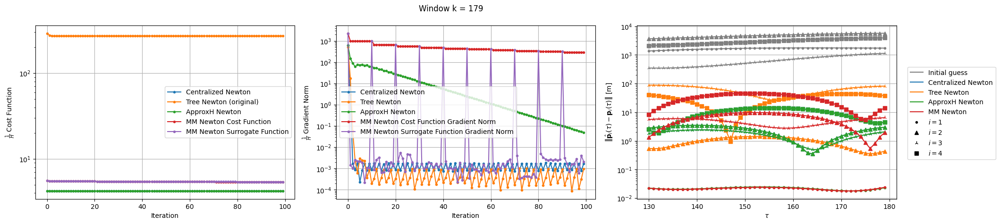


Windows:  38%|███▊      | 131/346 [6:20:39<10:15:12, 171.68s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.4293946400725765
Gradient norm: 1474.9544451154115
Global relative error: 4.007036904024946
Position relative errors: 0.02162300894438307 m, 2.908087102465459 m, 1.9210917618361403 m, 1.9768781713798333 m
Before applying the algorithm
L_norm = 4.429401406895049
Grad_L_norm = 1474.9923060403826


Before applying the algorithm
Cost function: 247.96829552234615
Gradient norm: 884.8726338099029
Global relative error: 96.09343810098433
Position relative errors: 0.021622840183329738 m, 0.5309567078099673 m, 87.88136170158364 m, 38.865541456320756 m

Iteration 1
Cost function: 4.380321574460302 (-1.11%)
Gradient norm: 1083.0793184276579 (-26.57%)
Global relative error: 4.370390874777076 (9.07%)
Position relative errors: 0.03287140217659714 m, 2.526935592114114 m, 2.262711327947409 m

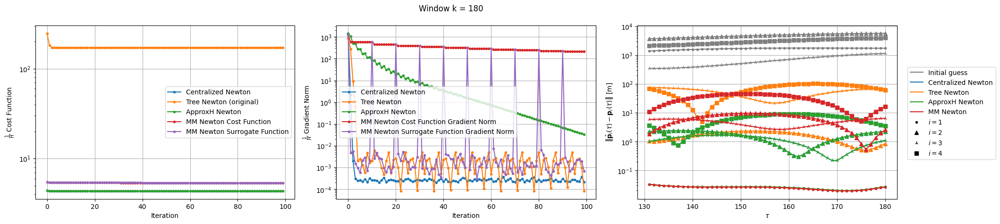


Windows:  38%|███▊      | 132/346 [6:23:32<10:12:45, 171.80s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 154.85628597482943
Gradient norm: 972.3242384984923
Global relative error: 97.47599631724005
Position relative errors: 0.03164953142450201 m, 1.0230109651819925 m, 74.65345091316131 m, 62.668769220239575 m

Before applying the algorithm
Cost function: 4.350580041286218
Gradient norm: 1511.490166445052
Global relative error: 3.935308910829406
Position relative errors: 0.03164956556320795 m, 2.266152925261267 m, 1.0873902668183186 m, 3.027818823287024 m

Before applying the algorithm
L_norm = 4.350581188721356
Grad_L_norm = 1511.482475695177

Iteration 1
Cost function: 64.98831791781522 (-58.03%)
Gradient norm: 104.09760495865939 (-89.29%)
Global relative error: 73.29870261172178 (-24.80%)
Position relative errors: 0.020049368217161474 m, 0.8759143213187938 m, 46.69489251405835 m

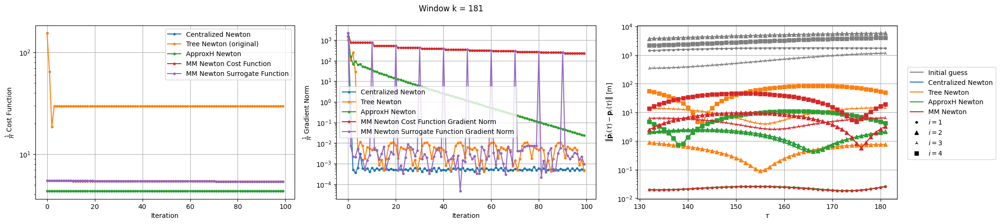


Windows:  38%|███▊      | 133/346 [6:26:25<10:12:05, 172.42s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.389559892249877
Grad_L_norm = 3275.595944472106

Before applying the algorithm
Cost function: 29.84830106582284
Gradient norm: 3844.591040879147
Global relative error: 53.01730536987436
Position relative errors: 0.01981891465326763 m, 0.8429900927311562 m, 13.692102426645112 m, 51.21175397500151 m

Before applying the algorithm
Cost function: 4.389557731121825
Gradient norm: 3275.5969018325677
Global relative error: 4.8923786142911725
Position relative errors: 0.01981777118852132 m, 2.1088663061380255 m, 1.9528970333517186 m, 3.9590036847618104 m

Iteration 1
L_norm = 4.37159198164025
Grad_L_norm = 1.442201633740465

Iteration 1
Cost function: 21.085929208421703 (-29.36%)
Gradient norm: 27.001061547534675 (-99.30%)
Global relative error: 43.92256197266543 (-17.15%)
Position relativ

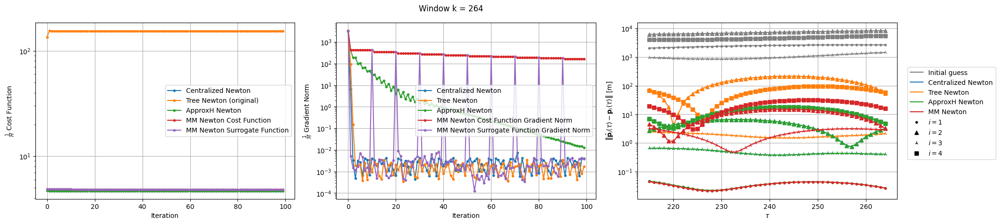


Windows:  62%|██████▏   | 216/346 [10:01:18<5:31:40, 153.08s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 151.2952571287473
Gradient norm: 2504.7026618838363
Global relative error: 85.65221339734691
Position relative errors: 0.04376516427239233 m, 59.73844494482609 m, 2.4743321720556484 m, 61.33055121420058 m

Before applying the algorithm
Cost function: 4.674603113575371
Gradient norm: 2502.204778723231
Global relative error: 6.522169479239841
Position relative errors: 0.04376571433859053 m, 3.026258850873676 m, 0.6515068234762941 m, 5.740522828601289 m

Before applying the algorithm
L_norm = 4.674603577147067
Grad_L_norm = 2502.215352551164

Before applying the algorithm
Cost function: 4.77873886306431
Gradient norm: 2653.906916022358
Global relative error: 18.085989074324505
Position relative errors: 0.041698344226537336 m, 3.631620881129129 m, 3.077747662262894 m, 17.4481751086

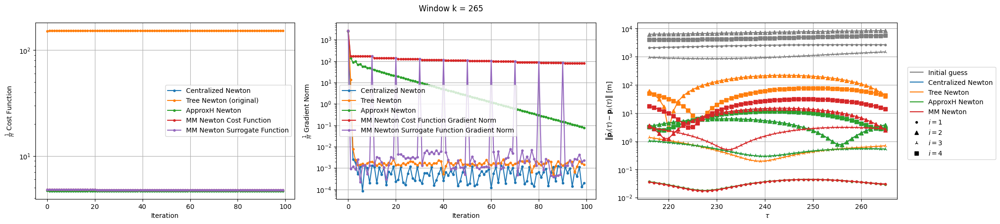


Windows:  63%|██████▎   | 217/346 [10:03:49<5:27:31, 152.34s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 151.15777425092833
Gradient norm: 2041.4176627266168
Global relative error: 64.80464059869323
Position relative errors: 0.03477921128392169 m, 45.66730136475848 m, 1.2950263773344612 m, 45.960848246790896 m

Before applying the algorithm
Cost function: 4.767662842221973
Gradient norm: 1988.296279709744
Global relative error: 4.669327587951742
Position relative errors: 0.03477898129737661 m, 3.6235849742437893 m, 1.0108663054070675 m, 2.765677705819785 m

Before applying the algorithm
L_norm = 4.7676654820931015
Grad_L_norm = 1988.2730336725265

Iteration 1
Cost function: 149.8300474304543 (-0.88%)
Gradient norm: 850.7459288745042 (-58.33%)
Global relative error: 61.73634700639656 (-4.73%)
Position relative errors: 0.04153091907615017 m, 27.388954128107464 m, 2.713582901124113 m

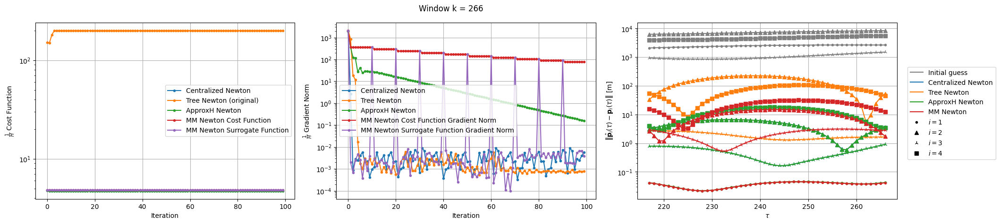


Windows:  63%|██████▎   | 218/346 [10:06:18<5:22:55, 151.37s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 200.1917269162199
Gradient norm: 1462.0842176966303
Global relative error: 68.11484946745688
Position relative errors: 0.03915403948301954 m, 47.39607394677118 m, 2.716747230230845 m, 48.84457379196727 m

Before applying the algorithm
L_norm = 4.728524988926041
Grad_L_norm = 1563.9841644543728

Before applying the algorithm
Cost function: 4.728526487868855
Gradient norm: 1563.974622046241
Global relative error: 4.730038744226325
Position relative errors: 0.03915582170903911 m, 3.383788823060838 m, 0.7867966614343052 m, 3.209704872517986 m

Iteration 1
Cost function: 224.8324698863175 (12.31%)
Gradient norm: 17.007765827053582 (-98.84%)
Global relative error: 64.60080435256832 (-5.16%)
Position relative errors: 0.02179839675837774 m, 47.39260304574124 m, 2.248044530160232 m, 43.

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 1
Cost function: 4.613426156496866 (-0.05%)
Gradient norm: 0.0006025165756843028 (-100.00%)
Global relative error: 28.2857505205427 (0.01%)
Position relative errors: 0.04515281725954586 m, 9.901657532134099 m, 2.93627632270108 m, 26.33280656076262 m

Iteration 2
Cost function: 4.6134261526264995 (-0.00%)
Gradient norm: 0.003572504277301196 (492.93%)
Global relative error: 28.285750521634036 (0.00%)
Position relative errors: 0.04515281719503937 m, 9.901657534934394 m, 2.936276322877264 m, 26.33280656086239 m

Iteration 3
Cost function: 4.6134261608691824 (0.00%)
Gradient norm: 0.001293131005974677 (-63.80%)
Global relative error: 28.285750522138933 (0.00%)
Position relative errors: 0.045152817982000104 m, 9.90165753519846 m, 2.9362763231507545 m, 26.332806561273593 m

Iteration 4
Cost function: 4.613426159386528 (-0.00%)
Gradient norm: 0.0002873797428724185 (-77.78%)
Global relative error: 28.285750522348103 (0.00%)
Position relative errors: 0.04515281825488524 m, 9.9016575351

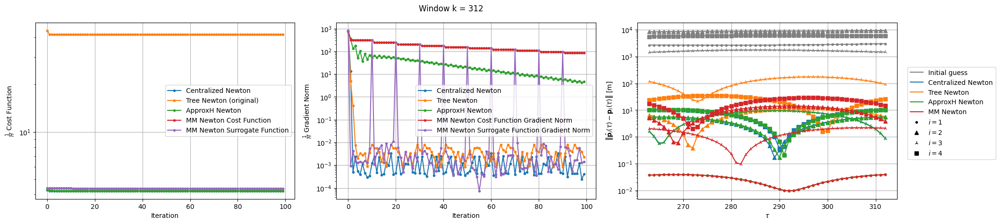


Windows:  76%|███████▋  | 264/346 [12:03:28<3:27:11, 151.60s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 35.39976030803873
Gradient norm: 284.7687749071839
Global relative error: 108.90382390064266
Position relative errors: 0.03804507552636926 m, 5.829250859223142 m, 105.82490269169502 m, 25.04234541061781 m

Before applying the algorithm
Cost function: 4.197333144394247
Gradient norm: 358.7162142958114
Global relative error: 11.56445187378822
Position relative errors: 0.03805155434727512 m, 5.470530084993793 m, 1.0042704369529838 m, 10.139019875680027 m

Before applying the algorithm
L_norm = 4.1974392922722945
Grad_L_norm = 363.1208132178337

Iteration 1
Cost function: 39.25162733314952 (10.88%)
Gradient norm: 13.194458405432007 (-95.37%)
Global relative error: 109.23669109149736 (0.31%)
Position relative errors: 0.040522862857425054 m, 6.671152638004734 m, 105.53704209857483 m,

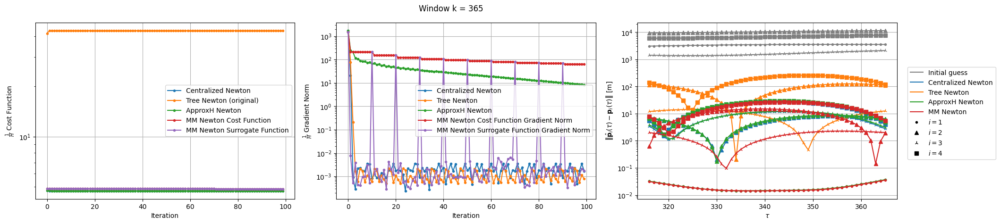


Windows:  92%|█████████▏| 317/346 [14:16:12<1:12:08, 149.26s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.647309294853542
Gradient norm: 1784.3736890240468
Global relative error: 8.749941405241474
Before applying the algorithm
Cost function: 42.722370284719126
Gradient norm: 1598.8978505477385
Global relative error: 170.7805639440291Position relative errors: 0.030042330357505923 m, 6.602318217810132 m, 3.0980966692302547 m, 4.834305585859529 m


Position relative errors: 0.030017123811864103 m, 112.7433696030782 m, 12.462898653161801 m, 127.66965335204674 m

Before applying the algorithm
L_norm = 4.6457004589038124
Grad_L_norm = 1782.20184202706

Iteration 1
Cost function: 52.0710299746607 (21.88%)
Gradient norm: 274.9271627093906 (-82.81%)
Global relative error: 139.0347452056417 (-18.59%)
Position relative errors: 0.033440852106793595 m, 112.74253596339813 m, 14.80354513921388 

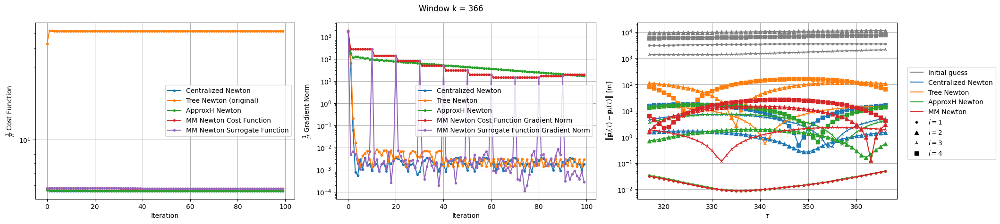


Windows:  92%|█████████▏| 318/346 [14:18:43<1:09:52, 149.71s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 51.77639482283631
Gradient norm: 2790.764359195796
Global relative error: 131.44967691543889Before applying the algorithm
Cost function: 4.619502295796757
Gradient norm: 2451.7553195207825
Global relative error: 14.448062763343977

Position relative errors: 0.030823173563471022 m, 109.31727343466385 m, 14.717982917266518 m, 71.4989486368941 m

Position relative errors: 0.030876033659883978 m, 0.7465886809947325 m, 3.979001956593367 m, 13.869229115978076 m

Before applying the algorithm
L_norm = 4.618333436800232
Grad_L_norm = 2453.9613440385706

Iteration 1
Cost function: 4.6053441881016255 (-0.31%)
Gradient norm: 154.96361432131002 (-93.68%)
Global relative error: 14.138718349278504 (-2.14%)
Position relative errors: 0.04472125363848682 m, 0.41417425089237325 m, 3.239338555950

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



STOP on Iteration 9
Cost function = 4.794859958194608 (0.00%)
Gradient norm = 0.002724654014783036 (216.78%)
Global relative error = 28.830950607794087 (0.00%)
Final position relative errors: 0.08788675540765221 m, 14.39379189403104 m, 1.1008918572345936 m, 24.956415406134255 m



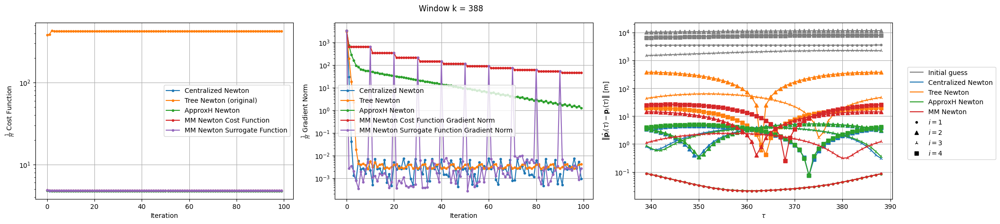


Windows:  98%|█████████▊| 340/346 [15:13:40<14:56, 149.43s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 446.08980734891753
Gradient norm: 1475.980900745671
Global relative error: 380.31027560166063
Before applying the algorithm
Cost function: 4.813479479598474
Gradient norm: 1571.2942655775637
Global relative error: 5.344926847397436Position relative errors: 0.08093427968935865 m, 376.97083647597395 m, 46.34333052708489 m, 19.523840170626144 m


Position relative errors: 0.08093081989029836 m, 3.340942359826596 m, 0.7074457821278327 m, 4.110872058864721 m

Before applying the algorithm
L_norm = 4.813692982048551
Grad_L_norm = 1571.935111080416

Iteration 1
Cost function: 453.655000228815 (1.70%)
Gradient norm: 348.2237643125948 (-76.41%)
Global relative error: 381.3847210480039 (0.28%)
Position relative errors: 0.09270805420758778 m, 376.8845321472465 m, 54.7756143546222 m, 20.29

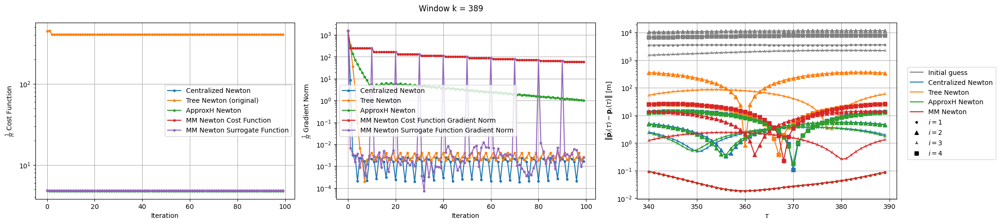


Windows:  99%|█████████▊| 341/346 [15:16:10<12:27, 149.57s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.9629172203038685
Gradient norm: 4788.356556822999
Global relative error: 13.815066984717491
Position relative errors: 0.08500288285439046 m, 4.59418878808563 m, 2.0892330444407663 m, 12.859911774299555 m

Before applying the algorithm
Cost function: 424.65745935343824
Gradient norm: 4620.894769545923
Global relative error: 355.59195079969385
Position relative errors: 0.08499811427294014 m, 349.80594085767314 m, 58.43857305849142 m, 25.81363615137241 m

Before applying the algorithm
L_norm = 4.963578677529655
Grad_L_norm = 4789.351378405151

Iteration 1
Cost function: 4.909348001692933 (-1.08%)
Gradient norm: 527.3718928179684 (-88.99%)
Global relative error: 9.079584499125438 (-34.28%)
Position relative errors: 0.08373251569372829 m, 3.773060123090624 m, 1.6636553280979944 m,

In [ ]:
if use_several_cpus and use_causal:
    # DISTRIBUTED OVER SEVERAL CPUs AND CAUSAL
    
    # Initialize storage arrays for state estimates
    X_est_unkkt_history = np.zeros((24, 1, K))  # Centralized Newton
    X_est_tree_newton_history = np.zeros((24, 1, K))  # Tree Newton
    X_est_approx_newton_history = np.zeros((24, 1, K))  # ApproxH Newton
    X_est_mm_history = np.zeros((24, 1, K))  # MM Newton
    
    def solve_algorithm(algorithm_name, algorithm, X_est, dt, Y, X_true, n):
        """
        Solves the estimation problem for a given algorithm.
        Returns the algorithm name, updated X_est, and cost function/gradient data for plotting.
        """
        print(f"-------- {algorithm_name} --------")
        
        if algorithm_name == "Centralized Newton":
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n - W + 1 : n + 1])
            final_errors = [
                np.linalg.norm(X_true[:3, :, n - W + 1] - X_est[:3]),
                np.linalg.norm(X_true[6:9, :, n - W + 1] - X_est[6:9]),
                np.linalg.norm(X_true[12:15, :, n - W + 1] - X_est[12:15]),
                np.linalg.norm(X_true[18:21, :, n - W + 1] - X_est[18:21])
            ]
            print(f"Final position relative errors: {final_errors} m")
        
        elif algorithm_name in ["Tree Newton", "ApproxH Newton", "MM Newton"]:
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])
    
        # Collect cost function and gradient norm data
        return (
            algorithm_name,
            X_est,
            algorithm.cost_function_values.copy(),
            algorithm.grad_norm_values.copy(),
            algorithm.surrogate_function_values.copy() if hasattr(algorithm, "surrogate_function_values") else [],
            algorithm.surrogate_grad_norm_values.copy() if hasattr(algorithm, "surrogate_grad_norm_values") else []
        )
    
    # ================= MAIN EXECUTION =================
    for m in tqdm(range(M), desc="MC runs", leave=True):
        # Generate observations
        Y = np.zeros((9, 1, T))
        for t in range(T):
            Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.multivariate_normal(np.zeros(9), R).reshape((9, 1))
    
        # Initialize state estimates
        X_est_unkkt = X_initial + initial_dev
        X_est_tree_newton = X_initial + initial_dev
        X_est_approx_newton = X_initial + initial_dev
        X_est_mm = X_initial + initial_dev
    
        for n in tqdm(range(W - 1, K), desc="Windows", leave=False):
            with ProcessPoolExecutor(max_workers=4) as executor:
                # Run each algorithm in parallel
                future_to_algorithm = {
                    executor.submit(solve_algorithm, "Centralized Newton", unkkt, X_est_unkkt, dt, Y, X_true, n): "Centralized Newton",
                    executor.submit(solve_algorithm, "Tree Newton", tree_newton, X_est_tree_newton, dt, Y, X_true, n): "Tree Newton",
                    executor.submit(solve_algorithm, "ApproxH Newton", approxh_newton, X_est_approx_newton, dt, Y, X_true, n): "ApproxH Newton",
                    executor.submit(solve_algorithm, "MM Newton", mm_newton, X_est_mm, dt, Y, X_true, n): "MM Newton"
                }
    
                # Retrieve results in the main process
                results = {future.result()[0]: future.result()[1:] for future in future_to_algorithm}
    
            # Extract updated estimates
            X_est_unkkt, cost_unkkt, grad_unkkt, _, _ = results["Centralized Newton"]
            X_est_tree_newton, cost_tree, grad_tree, _, _ = results["Tree Newton"]
            X_est_approx_newton, cost_approx, grad_approx, _, _ = results["ApproxH Newton"]
            X_est_mm, cost_mm, grad_mm, surrogate_cost_mm, surrogate_grad_mm = results["MM Newton"]
            
            # Propagate the estimated initial conditions until the end of the finite-horizon window
            if n == W - 1:
                X_est_unkkt_history[:, :, 0] = X_est_unkkt
                X_est_tree_newton_history[:, :, 0] = X_est_tree_newton
                X_est_approx_newton_history[:, :, 0] = X_est_approx_newton
                X_est_mm_history[:, :, 0] = X_est_mm
                for tau in range(W - 1):
                    X_est_unkkt_history[:, :, tau + 1] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_history[:, :, tau])
                    X_est_tree_newton_history[:, :, tau + 1] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_history[:, :, tau])
                    X_est_approx_newton_history[:, :, tau + 1] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_history[:, :, tau])
                    X_est_mm_history[:, :, tau + 1] = mm_newton.dynamic_model.x_new(dt, X_est_mm_history[:, :, tau])
            else:
                X_est_unkkt_history[:, :, n] = X_est_unkkt
                X_est_tree_newton_history[:, :, n] = X_est_tree_newton
                X_est_approx_newton_history[:, :, n] = X_est_approx_newton
                X_est_mm_history[:, :, n] = X_est_mm
                for tau in range(W - 1):
                    X_est_unkkt_history[:, :, n] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_history[:, :, n])
                    X_est_tree_newton_history[:, :, n] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_history[:, :, n])
                    X_est_approx_newton_history[:, :, n] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_history[:, :, n])
                    X_est_mm_history[:, :, n] = mm_newton.dynamic_model.x_new(dt, X_est_mm_history[:, :, n])
                
            # Plot results **in the main process**
            fig, axs = plt.subplots(1, 3, figsize=(3 * 6.4, 4.8))
    
            # Cost function values
            axs[0].plot(cost_unkkt, '.-', label='Centralized Newton')
            axs[0].plot(cost_tree, '.-', label='Tree Newton (original)')
            axs[0].plot(cost_approx, '.-', label='ApproxH Newton')
            axs[0].plot(cost_mm, '.-', label='MM Newton Cost Function')
            axs[0].plot(surrogate_cost_mm, '.-', label='MM Newton Surrogate Function')
            axs[0].set_xlabel('Iteration')
            axs[0].set_ylabel(r'$\frac{1}{H}$ Cost Function')
            axs[0].set_yscale('log')
            axs[0].grid(True)
            axs[0].legend()
    
            # Gradient norm values
            axs[1].plot(grad_unkkt, '.-', label='Centralized Newton')
            axs[1].plot(grad_tree, '.-', label='Tree Newton')
            axs[1].plot(grad_approx, '.-', label='ApproxH Newton')
            axs[1].plot(grad_mm, '.-', label='MM Newton Cost Function Gradient Norm')
            axs[1].plot(surrogate_grad_mm, '.-', label='MM Newton Surrogate Function Gradient Norm')
            axs[1].set_xlabel('Iteration')
            axs[1].set_ylabel(r'$\frac{1}{H}$ Gradient Norm')
            axs[1].set_yscale('log')
            axs[1].grid(True)
            axs[1].legend()

            # Initialize storage for current estimates
            X_est_unkkt_current = np.zeros((24, 1, W))
            X_est_tree_newton_current = np.zeros((24, 1, W))
            X_est_approx_newton_current = np.zeros((24, 1, W))
            X_est_mm_current = np.zeros((24, 1, W))
            
            # Simulate forward propagation over the window
            X_est_unkkt_current[:, :, 0] = X_est_unkkt
            X_est_tree_newton_current[:, :, 0] = X_est_tree_newton
            X_est_approx_newton_current[:, :, 0] = X_est_approx_newton
            X_est_mm_current[:, :, 0] = X_est_mm
            
            for tau in range(W - 1):
                X_est_unkkt_current[:, :, tau + 1] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_current[:, :, tau])
                X_est_tree_newton_current[:, :, tau + 1] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_current[:, :, tau])
                X_est_approx_newton_current[:, :, tau + 1] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_current[:, :, tau])
                X_est_mm_current[:, :, tau + 1] = mm_newton.dynamic_model.x_new(dt, X_est_mm_current[:, :, tau])
            
            # Compute position estimation errors
            dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current = position_estimation_error(X_est_unkkt_current, X_true[:, :, n - W + 1 : n + 1])
            dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current = position_estimation_error(X_est_tree_newton_current, X_true[:, :, n - W + 1 : n + 1])
            dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current = position_estimation_error(X_est_approx_newton_current, X_true[:, :, n - W + 1 : n + 1])
            dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current = position_estimation_error(X_est_mm_current, X_true[:, :, n - W + 1 : n + 1])
            
            # Define colors for algorithms
            algorithm_colors = {
                'Initial guess': 'grey',
                'Centralized Newton': 'C0',
                'Tree Newton': 'C1',
                'ApproxH Newton': 'C2',
                'MM Newton': 'C3'
            }
            
            # Define markers for different agents (i = 1, ..., 4)
            markers = ['.', '^', '2', 's', 'P']
            
            # Plot Initial Guess deviations (use the same color for all i)
            for i, dev_initial in enumerate([dev_chief_initial, dev_deputy1_initial, dev_deputy2_initial, dev_deputy3_initial]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_initial[n - W + 1 : n + 1], linestyle='-', color=algorithm_colors['Initial guess'], marker=markers[i])
            
            # Plot Centralized Newton deviations
            for i, dev_unkkt in enumerate([dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_unkkt, linestyle='-', color=algorithm_colors['Centralized Newton'], marker=markers[i])
            
            # Plot Tree Newton deviations
            for i, dev_tree in enumerate([dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_tree, linestyle='-', color=algorithm_colors['Tree Newton'], marker=markers[i])
            
            # Plot ApproxH Newton deviations
            for i, dev_approxh in enumerate([dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_approxh, linestyle='-', color=algorithm_colors['ApproxH Newton'], marker=markers[i])
            
            # Plot MM Newton deviations
            for i, dev_mm in enumerate([dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_mm, linestyle='-', color=algorithm_colors['MM Newton'], marker=markers[i])
            
            # Set axis labels and scale
            axs[2].set_xlabel(r'$\tau$')
            axs[2].set_ylabel(r'$\left\|\hat{\mathbf{p}}_i(\tau) - \mathbf{p}_i(\tau)\right\|$ [m]')
            axs[2].set_yscale('log')
            axs[2].grid(True)
            
            # Create legend (Colors for Algorithms, Markers for Agents)
            legend_elements = [
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Initial guess'], label='Initial guess'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Centralized Newton'], label='Centralized Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Tree Newton'], label='Tree Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['ApproxH Newton'], label='ApproxH Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['MM Newton'], label='MM Newton'),
                Line2D([0], [0], linestyle='', marker='.', color='black', label='$i = 1$'),
                Line2D([0], [0], linestyle='', marker='^', color='black', label='$i = 2$'),
                Line2D([0], [0], linestyle='', marker='2', color='black', label='$i = 3$'),
                Line2D([0], [0], linestyle='', marker='s', color='black', label='$i = 4$')
            ]
            fig.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))
    
            fig.suptitle(f'Window k = {n}')
            plt.tight_layout() 
            plt.show()
    
            # Update state estimates
            X_est_unkkt = unkkt.dynamic_model.x_new(dt, X_est_unkkt)
            X_est_tree_newton = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton)
            X_est_approx_newton = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton)
            X_est_mm = mm_newton.dynamic_model.x_new(dt, X_est_mm)

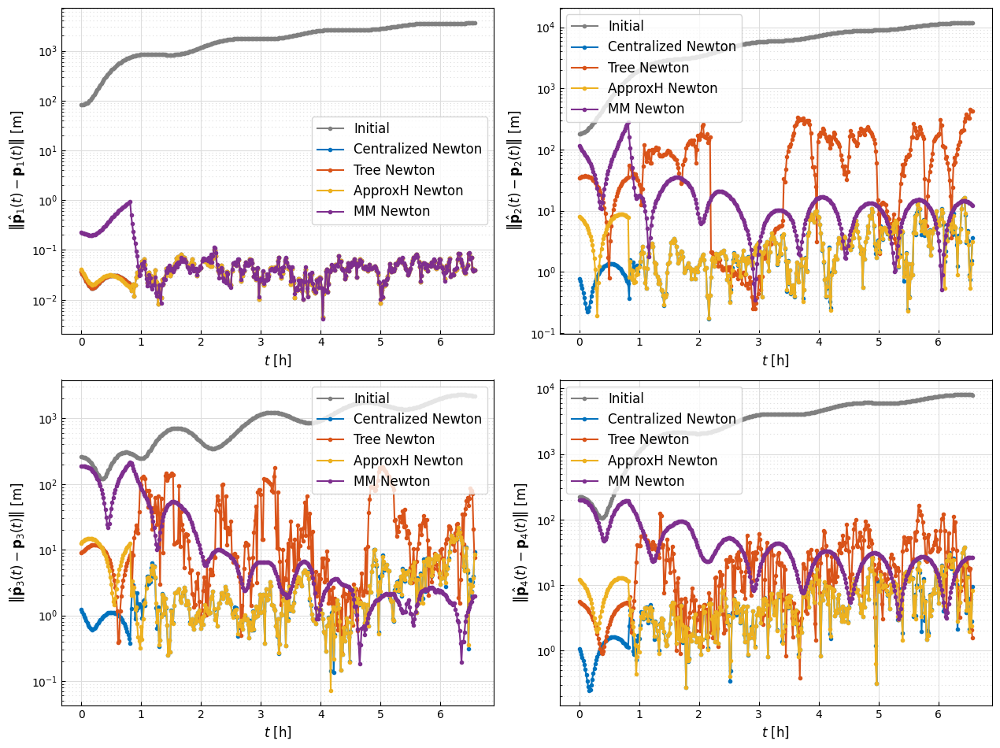

In [15]:
# Extract deviations for Chief and Deputies
dev_chief_unkkt, dev_deputy1_unkkt, dev_deputy2_unkkt, dev_deputy3_unkkt = position_estimation_error(X_est_unkkt_history, X_true)
dev_chief_tree, dev_deputy1_tree, dev_deputy2_tree, dev_deputy3_tree = position_estimation_error(X_est_tree_newton_history, X_true)
dev_chief_approx, dev_deputy1_approx, dev_deputy2_approx, dev_deputy3_approx = position_estimation_error(X_est_approx_newton_history, X_true)
dev_chief_mm, dev_deputy1_mm, dev_deputy2_mm, dev_deputy3_mm = position_estimation_error(X_est_mm_history, X_true)

# Time array
T = X_true.shape[2]

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", color='grey', label="Initial")
axs[0, 0].plot(time, dev_chief_unkkt, ".-", color='C0', label="Centralized Newton")
axs[0, 0].plot(time, dev_chief_tree, ".-", color='C1', label="Tree Newton")
axs[0, 0].plot(time, dev_chief_approx, ".-", color='C2', label="ApproxH Newton")
axs[0, 0].plot(time, dev_chief_mm, ".-", color='C3', label="MM Newton")
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_1(t) - \\mathbf{p}_1(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", color='grey', label="Initial")
axs[0, 1].plot(time, dev_deputy1_unkkt, ".-", color='C0', label="Centralized Newton")
axs[0, 1].plot(time, dev_deputy1_tree, ".-", color='C1', label="Tree Newton")
axs[0, 1].plot(time, dev_deputy1_approx, ".-", color='C2', label="ApproxH Newton")
axs[0, 1].plot(time, dev_deputy1_mm, ".-", color='C3', label="MM Newton")
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_2(t) - \\mathbf{p}_2(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", color='grey', label="Initial")
axs[1, 0].plot(time, dev_deputy2_unkkt, ".-", color='C0', label="Centralized Newton")
axs[1, 0].plot(time, dev_deputy2_tree, ".-", color='C1', label="Tree Newton")
axs[1, 0].plot(time, dev_deputy2_approx, ".-", color='C2', label="ApproxH Newton")
axs[1, 0].plot(time, dev_deputy2_mm, ".-", color='C3', label="MM Newton")
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_3(t) - \\mathbf{p}_3(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", color='grey', label="Initial")
axs[1, 1].plot(time, dev_deputy3_unkkt, ".-", color='C0', label="Centralized Newton")
axs[1, 1].plot(time, dev_deputy3_tree, ".-", color='C1', label="Tree Newton")
axs[1, 1].plot(time, dev_deputy3_approx, ".-", color='C2', label="ApproxH Newton")
axs[1, 1].plot(time, dev_deputy3_mm, ".-", color='C3', label="MM Newton")
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_4(t) - \\mathbf{p}_4(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)

plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [ ]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_unkkt_history
with open(
    f'centralized_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_tree_newton_history
with open(
    f'tree_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_approx_newton_history
with open(
    f'approxh_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_mm_history
with open(
    f'mm_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)